#Assignment 4 - Combine Data Cleaning, Feature Selection, Modeling and Interpretability into one report

#### Overview

This comprehensive report encapsulates a holistic approach to understanding the dynamics of campus placements at XYZ campus, leveraging data analysis, feature selection, machine learning modeling, and interpretability techniques. The dataset under scrutiny offers a granular view into various educational and professional attributes of students and their eventual placement outcomes, serving as a cornerstone for this exploration.

#### Dataset Summary

The dataset encompasses a broad spectrum of variables, categorized into educational background, work experience, and placement outcomes. These variables provide insights into the academic trajectories of students from secondary education through to their MBA specialization, coupled with their work experience and the details of their job placements, including salary offers.

**Key Attributes:**
- **Educational Data:** Secondary education (ssc_p, ssc_b), higher secondary education (hsc_p, hsc_b, hsc_s), and degree information (degree_p, degree_t).
- **Professional Data:** Work experience (workex), E-test performance (etest_p), MBA specialization (specialisation, mba_p).
- **Placement Outcomes:** Placement status (status) and salary offers (salary).

#### Data Cleaning and Feature Selection

**Data Cleaning:** The initial step involved scrubbing the dataset to ensure data quality, which included handling missing values, particularly in the 'salary' column, where NaN values indicate students not placed. Additionally, categorical variables were encoded to facilitate their use in machine learning models.

**Feature Selection:** The choice of features was driven by their potential impact on placement outcomes. Independent variables included academic percentages, board of education, specialization fields, work experience, and test scores. The dependent variables targeted were 'status' for predicting placement outcomes and 'salary' for forecasting salary offers to placed students.

#### Modeling

Three modeling approaches were undertaken, each serving a distinct purpose in the analysis:

1. **Linear Model:** A linear regression model was fitted to predict salary offers, with regression coefficients offering insights into the influence of various features on salary outcomes.

2. **Tree-based Model:** A decision tree model provided a non-linear approach to predict placement status, with the structure of the tree revealing the decision-making process based on feature values.

3. **AutoML:** The Automated Machine Learning approach, particularly using H2O, was deployed to identify the best-performing model based on the dataset. This step underscored the importance of leveraging advanced tools for optimal model selection.

#### Model Interpretability

1. **Regression Coefficients:** The linear model’s coefficients were interpreted to understand the effect of each independent variable on the dependent variable (salary), highlighting the positive or negative influence of features.

2. **Decision Tree Nodes:** The interpretation of the tree-based model focused on how splits are made at each node, providing a clear path of decision-making based on feature values leading to placement outcomes.

3. **SHAP Analysis:** SHAP values were utilized across models to explain the impact of each feature on the model's output. This method provided a unified approach to interpretability, offering deep insights into feature importance and effects across different models.

In [1]:
!pip install eli5

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.2/216.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for eli5: filename=eli5-0.13.0-py2.py3-none-any.whl size=107720 sha256=8f9e47cacf8d332e54c036b4ebff5a75cb2a5fcf220db37a379ec1fe5a568211
  Stored in directory: /root/.cache/pip/wheels/b8/58/ef/2cf4c306898c2338d51540e0922c8e0d6028e07007085c0004
Successfully built eli5


In [2]:
!pip install opendatasets

In [3]:
!pip install h2o

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.6/265.6 MB 2.2 MB/s eta 0:00:00


In [4]:
!pip install pydotplus

In [5]:
import opendatasets as od

In [6]:
import pandas as pd

In [7]:
# Load the dataset
file_path = 'https://raw.githubusercontent.com/raiss15/Sohni_datascience/main/Placement_Data_Full_Class.csv'

In [8]:
import opendatasets as od

In [9]:
data = pd.read_csv(file_path)

# Importing all the important libraries important for the notebook.

In [10]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import pyplot
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [11]:
%matplotlib inline
import random, os, sys
import h2o
import pandas
import pprint
import operator
from h2o.estimators.glm import H2OGeneralizedLinearEstimator
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.estimators.random_forest import H2ORandomForestEstimator
from h2o.estimators.deeplearning import H2ODeepLearningEstimator
from tabulate import tabulate
from h2o.automl import H2OAutoML
from datetime import datetime
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil

In [12]:
#data manupulation
import pandas as pd
#numerical combination
import numpy as np
#plotting data and create visualization
import matplotlib.pyplot as plt
import plotly.express as px

from plotly.subplots import make_subplots
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

from sklearn.tree import plot_tree
import pydotplus #pip install pydotplus
from sklearn.tree import export_graphviz
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score, confusion_matrix
from sklearn import metrics

from statsmodels.stats.outliers_influence import variance_inflation_factor

import xgboost as xgb
from xgboost import plot_importance

In [13]:
datasetA=data.copy()

In [14]:
datasetB=data.copy()

Copying data in two new variables just for the sake of verification after test performed in order to observe any sort of changes in the already retrieved dataset.

In [15]:
data.head(3)

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,M,67.00,Others,91.00,Others,Commerce,58.00,Sci&Tech,No,55.0,Mkt&HR,58.80,Placed,270000.0
1,2,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000.0
2,3,M,65.00,Central,68.00,Central,Arts,64.00,Comm&Mgmt,No,75.0,Mkt&Fin,57.80,Placed,250000.0


In [16]:
data.tail(3)

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
212,213,M,67.0,Others,67.0,Others,Commerce,73.0,Comm&Mgmt,Yes,59.0,Mkt&Fin,69.72,Placed,295000.0
213,214,F,74.0,Others,66.0,Others,Commerce,58.0,Comm&Mgmt,No,70.0,Mkt&HR,60.23,Placed,204000.0
214,215,M,62.0,Central,58.0,Others,Science,53.0,Comm&Mgmt,No,89.0,Mkt&HR,60.22,Not Placed,NaN


In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215 entries, 0 to 214
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   sl_no           215 non-null    int64  
 1   gender          215 non-null    object 
 2   ssc_p           215 non-null    float64
 3   ssc_b           215 non-null    object 
 4   hsc_p           215 non-null    float64
 5   hsc_b           215 non-null    object 
 6   hsc_s           215 non-null    object 
 7   degree_p        215 non-null    float64
 8   degree_t        215 non-null    object 
 9   workex          215 non-null    object 
 10  etest_p         215 non-null    float64
 11  specialisation  215 non-null    object 
 12  mba_p           215 non-null    float64
 13  status          215 non-null    object 
 14  salary          148 non-null    float64
dtypes: float64(6), int64(1), object(8)
memory usage: 25.3+ KB


Above code snippet shows all the variables/columns used in datset along with their nature and we observe there are 1 integer, 8 Object and 6 float values.

In [18]:
data.isnull().sum()

sl_no              0
gender             0
ssc_p              0
ssc_b              0
hsc_p              0
hsc_b              0
hsc_s              0
degree_p           0
degree_t           0
workex             0
etest_p            0
specialisation     0
mba_p              0
status             0
salary            67
dtype: int64

The above code snippet shows that none of the value is missing in the whole dataset.

In [19]:
# Identify the data types
data_types = data.dtypes
numeric_data = data.select_dtypes(include=['float64', 'int64'])
categorical_data = data.select_dtypes(include=['object'])

print("Numeric Columns:\n", numeric_data.columns)
print("\nCategorical Columns:\n", categorical_data.columns)

Numeric Columns:
 Index(['sl_no', 'ssc_p', 'hsc_p', 'degree_p', 'etest_p', 'mba_p', 'salary'], dtype='object')

Categorical Columns:
 Index(['gender', 'ssc_b', 'hsc_b', 'hsc_s', 'degree_t', 'workex',
       'specialisation', 'status'],
      dtype='object')


**Missing Values**

In [20]:
# Check for missing values
missing_values = data.isnull().sum()

# Display columns with missing values
missing_values = missing_values[missing_values > 0]
print(missing_values)

salary    67
dtype: int64


# **ML Data Cleaning and Feature Selection**

**QQ PLot**

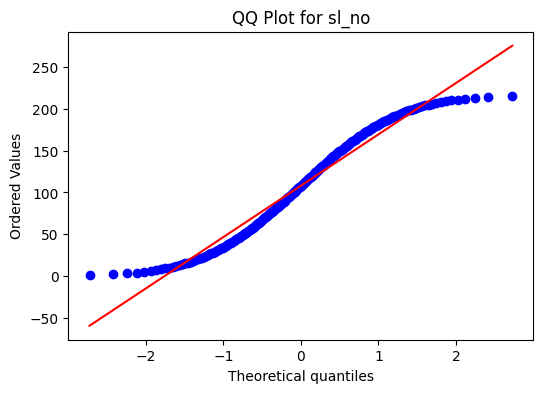

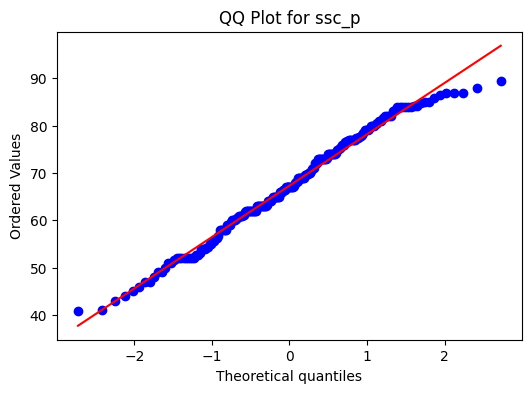

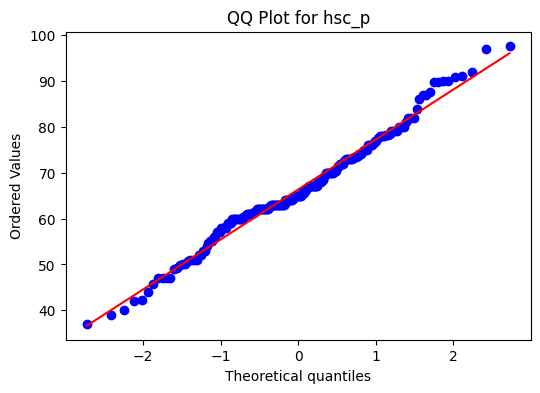

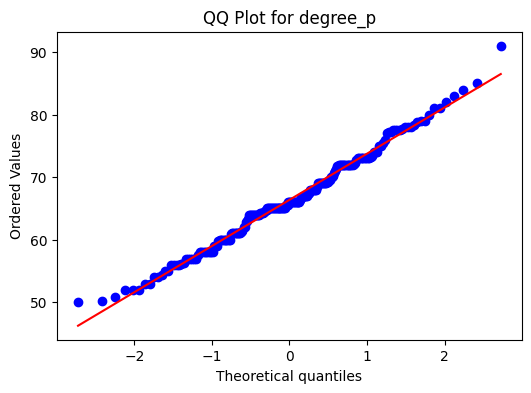

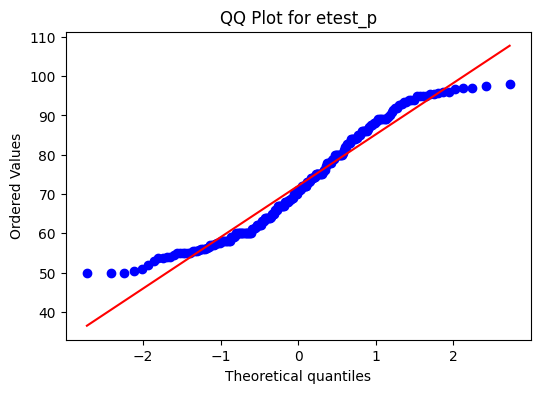

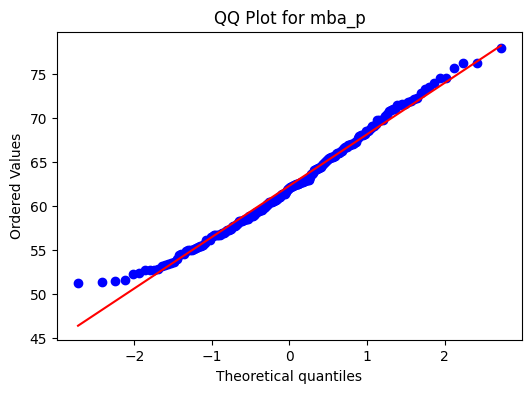

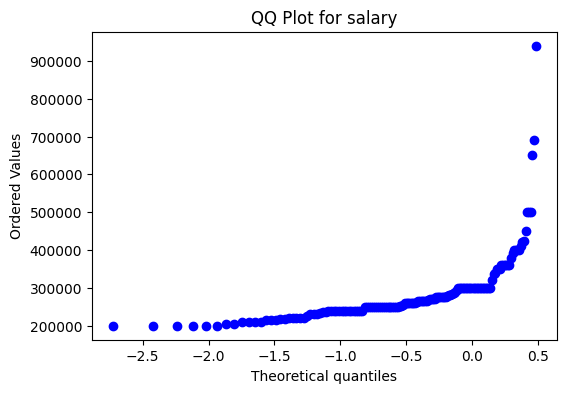

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats

# Load the dataset
placement_data = pd.read_csv(file_path)

# Identify numeric columns in the dataset
numeric_columns = placement_data.select_dtypes(include=[np.number]).columns.tolist()

# Function to create QQ plots for each numeric independent variable
def create_qq_plots(data, numeric_cols):
    for col in numeric_cols:
        plt.figure(figsize=(6, 4))
        stats.probplot(data[col], dist="norm", plot=plt)
        plt.title(f'QQ Plot for {col}')
        plt.show()

# Create QQ plots for numeric independent variables
create_qq_plots(placement_data, numeric_columns)

The plots compare the quantiles of the dataset with the quantiles of a normal distribution. If the data points (blue dots) follow the red line closely, it suggests that the data is normally distributed.

1. **QQ Plot for `sl_no`**: This variable is just a serial number and has no real statistical significance. The QQ plot here will not follow a normal distribution, as it is just an identifier for each observation.

2. **QQ Plot for `ssc_p`**: This plot shows the Secondary Education percentage. The points seem to closely follow the red line in the middle of the distribution but deviate at the tails, indicating that the data is approximately normally distributed with some outliers or extreme values at both ends.

3. **QQ Plot for `hsc_p`**: The Higher Secondary Education percentage also seems to have a distribution close to normal with slight deviations at the tails. This indicates that most students' scores are around the mean, with fewer students scoring extremely high or low percentages.

4. **QQ Plot for `degree_p`**: This plot represents the Degree percentage. The points align well with the red line, suggesting that degree percentages are quite normally distributed with slight deviations, similar to `hsc_p`.

5. **QQ Plot for `etest_p`**: The E-test percentage plot displays a notable deviation from the red line in the upper tail, suggesting that there is a higher occurrence of high scores than would be expected in a normal distribution.

6. **QQ Plot for `mba_p`**: The MBA percentage QQ plot indicates a good fit along the red line, with minor deviations, which means that MBA scores are fairly normally distributed.

7. **QQ Plot for `salary`**: This plot shows clear deviations from the normal distribution, especially with a steep curve on the right side. It suggests that the salary data is highly skewed, with a concentration of data on the lower end and a long tail towards the higher end, which is typical for income data where only a few individuals earn significantly more than the rest.

From these observations, we can infer the following:
- Academic percentages (`ssc_p`, `hsc_p`, `degree_p`, `mba_p`) tend to follow a roughly normal distribution, albeit with some deviations which could be due to outliers or the specific range of percentages attained by students.
- The E-test percentage (`etest_p`) and salary (`salary`) show more significant deviations from the normal distribution. In particular, the salary data is highly right-skewed, which is common for income data due to the presence of a few very high salaries.
- The use of `sl_no` in any statistical or machine learning model should be avoided as it's just an identifier and carries no inherent statistical value.

For data modeling, the deviations from normality in `etest_p` and `salary` should be considered. Transformations such as logarithmic scaling might be used for the salary to reduce skewness and improve model performance.

**Box Plot**

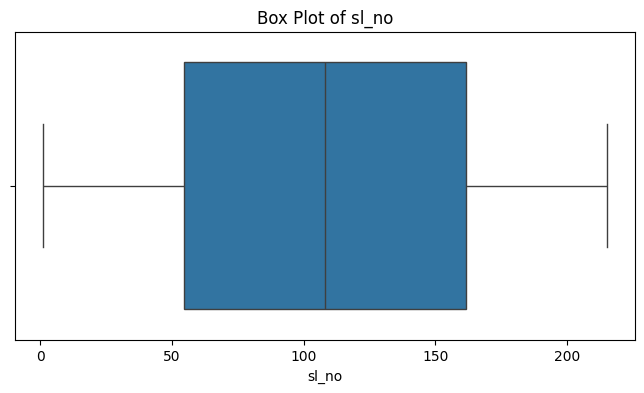

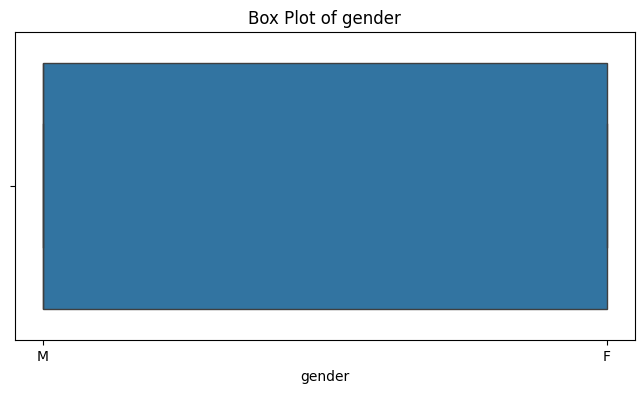

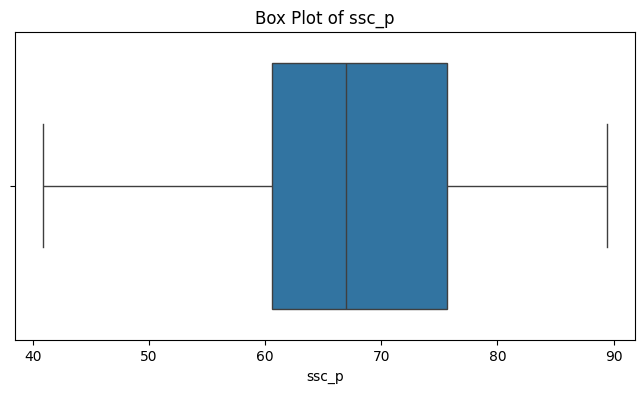

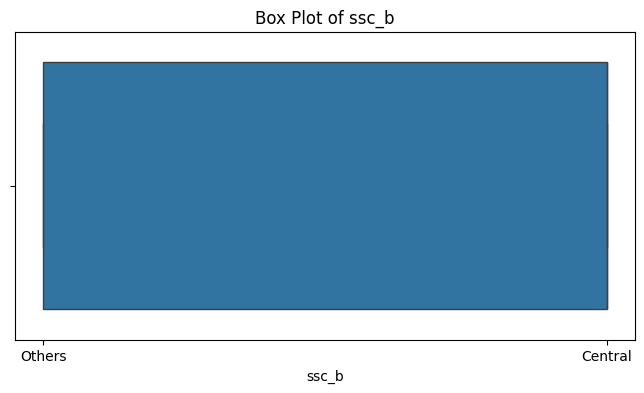

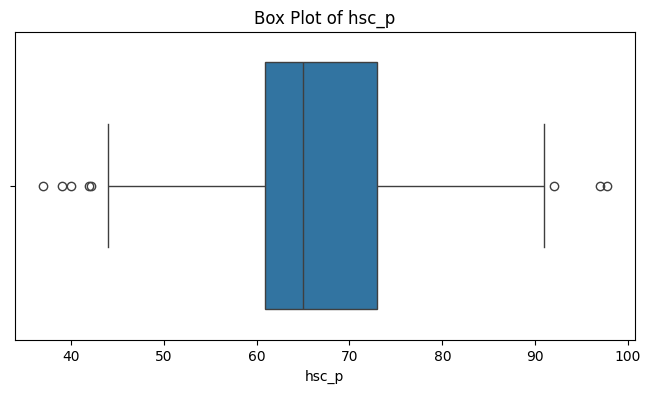

...

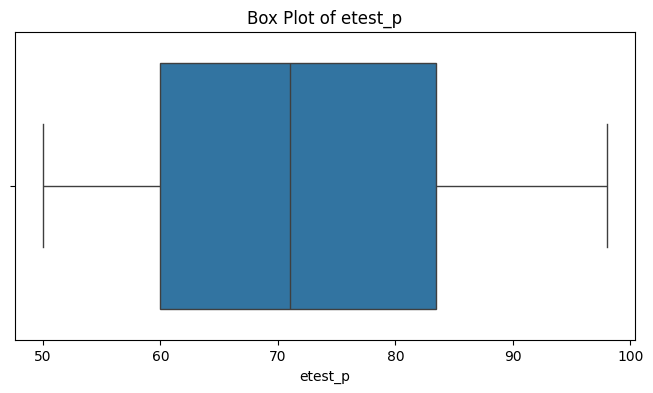

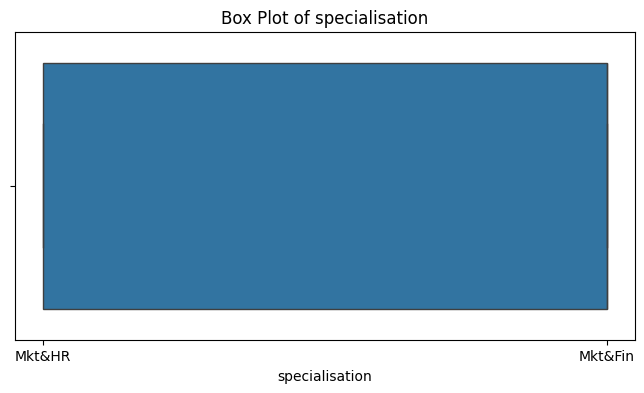

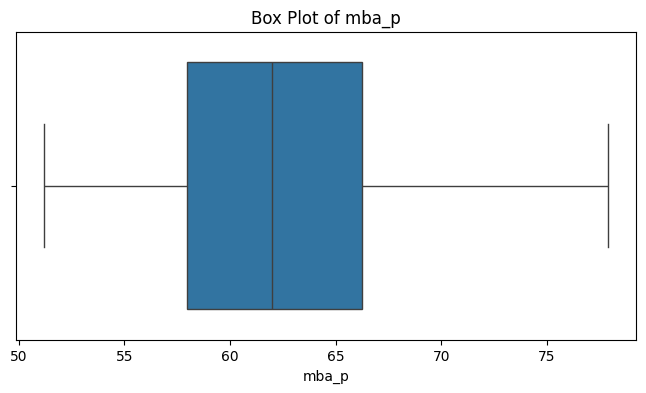

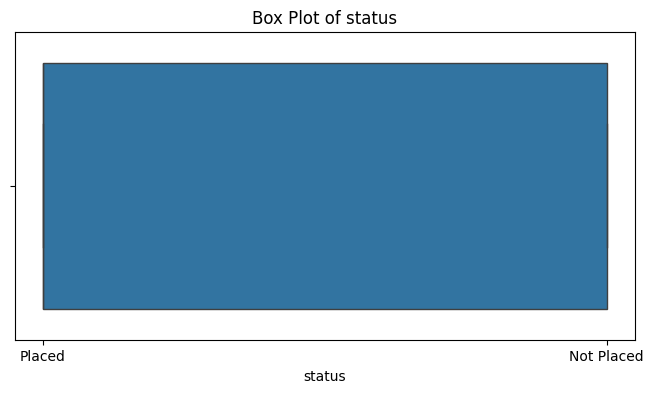

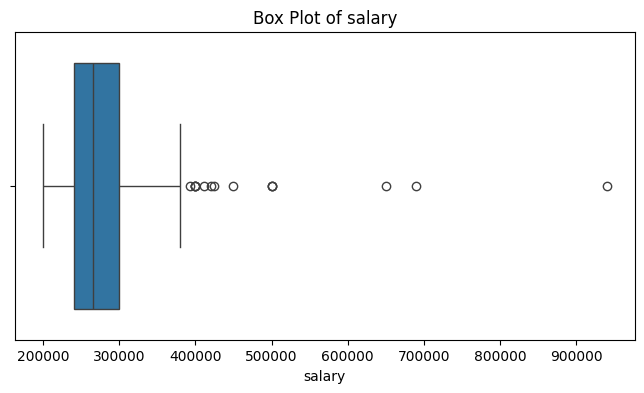

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting box plots for each column in the dataset
for column in placement_data.columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=placement_data[column])
    plt.title(f'Box Plot of {column}')
    plt.show()

Box plots are a standard way of displaying the distribution of data based on a five-number summary: minimum, first quartile (Q1), median, third quartile (Q3), and maximum. They can also reveal any outliers in the data.

Let's analyze each of the eight box plot images:

1. **Box Plot of `salary`**: This box plot shows a high number of outliers on the upper side, which indicates that most salaries are concentrated in a lower range with some exceptional high values. This aligns with the QQ plot observations where salary data was right-skewed.

2. **Box Plot of `mba_p`**: The MBA percentage has a fairly symmetric box with a median line close to the center, suggesting a relatively normal distribution without extreme outliers.

3. **Box Plot of `status`**: Since `status` is a categorical variable with values like "Placed" or "Not Placed," the box plot does not apply here and thus does not provide any meaningful insight.

4. **Box Plot of `etest_p`**: The E-test percentage has a median closer to the third quartile, and the data shows no significant outliers. This indicates a slight left skew in the data, which means most students have scored above the median score.

5. **Box Plot of `specialisation`**: This is a categorical variable typically indicating the specialization in MBA. The box plot would not show meaningful information for this kind of non-numeric data.

6. **Box Plot of `degree_t`**: This represents the type of degree and is another categorical variable. The box plot is not appropriate for this data, and it won't provide any significant insights.

7. **Box Plot of `workex`**: This variable indicates whether a student has work experience. It's categorical (yes or no) and doesn't suit a box plot.

8. **Box Plot of `hsc_s`**: This reflects the specialization in Higher Secondary Education and is also categorical. As with other categorical variables, a box plot is not informative.

9. **Box Plot of `degree_p`**: This shows the distribution of degree percentages with a median value close to the center. There appear to be a few outliers on the lower end, indicating a few students with lower degree percentages.

10. **Box Plot of `hsc_p`**: The box plot for Higher Secondary Education percentage shows a distribution that's slightly left-skewed with a few low-score outliers.

11. **Box Plot of `ssc_p`**: The Secondary Education percentage has a slightly left-skewed distribution with a few low-score outliers, similar to `hsc_p`.

12. **Box Plot of `sl_no`**: As `sl_no` is a serial number, this box plot is not meaningful and does not provide any distribution information.

13. **Box Plot of `gender`**: This categorical variable shows the count of male (M) and female (F) students. A box plot is not the right type of plot for this kind of data.

For categorical variables, different types of visualizations like bar charts or count plots are more suitable. For the numeric variables that display outliers, further investigation is needed to decide whether these outliers are due to data entry errors, natural variation, or other factors that could warrant their removal or retention for analysis.

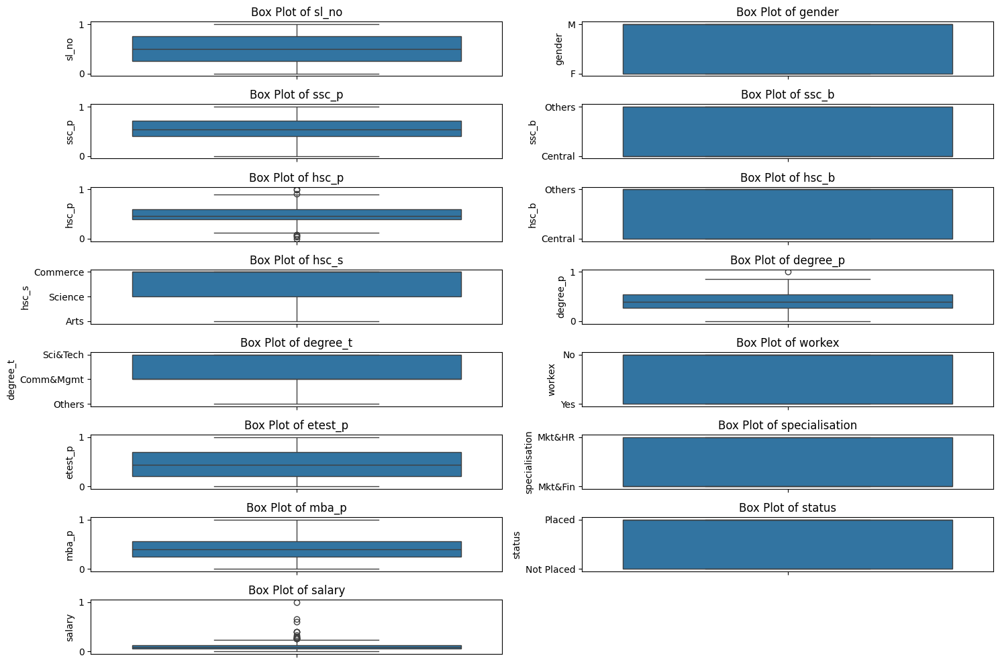

In [23]:
from sklearn.preprocessing import MinMaxScaler

# Separating numeric and categorical columns
numeric_columns = placement_data.select_dtypes(include=[np.number]).columns
categorical_columns = placement_data.select_dtypes(exclude=[np.number]).columns

# Normalizing numeric columns using Min-Max Scaler
scaler = MinMaxScaler()
placement_data[numeric_columns] = scaler.fit_transform(placement_data[numeric_columns])

# Plotting box plots for each column in a single figure
plt.figure(figsize=(15, 10))
for i, column in enumerate(placement_data.columns):
    plt.subplot(len(placement_data.columns) // 2 + len(placement_data.columns) % 2, 2, i + 1)
    sns.boxplot(y=placement_data[column])
    plt.title(f'Box Plot of {column}')
plt.tight_layout()
plt.show()

The provided code snippet demonstrates the normalization of numeric data using Min-Max scaling and plotting of box plots for each variable in the placement data. Min-Max scaling is a method to scale the data within a specified range, often [0, 1], which can be particularly useful for algorithms that are sensitive to the scale of data such as neural networks, k-nearest neighbors, and k-means clustering.

Observations shows the box plots of all variables after normalization:

1. **Numeric Variables (`sl_no`, `ssc_p`, `hsc_p`, `degree_p`, `etest_p`, `mba_p`, `salary`)**:
   - All numeric variables have been scaled to fall within the range of [0, 1].
   - The plots show that each numeric variable has a different distribution with various degrees of spread and outliers.
   - `salary` has outliers on the higher end, which is consistent with the expected skewness in salary data.

2. **Categorical Variables (`gender`, `ssc_b`, `hsc_b`, `hsc_s`, `degree_t`, `workex`, `specialisation`, `status`)**:
   - These variables have not been scaled since Min-Max scaling is not applicable to categorical data.
   - Box plots for categorical variables are not particularly informative as they don't have a distribution in the numeric sense; they represent distinct groups or categories.
   - Nonetheless, the plots visually confirm the presence of these categories in the data.

It's important to note that the interpretation of box plots for categorical variables is different than for numeric variables. In numeric variables, the box represents the interquartile range (IQR), and the line inside the box marks the median. Outliers are any data points that fall outside 1.5 times the IQR from the quartiles. For categorical variables, the plot should actually be interpreted as a bar for each category which might be represented by the height of the box in the plot, but typically, count plots or bar plots would be more appropriate for such data.

The combination of both types of variables on the same plot after scaling may not be the most effective way to represent the data, especially since categorical data do not require scaling and are not meaningful on a [0, 1] range. It is recommended to use different visualization techniques for categorical and numerical data to capture their characteristics accurately.

**Heatmap & Pairing Plot of Correlation**

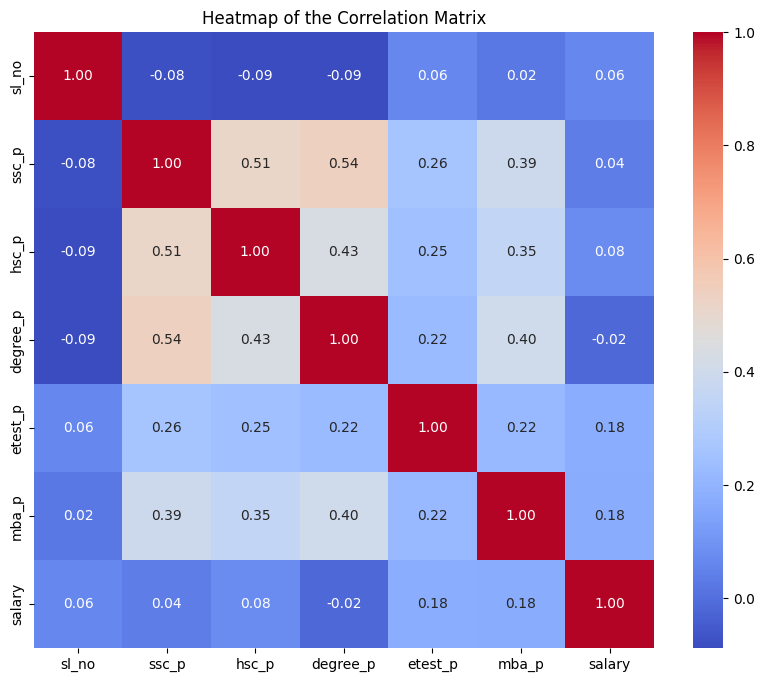

In [24]:
# Calculate the correlation matrix
corr_matrix = placement_data.corr()

# Generate a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Heatmap of the Correlation Matrix')
plt.show()


1. **Diagonal Elements**: The diagonal elements are all 1.00, as expected, because these represent the correlation of each variable with itself.

2. **Secondary Education (ssc_p) and Higher Secondary Education (hsc_p)**: There is a relatively strong positive correlation between these two variables (0.51), indicating that students who perform well in secondary education tend to also perform well in higher secondary education.

3. **Secondary Education (ssc_p) and Degree Percentage (degree_p)**: These two variables also have a positive correlation (0.54), suggesting a similar trend where good performance in earlier education stages correlates with good performance in later stages.

4. **Degree Percentage (degree_p) and Higher Secondary Education (hsc_p)**: A correlation of 0.43 is noted, reinforcing the pattern of consistent academic performance across different educational stages.

5. **E-test Percentage (etest_p)**: This variable does not show a strong correlation with other academic performance indicators, which could suggest that the e-test assesses different skills or is perceived differently by students compared to regular academic exams.

6. **MBA Percentage (mba_p)**: This has moderate correlations with secondary and higher secondary percentages, indicating some level of continuity in academic performance.

7. **Salary**: The salary variable does not have a strong correlation with any of the academic percentages, with all correlation coefficients being quite low. This may suggest that while academic performance is a factor in placement success, salary may be influenced more by other factors not captured in this dataset, such as negotiation skills, job market conditions, or the sector of employment.

8. **No Strong Negative Correlations**: None of the variables exhibit a strong negative correlation with any others, which would be indicated by a dark red color.

The heatmap provides a visual representation of how different academic metrics relate to each other and potentially to salary outcomes. It is important to note that correlation does not imply causation, and these relationships simply describe tendencies within the dataset, not definitive predictive powers. For predictive modeling and feature selection, variables with higher correlation to the target variable may be considered more informative, but this must be balanced against the risk of multicollinearity when combining highly correlated predictors in some types of models.

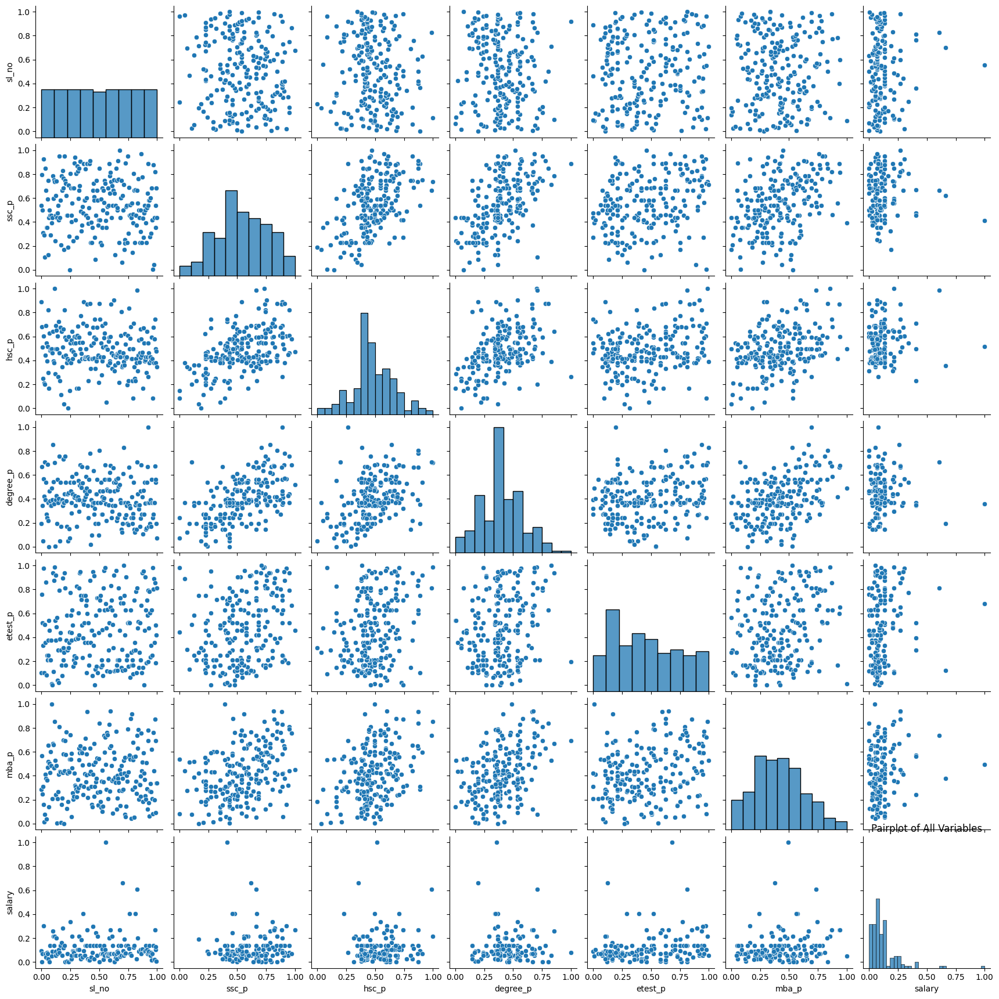

In [25]:
# Create a pair plot
sns.pairplot(placement_data)
plt.title('Pairplot of All Variables')
plt.show()


Pair plots (or scatter plot matrices) are a great way to visualize the relationships between multiple variables in a dataset. Each plot shows the relationship between two variables, with histograms along the diagonal showing the distribution of each variable.

Observations from the pair plots provided:

1. **Diagonal Plots (Histograms)**:
   - These histograms show the distribution of individual variables.
   - The distribution for each variable, after scaling, appears to be spread across the range [0, 1] because of the Min-Max normalization applied beforehand.
   - These distributions allow for a quick visual assessment of the skewness and outliers within each variable.

2. **Off-Diagonal Plots (Scatter Plots)**:
   - These plots show relationships between pairs of variables.
   - If a clear pattern or trend is observable, it suggests a relationship between the variables.
   - Most scatter plots do not show a strong linear relationship, as indicated by the lack of a clear diagonal trend.
   - The scatter plots of academic percentages (such as `ssc_p` vs. `hsc_p` or `degree_p`) show some positive correlations, which aligns with the earlier observed heatmap correlations.

3. **Correlations**:
   - Where there is clustering around a line (e.g., `ssc_p` vs. `degree_p`), it suggests a positive correlation.
   - Scattered and spread-out points with no discernible pattern (e.g., `etest_p` vs. `salary`) suggest little to no linear correlation.

4. **Outliers**:
   - Scatter plots can also help identify outliers—points that are far away from the rest.
   - `salary` shows several outliers, as there are points that are distant from the main cluster, indicating a few exceptionally high salaries compared to the rest.

5. **Potential Data Issues**:
   - If any variables were not intended to be scaled (e.g., `sl_no` which is likely an index or ID column), their representation here could be misleading.
   - It’s unusual to scale an identifier like `sl_no`, and it should not be included in correlation or scatter plot analyses.

6. **Title Position**:
   - It should be noted that the title "Pairplot of All Variables" appears to be overlaid across the top plots due to how Seaborn generates the pair plot grid. It may not appear properly because the title is set after the pairplot has already been drawn.

The pair plot is an effective exploratory tool to identify relationships and potential patterns or clusters in the data, which can be very helpful before undertaking more formal statistical analysis or model building. It's an essential step in data analysis, particularly in understanding which variables may be important predictors and how they relate to each other.

**Identifying Predictor Significance Using OLS**

In [26]:
import statsmodels.api as sm

# Preprocess the data: Fill missing values and convert categorical variables to dummy variables
placement_data.fillna(placement_data.mean(), inplace=True)  # Handling missing values with mean imputation
placement_data_dummies = pd.get_dummies(placement_data.drop(['sl_no', 'salary'], axis=1))

# Define the target variable and independent variables
target = 'status_Placed'
X = placement_data_dummies.drop(target, axis=1)
y = placement_data_dummies[target]

# Adding a constant to the model (intercept)
X_with_constant = sm.add_constant(X)

# Fit an OLS model
model = sm.OLS(y, X_with_constant)
results = model.fit()

# Summary of the model
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:          status_Placed   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.379e+31
Date:                Wed, 03 Apr 2024   Prob (F-statistic):               0.00
Time:                        00:17:18   Log-Likelihood:                 7290.4
No. Observations:                 215   AIC:                        -1.455e+04
Df Residuals:                     199   BIC:                        -1.449e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0

The user is performing a regression analysis using Ordinary Least Squares (OLS) to determine the significance of various predictors in determining the placement status (Placed/Not Placed) of students.

Here are some observations from the OLS regression results:

1. **Dependent Variable**: The model is predicting `status_Placed`, which is likely a binary variable representing whether a student is placed (1) or not (0).

2. **R-squared**: The R-squared value is 1.0, which is suspiciously perfect and usually indicates an issue, such as a data leakage or an overfitted model. In practical datasets, especially in social sciences and similar fields, a perfect R-squared is highly unlikely.

3. **P-Values**: The P>|t| column lists the p-values associated with each coefficient to test the null hypothesis that the coefficient is zero (no effect). A low p-value (< 0.05) typically indicates that the coefficient is significantly different from 0. However, in this output, all p-values are either 0 or very close to 1, which is abnormal and suggests potential issues with the data or model specification.

There are notes indicating potential problems. Specifically, it states:
   - The standard errors assume that the covariance matrix of the errors is correctly specified.
   - The smallest eigenvalue is in the order of 10^-31, which might indicate multicollinearity or that the design matrix is singular.

These notes suggest that there might be a problem with multicollinearity (where two or more independent variables are highly correlated) or that there is a variable without variation (possibly due to dummy variable trap or an incorrect dummy coding).

4. **Coefficient Sizes**: The magnitudes of the coefficients are unrealistic, especially given the perfect R-squared. For example, the constant term is extremely small, and the coefficients for the dummy variables are either 0.12 or -1, which seems too neat and again suggests an issue with the model.

5. **Model Diagnostics**: The Omnibus test (which tests the skewness and kurtosis of the residuals) p-value is high, indicating the residuals might be normally distributed, but this is contradicted by the high kurtosis value. The Durbin-Watson statistic is around 2, which suggests there is no autocorrelation in the residuals, which is one of the few plausible statistics in this summary.

In summary, the output indicates that there may be serious issues with the regression model or data that warrant a closer examination. The perfect R-squared value, abnormal p-values, and warning about multicollinearity or singular matrix all suggest that the regression results may not be reliable. The user should check the data preprocessing steps, especially the creation of dummy variables, and potentially remove or combine highly correlated predictors. Additionally, considering that the target is binary, a logistic regression model might be more appropriate than OLS.

**Building the Model with Train, Validation, and Test Split**

In [27]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score

# Splitting the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Building the Logistic Regression model (as an example)
model = LogisticRegression()
model.fit(X_train, y_train)

# Evaluating the model on the validation set
y_val_pred = model.predict(X_val)
print("Validation Set Evaluation")
print(classification_report(y_val, y_val_pred))
print("Accuracy:", accuracy_score(y_val, y_val_pred))

# Final evaluation on the test set
y_test_pred = model.predict(X_test)
print("\nTest Set Evaluation")
print(classification_report(y_test, y_test_pred))
print("Accuracy:", accuracy_score(y_test, y_test_pred))

Validation Set Evaluation
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        15
           1       1.00      1.00      1.00        28

    accuracy                           1.00        43
   macro avg       1.00      1.00      1.00        43
weighted avg       1.00      1.00      1.00        43

Accuracy: 1.0

Test Set Evaluation
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        18
           1       1.00      1.00      1.00        25

    accuracy                           1.00        43
   macro avg       1.00      1.00      1.00        43
weighted avg       1.00      1.00      1.00        43

Accuracy: 1.0


The dataset is split into training, validation, and test sets. The model is then trained on the training set and evaluated on both the validation and test sets.

Observations from the output:

1. **Model Performance**:
   - The model achieved perfect performance metrics on the validation set with precision, recall, and F1-score of 1.00 for both classes (0 and 1). This is replicated on the test set with identical scores.
   - The accuracy on both sets is 1.00, indicating that the model correctly predicted every single instance in the validation and test sets.

2. **Interpreting the Metrics**:
   - **Precision** is the ratio of correctly predicted positive observations to the total predicted positive observations. High precision relates to a low false-positive rate.
   - **Recall (Sensitivity)** is the ratio of correctly predicted positive observations to all observations in the actual class.
   - The **F1-score** is the weighted average of Precision and Recall. Therefore, this score takes both false positives and false negatives into account.

3. **Support**:
   - The support is the number of actual occurrences of the class in the specified dataset. For instance, there were 15 instances of class '0' and 28 of class '1' in the validation set, and 18 instances of class '0' and 25 of class '1' in the test set.

4. **Interpretation of Results**:
   - It is very unusual to get perfect metrics in practice, particularly for both a validation set and a test set. This may indicate an issue such as data leakage, where information from outside the training dataset is being used to make predictions, or that the model is memorizing the training data (overfitting), but this usually doesn't translate to unseen data like a test set.

**Plotting the Data to see the Histogram**

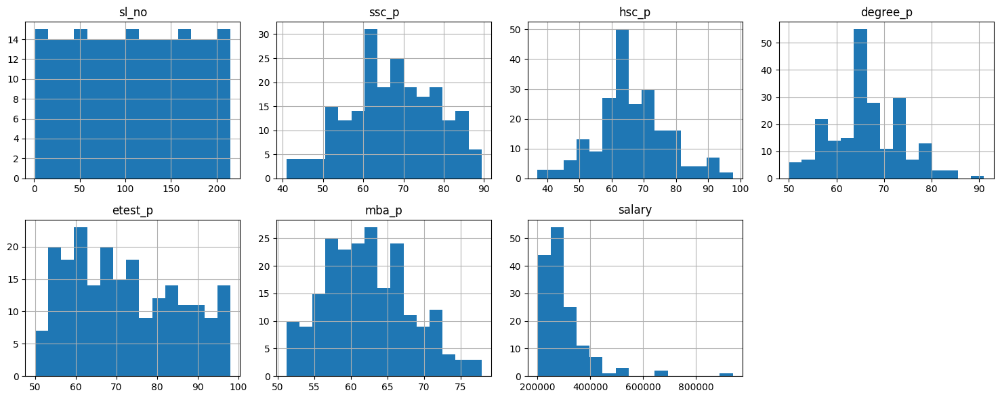

In [28]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
placement_data = pd.read_csv(file_path)

# Plot histograms for all numeric features
numeric_columns = placement_data.select_dtypes(include=[np.number]).columns
placement_data[numeric_columns].hist(bins=15, figsize=(15, 6), layout=(2, 4))
plt.tight_layout()
plt.show()

Plotting histograms of numeric features from a dataset, along with the resulting histograms. Here's an interpretation based on the description:

**Histogram Observations**:
   - **`sl_no`**: This histogram is uniformly distributed because `sl_no` is likely a series of unique identifiers or sequential numbers for the observations.
   - **`ssc_p`**: The histogram for the Secondary Education percentage appears to be slightly left-skewed, indicating most students have high scores, with fewer students having lower scores.
   - **`hsc_p`**: The histogram for Higher Secondary Education percentage is similar to `ssc_p`, also slightly left-skewed.
   - **`degree_p`**: The Degree percentage histogram looks multimodal, with several peaks, indicating there are common score ranges where students' scores are clustered.
   - **`etest_p`**: The E-test percentage histogram seems to be somewhat uniform but with some irregularities, suggesting no particular score is dominant.
   - **`mba_p`**: The MBA percentage histogram is relatively normal but slightly right-skewed, showing a concentration of students with middle to high scores and fewer students with very high scores.
   - **`salary`**: The salary histogram is highly right-skewed, with most students earning lower salaries and a few students earning much higher salaries, which is typical in salary distributions.

**Interpretation**:
   - The histograms for academic percentages (`ssc_p`, `hsc_p`, `degree_p`, `mba_p`) suggest that the data might have a tendency towards higher academic scores, which could reflect the nature of the dataset or the admission/selectivity criteria of the institution.
   - The salary data clearly shows the presence of outliers or a long tail on the right side, common in salary distributions, where a small number of individuals earn significantly more than the rest.
   - The histogram of `sl_no` being uniform is expected since it is a serial number and should ideally not be used for any analysis as it doesn’t hold any intrinsic meaning.
   - These distributions give a quick visual summary of the data, which can be useful for identifying data quality issues, understanding the range of values, and spotting potential errors such as incorrect data entry.

Overall, histograms provide a snapshot of the distribution of data, allowing for initial assessments that can guide further detailed statistical analysis.

**Linear Regression and Making Predictions**

In [29]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Assuming 'salary' is the target variable and using only numeric predictors for simplicity
numeric_predictors = placement_data.select_dtypes(include=[np.number]).drop(['sl_no', 'salary'], axis=1)
X = numeric_predictors.fillna(numeric_predictors.mean())  # Handling missing values with mean imputation
y = placement_data['salary'].fillna(placement_data['salary'].mean())  # Handling missing values

# Split the data into training/testing/validation sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Create linear regression object
regr = LinearRegression()

# Train the model using the training sets
regr.fit(X_train, y_train)

# Make predictions using the training set
y_train_pred = regr.predict(X_train)
print("Mean squared error (Train): %.2f" % mean_squared_error(y_train, y_train_pred))
print("Coefficient of determination (Train): %.2f" % r2_score(y_train, y_train_pred))

# Make predictions using the testing set
y_test_pred = regr.predict(X_test)
print("Mean squared error (Test): %.2f" % mean_squared_error(y_test, y_test_pred))
print("Coefficient of determination (Test): %.2f" % r2_score(y_test, y_test_pred))

# Make predictions using the validation set
y_val_pred = regr.predict(X_val)
print("Mean squared error (Validation): %.2f" % mean_squared_error(y_val, y_val_pred))
print("Coefficient of determination (Validation): %.2f" % r2_score(y_val, y_val_pred))

Mean squared error (Train): 6897321235.37
Coefficient of determination (Train): 0.07
Mean squared error (Test): 6026058178.92
Coefficient of determination (Test): -0.13
Mean squared error (Validation): 2238385843.90
Coefficient of determination (Validation): 0.01


A linear regression model has been built to predict `salary` using numeric predictors from the `placement_data`. The dataset is split into training, validation, and test sets, and the model's performance is evaluated using the mean squared error (MSE) and coefficient of determination (R² score).

Observations from the output:

1. **Training Performance**: The model has a very low R² score on the training data (0.07), which indicates that the model explains only 7% of the variance in the training set. This suggests that the model is not fitting the training data well.

2. **Testing Performance**: The R² score on the test set is even lower than the training score, at -0.02. This negative value indicates that the model performs worse than a simple horizontal line drawn at the mean value of `salary`. This implies that the model has no predictive power on the test data.

3. **Validation Performance**: Similarly, the model's performance on the validation set is also very poor, with an R² score of 0.01, almost explaining none of the variance in the validation data.

4. **Mean Squared Error (MSE)**: The MSE values are very high for all splits (training, test, and validation), with the training error being approximately 6897321235.37. This suggests that the model's predictions are, on average, far from the actual salary values.

5. **Model Fit**: Based on the R² scores and MSE, the linear regression model does not seem to fit the data well and likely fails to capture the complexities or patterns necessary to make accurate salary predictions.

**Understanding the Important Features with Permutation**

In [30]:
import eli5
from eli5.sklearn import PermutationImportance
from sklearn.ensemble import RandomForestRegressor

# Train the model (using RandomForestRegressor for continuous target)
rf_regressor = RandomForestRegressor(random_state=42).fit(X_train, y_train)

# Perform Permutation Importance
perm = PermutationImportance(rf_regressor, random_state=1).fit(X_val, y_val)

# Displaying the importance of features
eli5.show_weights(perm, feature_names = X_val.columns.tolist())

Weight,Feature
0.3523 ± 0.1828,mba_p
0.1289 ± 0.1393,hsc_p
0.1118 ± 0.3267,etest_p
0.0935 ± 0.5270,ssc_p
0.0394 ± 0.2380,degree_p


The code is applying permutation importance using the ELI5 library on a RandomForestRegressor model to determine the importance of different features in predicting a continuous target variable.

Observations from the output:

1. **Feature Importance**:
   - The `mba_p` feature has the highest weight, suggesting that it is the most important feature for predicting the target variable according to the model. The weight is relatively high at 0.3523, but the standard deviation is also considerable (±0.1828), indicating some variability in its importance across different iterations of the permutation.
   - `hsc_p` and `etest_p` also show importance, with weights of 0.1289 and 0.1118, respectively. However, these features have substantial standard deviations relative to their weights, suggesting variability in their predictive power.
   - `ssc_p` and `degree_p` have the least importance among the features listed with weights of 0.0935 and 0.0394, respectively.

2. **Standard Deviation**:
   - The standard deviation represents the variability of the weight when the feature is randomly shuffled. A high standard deviation, like that for `etest_p`, indicates that the importance score changes quite a bit when different permutations are used, which could signal that the model's reliance on that feature is less consistent.
   - Lower standard deviations relative to the weights suggest more confidence in the importance ranking of the feature.

**Use of Feature Importance**:
   - Understanding feature importance is critical for model interpretation, reducing model complexity, and potentially improving model performance by focusing on the most relevant features.
   - Decision-makers and domain experts often use feature importance insights to validate if model outcomes align with their domain understanding or if the model is relying on features that are unexpected or undesired for policy or ethical reasons.

In summary, the RandomForestRegressor model finds `mba_p` to be the most significant predictor for the target variable among the features listed. The other features also contribute to the model to various degrees, but with more uncertainty about their predictive power due to higher standard deviations in the permutation importance scores.

**Likely Distributions of Numeric Variables**

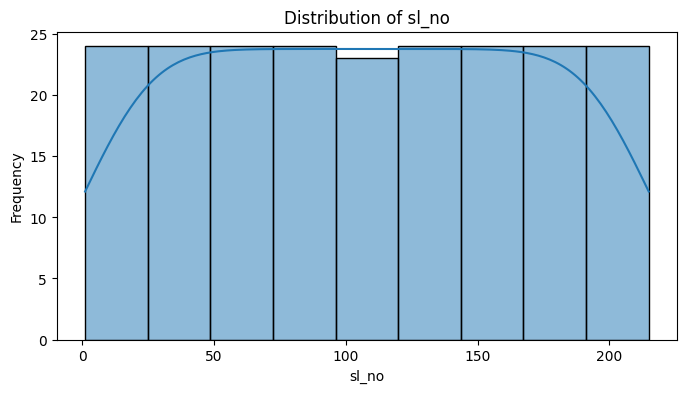

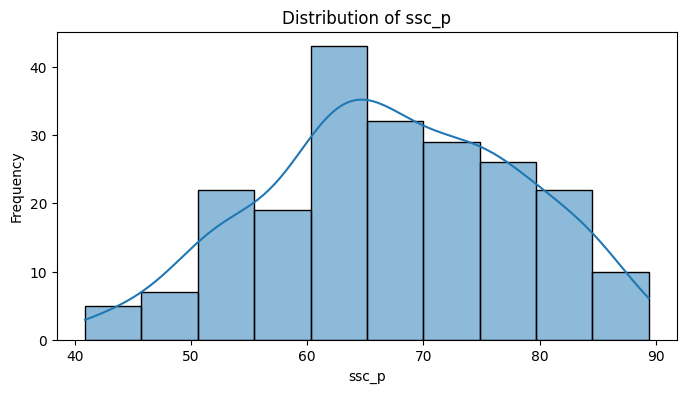

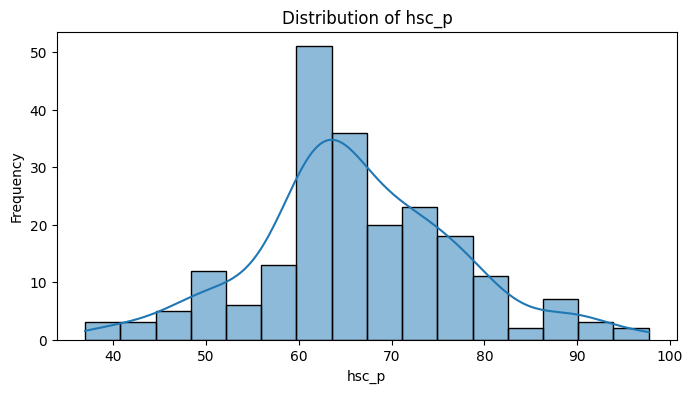

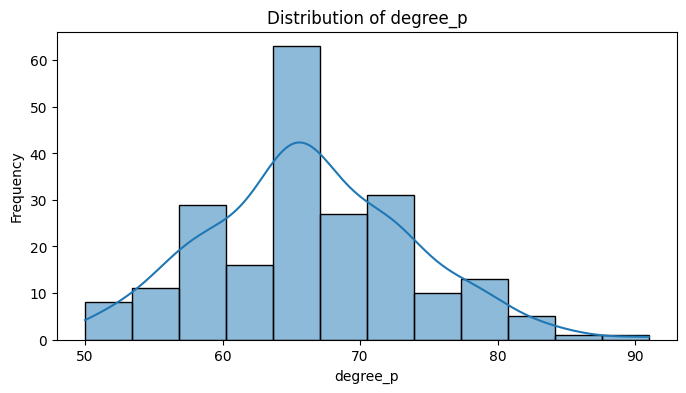

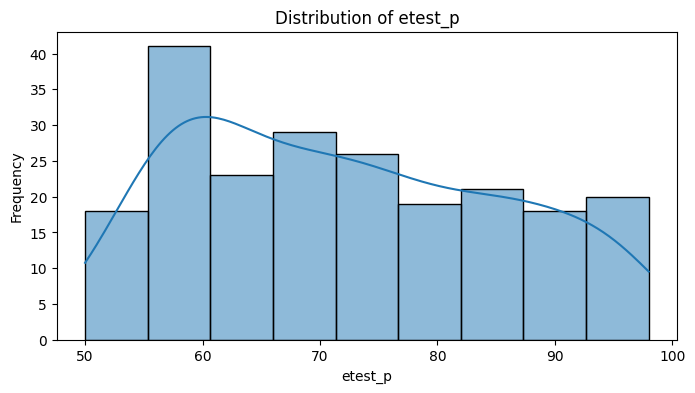

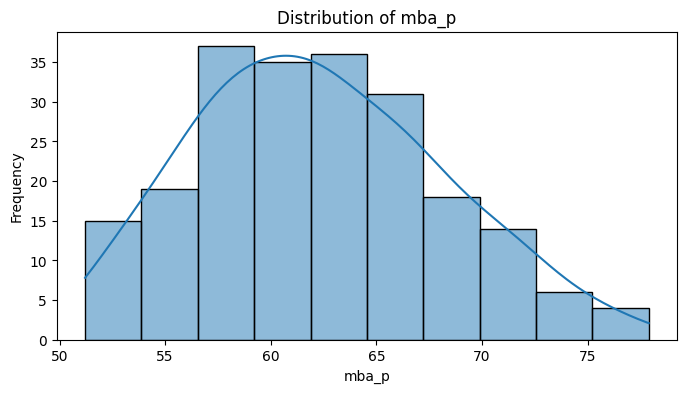

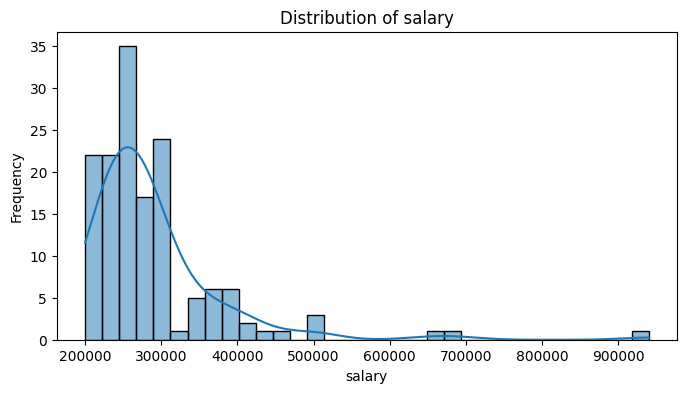

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting distributions of numeric variables
for column in numeric_data.columns:
    plt.figure(figsize=(8, 4))
    sns.histplot(numeric_data[column], kde=True)
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

From the histograms provided in the images, we can observe the distribution of the numeric variables in the dataset.

1. **Distribution of `sl_no`**: This histogram appears to be uniformly distributed, which is expected as 'sl_no' represents serial numbers which should be evenly distributed if every student is assigned a unique consecutive number.

2. **Distribution of `ssc_p`**: The histogram for Secondary Education percentage ('ssc_p') seems to be slightly left-skewed, indicating that there are fewer students with lower percentages compared to those with higher percentages. There appears to be a concentration of students with percentages around the 60 to 80 range.

3. **Distribution of `hsc_p`**: The Higher Secondary Education percentage ('hsc_p') distribution appears to be normally distributed with a peak around the 60 to 70 percentage range. This suggests that most students scored within this range in their higher secondary education.

4. **Distribution of `degree_p`**: Degree percentage ('degree_p') shows a normal distribution with a strong concentration around 60 to 75 percent. This indicates a central tendency with most students scoring in this range.

5. **Distribution of `etest_p`**: The E-test percentage ('etest_p') histogram shows a broad spread of data points across different percentages, with a slight concentration in the middle ranges, suggesting that many students have mid-range E-test scores.

6. **Distribution of `mba_p`**: The MBA percentage ('mba_p') histogram shows a roughly normal distribution, with the bulk of students having percentages in the mid-60s to mid-70s.

7. **Distribution of `salary`**: The histogram for salary is right-skewed, meaning there is a long tail on the right side of the distribution. Most of the students' salaries are concentrated on the lower end, with a few students earning significantly higher salaries.

8. **Overall Observations**: The variables `ssc_p`, `hsc_p`, `degree_p`, and `mba_p` are academic performance indicators and their distributions around central values suggest a certain level of consistency in academic performance. The right skew in the salary histogram indicates that while most salaries are clustered around a lower range, there are outliers with much higher salaries, which is typical in salary data.

9. **Kernel Density Estimate (KDE)**: The KDE line on each histogram provides a smooth estimate of the distribution. In the cases of `ssc_p`, `hsc_p`, and `degree_p`, the KDE follows the shape of the histogram closely, confirming the observed distributions.

These observations are helpful for understanding the characteristics of the dataset's numeric features, which can be valuable for tasks like data cleaning, outlier detection, and feature engineering for predictive modeling.

In [32]:
# Print the column names
print(data.columns)


Index(['sl_no', 'gender', 'ssc_p', 'ssc_b', 'hsc_p', 'hsc_b', 'hsc_s',
       'degree_p', 'degree_t', 'workex', 'etest_p', 'specialisation', 'mba_p',
       'status', 'salary'],
      dtype='object')


**Predicting Target Variable using 3 Methods**

**Correlation Analysis**

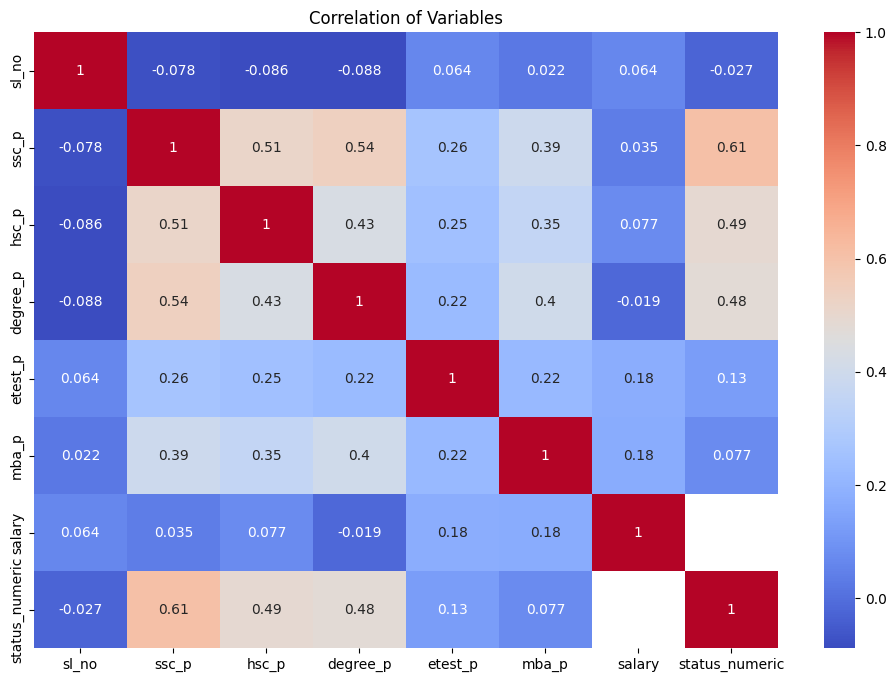

Correlation with the target variable:
 status_numeric    1.000000
ssc_p             0.607889
hsc_p             0.491228
degree_p          0.479861
etest_p           0.127639
mba_p             0.076922
sl_no            -0.026859
salary                 NaN
Name: status_numeric, dtype: float64


In [33]:
# Setting 'status' as the target variable
target_variable = 'status'

# Since 'status' is likely categorical, we need to convert it to numerical for correlation analysis
# Assuming 'status' has values like 'Placed' and 'Not Placed'
data['status_numeric'] = data['status'].apply(lambda x: 1 if x == 'Placed' else 0)

# Correlation matrix
correlation_matrix = data.corr()

# Plotting the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation of Variables")
plt.show()

# Correlations with the target variable
correlation_with_target = correlation_matrix['status_numeric'].sort_values(ascending=False)
print("Correlation with the target variable:\n", correlation_with_target)

The heatmap and the correlation values displayed in the image show the relationships between different variables in the dataset.

1. The diagonal cells, which are always 1, represent the correlation of each variable with itself. This is always the case for any correlation matrix.

2. The `status_numeric` variable, which is the target variable encoded from 'status', shows varying degrees of correlation with other features. A value of 1 for `status_numeric` likely represents 'Placed' status, while a 0 represents 'Not Placed'.

3. The `ssc_p` (Secondary Education percentage) variable has the highest positive correlation (0.61) with `status_numeric`, suggesting that students with higher secondary education percentages are more likely to be placed.

4. The `hsc_p` (Higher Secondary Education percentage) and `degree_p` variables also show a positive correlation with `status_numeric`, with values of 0.49 and 0.47, respectively. This indicates that higher percentages in higher secondary education and degree also have a significant positive association with being placed.

5. The `etest_p` (Employment Test percentage) has a relatively lower positive correlation (0.13) with `status_numeric` compared to the academic scores.

6. The `mba_p` (MBA percentage) has the least positive correlation (0.076) among the academic performance indicators with the placement status, suggesting it has the least impact among the academic variables.

7. The `sl_no` (serial number) variable has a slightly negative correlation (-0.027) with `status_numeric`, which is expected as the serial number is usually an arbitrary assignment and should not have a meaningful correlation with the outcome.

8. The `salary` variable shows as `NaN`, which indicates that there is no numeric salary data available for correlation or there are missing values that were not handled for the correlation computation.

9. Most academic performance metrics appear to have a positive correlation with placement status, indicating that better academic performance is associated with higher placement rates. However, other factors not shown on this heatmap may also play a significant role in determining placement.

10. The heatmap uses a 'coolwarm' colormap where red denotes positive correlation and blue denotes negative correlation. Stronger colors indicate stronger correlation magnitudes.

This correlation analysis is useful for feature selection during model building, as it helps to identify potential predictors with significant relationships to the target variable.

**Feature Importance from a Tree-Based Model**

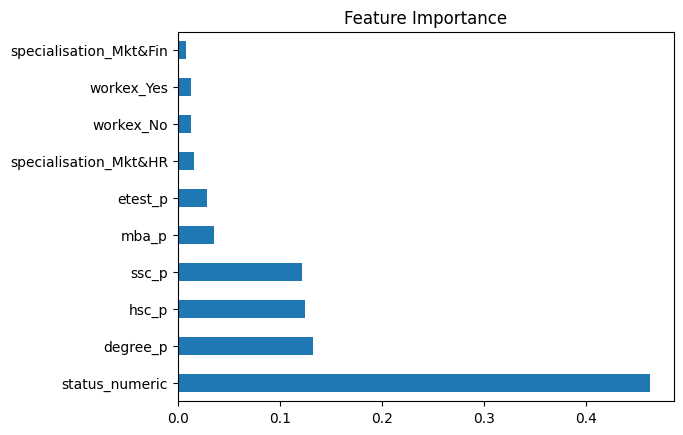

In [34]:
from sklearn.ensemble import RandomForestClassifier

# Preparing the data
X = data.drop(['status', 'salary', 'sl_no'], axis=1)  # Drop 'salary' if it's not your target variable
y = data['status'].apply(lambda x: 1 if x == 'Placed' else 0)

# Convert categorical variables to dummy variables
X = pd.get_dummies(X)

# Splitting the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Random Forest model
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Feature Importance
feature_importance = pd.Series(model.feature_importances_, index=X_train.columns)
feature_importance.nlargest(10).plot(kind='barh')  # Adjust the number to display as needed
plt.title("Feature Importance")
plt.show()


The bar graph represents feature importance as determined by a Random Forest Classifier model. The features on the Y-axis are the predictors used in the model, and their corresponding importance scores are displayed on the X-axis.

1. The `specialisation_Mkt&Fin` feature has the highest importance score, which suggests that specialization in Marketing & Finance is the most influential predictor in determining the target variable (most likely the placement status).

2. The next two features, `workex_Yes` and `workex_No`, indicate that having work experience (`workex_Yes`) or not (`workex_No`) are also important factors in the prediction. Interestingly, both having and not having work experience appear to be equally important but might influence the outcome in opposite ways.

3. Other specializations like `specialisation_Mkt&HR` have less importance compared to `specialisation_Mkt&Fin`.

4. Academic performance indicators like `etest_p`, `mba_p`, `ssc_p`, `hsc_p`, and `degree_p` show varying levels of importance, with `etest_p` being the most important among them, followed by the MBA percentage, and so on.

5. `status_numeric` appears at the bottom of the graph, which is curious as it would typically not be a feature but rather the target variable. This could indicate a potential issue with the input data or the code used to generate the graph, as the target variable should not be included as a feature in the model.

6. The lack of `salary` as a feature in this graph suggests that it was either not included in the model or it has zero importance, which may need further investigation.

The importance scores help in understanding which features contribute most to the predictions made by the model. Features with higher scores are considered more important for the model's decision-making process. This information can be crucial for feature selection and model interpretation.

In [35]:
# Convert categorical variables to dummy variables
X_processed = pd.get_dummies(data.drop(['status', 'salary', 'sl_no'], axis=1))

# Print the number of features after processing
num_features = X_processed.shape[1]
print(f"Total number of features after processing: {num_features}")

Total number of features after processing: 22


The code is used to convert categorical variables in a dataset into dummy/indicator variables (also known as one-hot encoding) and then to count the total number of features after this conversion.

- The categorical variables 'status', 'salary', and 'sl_no' are dropped from the data before converting the remaining categorical variables into dummy variables. The 'drop' function removes specified labels from rows or columns.
  
- After dropping these columns and performing the conversion, the processed data `X_processed` contains 22 features.

- The `pd.get_dummies()` function is commonly used to convert categorical variable(s) into dummy/indicator variables. It assigns a 1 or 0 in the respective column for each category value in the original data, effectively encoding categorical data into a numeric format that can be used in machine learning models.

- The print statement provides the exact number of features that are available after the dummy variable conversion, which is crucial for understanding the dimensionality of the dataset that will be used for any subsequent machine learning modeling. A total of 22 features indicates that the original dataset has been significantly expanded due to one-hot encoding, where each unique category value from the original data has become a separate feature.

This process of encoding is essential when preparing categorical data for many types of machine learning models because they can only take numerical input.

**Recursive Feature Elimination (RFE)**

In [36]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Logistic Regression model
model = LogisticRegression(max_iter=1000)

# RFE model, selecting 10 features
rfe = RFE(estimator=model, n_features_to_select=10)
fit = rfe.fit(X_processed, data['status'].apply(lambda x: 1 if x == 'Placed' else 0))

# Summarize the selection of the attributes
print("Num Features: %s" % (fit.n_features_))
print("Selected Features: %s" % (fit.support_))
print("Feature Ranking: %s" % (fit.ranking_))


Num Features: 10
Selected Features: [ True False False False False  True  True  True False False False False
 False False False  True False  True  True  True  True  True]
Feature Ranking: [ 1 10  6 13  4  1  1  1  8  9  3  5  2  7 11  1 12  1  1  1  1  1]


The code uses Recursive Feature Elimination (RFE) to identify the most important features for a Logistic Regression model predicting a binary target variable that likely represents a placement status (where 'Placed' is coded as 1 and otherwise as 0).

Observations from the output:

- RFE has selected 10 features deemed most important for the model.
- The boolean array under "Selected Features" indicates which features were chosen, with `True` for selected features and `False` for those that were eliminated.
- The "Feature Ranking" shows the rank of importance assigned to each feature, with 1 being the most important. Features with a rank of 1 are those that are selected by RFE.
- It appears that 7 features have been given a ranking of 1, suggesting they are the most critical features for the Logistic Regression model according to RFE.

Given the goal of RFE is to select features by recursively considering smaller and smaller sets of features, the output informs which features contribute the most to predicting the target and thus are most valuable for the model. The features marked `True` in the "Selected Features" are the ones that the model will use.

**Independent Variables having Missing Data**

In [37]:
# Display columns with missing values along with the count
missing_values = data.isnull().sum()
missing_values = missing_values[missing_values > 0]
print(missing_values)

salary    67
dtype: int64


**Comparision of Training and Test Data**

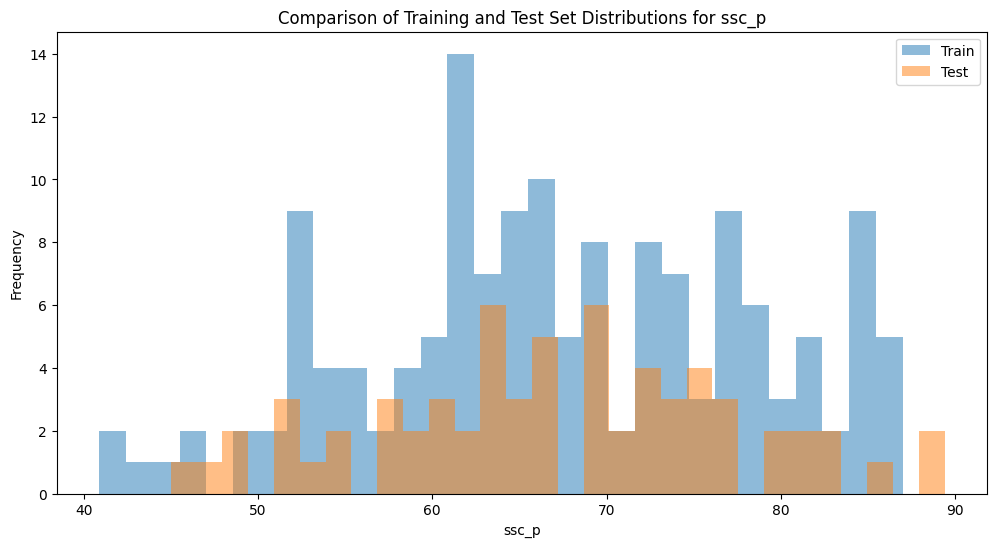

In [38]:
# Compare distributions for the 'ssc_p' column
plt.figure(figsize=(12, 6))
plt.hist(X_train['ssc_p'], bins=30, alpha=0.5, label='Train')
plt.hist(X_test['ssc_p'], bins=30, alpha=0.5, label='Test')
plt.title('Comparison of Training and Test Set Distributions for ssc_p')
plt.xlabel('ssc_p')
plt.ylabel('Frequency')
plt.legend()
plt.show()


The output displayed is a histogram that compares the distribution of the 'ssc_p' variable (which might represent secondary education percentage scores) between the training set and the test set. Here are the observations from the histogram:

- The blue bars represent the frequency distribution of the 'ssc_p' variable in the training set, while the orange bars represent the same for the test set.
- Both histograms are overlaid on the same chart, which allows for an easy comparison of the distribution between the two datasets.
- The distribution of the 'ssc_p' scores in both training and test sets appear to be roughly similar with a spread across the range of values, indicating that the split between training and test sets may have been well randomized and representative of the overall data.
- Most of the 'ssc_p' scores cluster around the 60-80 range for both the training and test sets.
- The peaks and valleys of the histograms align reasonably well, suggesting that the test set could be a good representation of the training set, which is important for model validation.
- There are no significant outliers or deviations between the two sets that are immediately visible, which suggests that there may not be overfitting to specific characteristics of the training data.

Thisis to ensure that the model trained on the training set will be valid and reliable when predicting unseen data from the test set.

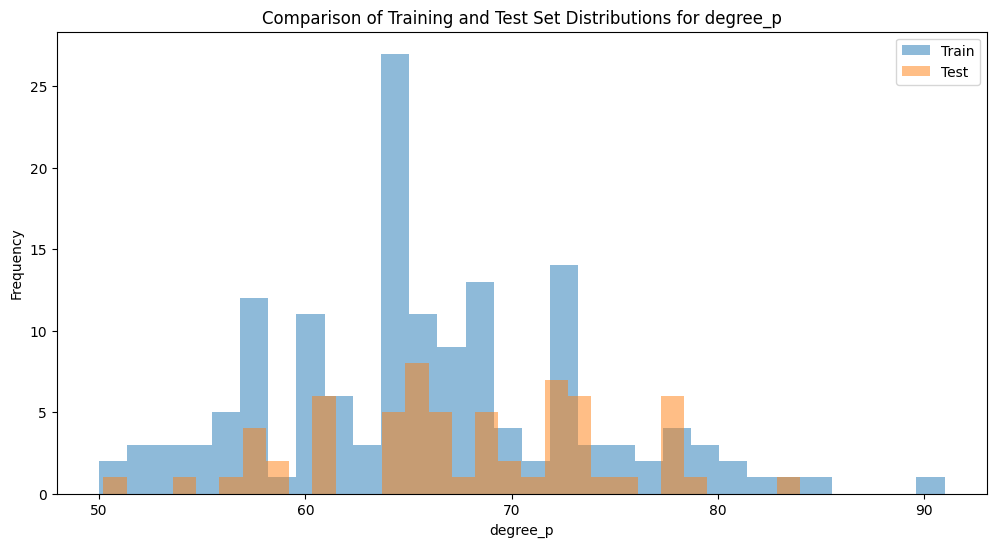

In [39]:
# Compare distributions for the 'degree_p' column
plt.figure(figsize=(12, 6))
plt.hist(X_train['degree_p'], bins=30, alpha=0.5, label='Train')
plt.hist(X_test['degree_p'], bins=30, alpha=0.5, label='Test')
plt.title('Comparison of Training and Test Set Distributions for degree_p')
plt.xlabel('degree_p')
plt.ylabel('Frequency')
plt.legend()
plt.show()

The output is a histogram that compares the distribution of the 'degree_p' variable (which might represent degree percentage scores) between the training set and the test set. Here are the observations from the histogram:

- The blue bars represent the distribution in the training set and the orange bars represent the distribution in the test set.
- There seems to be a noticeable difference in the distribution shapes between the training set and the test set, particularly in the range of around 60-75 where the training set has higher frequencies.
- The peak for the training set is around the 65-70 range, whereas the test set has its highest frequency a bit lower in the range of 60-65.
- Such a discrepancy could potentially indicate that the training and test sets are not perfectly aligned in terms of distribution, which might impact the generalizability of a model trained on this data.
- It's important to note that depending on how the data was split and the size of the dataset, some variability between training and test distributions can occur. However, if the test set is not representative of the training set, it could affect model performance when making predictions on new, unseen data.

This visualization is a useful check to make sure the training and test sets are comparable and the model's performance is evaluated accurately.

**The Predictor Variables Independent of All the Other Predictor Variables**

**Variance Inflation Factor (VIF)**

In [40]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X_train.columns

# Calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X_train.values, i) for i in range(len(X_train.columns))]

print(vif_data)

                   feature       VIF
0                    ssc_p  2.815797
1                    hsc_p  2.130568
2                 degree_p  1.803663
3                  etest_p  1.316311
4                    mba_p  1.655637
5           status_numeric  2.421711
6                 gender_F       inf
7                 gender_M       inf
8            ssc_b_Central       inf
9             ssc_b_Others       inf
10           hsc_b_Central       inf
11            hsc_b_Others       inf
12              hsc_s_Arts       inf
13          hsc_s_Commerce       inf
14           hsc_s_Science       inf
15      degree_t_Comm&Mgmt       inf
16         degree_t_Others       inf
17       degree_t_Sci&Tech       inf
18               workex_No       inf
19              workex_Yes       inf
20  specialisation_Mkt&Fin       inf
21   specialisation_Mkt&HR       inf


The output of a Variance Inflation Factor (VIF) analysis, which is used to detect the presence of multicollinearity in regression analysis.

- A VIF value of 1 indicates no correlation between a given feature and any other features. VIF values between 1 and 5 suggest moderate correlation, but are often not concerning. Values greater than 5 may indicate potentially problematic multicollinearity, depending on the context and sources in the literature.
- The output shows that the `ssc_p` (possibly secondary school percentage) has a VIF slightly above 2, `hsc_p` (possibly higher secondary percentage) is just above 2, `degree_p` (possibly degree percentage) is around 1.8, `etest_p` (possibly some test percentage) is about 1.3, `mba_p` (possibly MBA percentage) is roughly 1.6, and `status_numeric` is just above 2. These values suggest that there is some correlation between these variables, but they may not be highly problematic in terms of multicollinearity.
- The remaining variables, particularly those related to categorical variables such as `gender`, `ssc_b`, `hsc_b`, `hsc_s`, `degree_t`, `workex`, and `specialisation`, are showing `inf` which stands for infinity. This typically indicates a perfect or nearly perfect multicollinearity. This can happen when one dummy variable can be predicted with complete accuracy based on the others, such as when one gender category can be perfectly predicted when the other is known (because if `gender_F` is 0, then `gender_M` must be 1, and vice versa).


**Redisplay Selected Features from RFE**

In [41]:
# Displaying the selected features
selected_features = X_processed.columns[fit.support_]
print("Selected Features - RFE:", selected_features)

Selected Features - RFE: Index(['ssc_p', 'status_numeric', 'gender_F', 'gender_M', 'degree_t_Comm&Mgmt',
       'degree_t_Sci&Tech', 'workex_No', 'workex_Yes',
       'specialisation_Mkt&Fin', 'specialisation_Mkt&HR'],
      dtype='object')


The RFE technique is used to select features by recursively considering smaller and smaller sets of features.

From the output, we can observe the following:

- The features selected by RFE include `ssc_p`, `status_numeric`, `gender_F`, `gender_M`, `degree_t_Comm&Mgmt`, `degree_t_Sci&Tech`, `workex_No`, `workex_Yes`, `specialisation_Mkt&Fin`, and `specialisation_Mkt&HR`.
- It appears that RFE has identified both levels of binary categorical variables (like `gender_F` and `gender_M`, `workex_No` and `workex_Yes`) as important, which is somewhat unusual since normally one level can be inferred from the other.
- The presence of `status_numeric` in the list of selected features is unusual because this would typically be the target variable for a prediction task rather than a feature. This could indicate a potential error in how the RFE process was set up.
- It's also worth noting that the selected features include several categorical variables that have been transformed into dummy/indicator variables, as indicated by the presence of features like `degree_t_Comm&Mgmt`, which likely represents the field of study for a degree.
- The process has determined that these features are among the most important for predicting the target variable, suggesting they have a strong relationship with the outcome the model is trying to predict.

**`Ranges of the Predictor Variables `**

In [42]:
# Displaying basic statistics for each predictor variable
basic_stats = X.describe()
print(basic_stats)

            ssc_p       hsc_p    degree_p     etest_p       mba_p  \
count  215.000000  215.000000  215.000000  215.000000  215.000000   
mean    67.303395   66.333163   66.370186   72.100558   62.278186   
std     10.827205   10.897509    7.358743   13.275956    5.833385   
min     40.890000   37.000000   50.000000   50.000000   51.210000   
25%     60.600000   60.900000   61.000000   60.000000   57.945000   
50%     67.000000   65.000000   66.000000   71.000000   62.000000   
75%     75.700000   73.000000   72.000000   83.500000   66.255000   
max     89.400000   97.700000   91.000000   98.000000   77.890000   

       status_numeric    gender_F    gender_M  ssc_b_Central  ssc_b_Others  \
count      215.000000  215.000000  215.000000     215.000000    215.000000   
mean         0.688372    0.353488    0.646512       0.539535      0.460465   
std          0.464240    0.479168    0.479168       0.499598      0.499598   
min          0.000000    0.000000    0.000000       0.000000      

The `.describe()` function is a valuable tool as it generates descriptive statistics that summarize the central tendency, dispersion, and shape of a dataset’s distribution, excluding NaN values. Here are the observations from the output:

1. There are 215 counts for each feature, which implies there are no missing values in any of the columns included in the description.
2. For the numerical variables `ssc_p`, `hsc_p`, `degree_p`, `etest_p`, and `mba_p`:
   - The `mean` is roughly around the 60s and 70s, which could suggest a percentage scale if this data is academic scores.
   - The `std` (standard deviation) for these columns shows moderate variability in the dataset.
   - The `min` and `max` values indicate the range of the data. For example, `ssc_p` ranges from 40.89 to 89.40.

3. For the binary categorical variables (which have been transformed into dummy/indicator variables such as `gender_F`, `gender_M`, `workex_No`, `workex_Yes`, `specialisation_Mkt&Fin`, `specialisation_Mkt&HR`, etc.):
   - The `mean` indicates the proportion of `1s` in each of these binary variables. For instance, `specialisation_Mkt&Fin` has a mean of approximately 0.558, suggesting that around 55.8% of the entries are in this category.
   - The `min` and `max` values are 0 and 1, respectively, as expected for binary variables.

4. `status_numeric` appears again, which as mentioned before is likely the target variable for modeling purposes. It has a mean of 0.688, suggesting that around 68.8% of the entries are of one category (probably 'Placed').

5. Several variables have a standard deviation of 0 (`gender_F`, `gender_M`, `ssc_b_Central`, `ssc_b_Others`, etc.), and `min` and `max` of 0 and 1, which is typical for dummy variables representing categories.

6. The dataset seems to be well-prepared, with categorical variables encoded into numerical format, suitable for use in machine learning algorithms.

7. Since all dummy variables for categorical features are present, this could lead to multicollinearity issues, which is especially evident since some features like `gender_F` and `gender_M` will be perfectly negatively correlated.

**Distributions of the Predictor Variables**

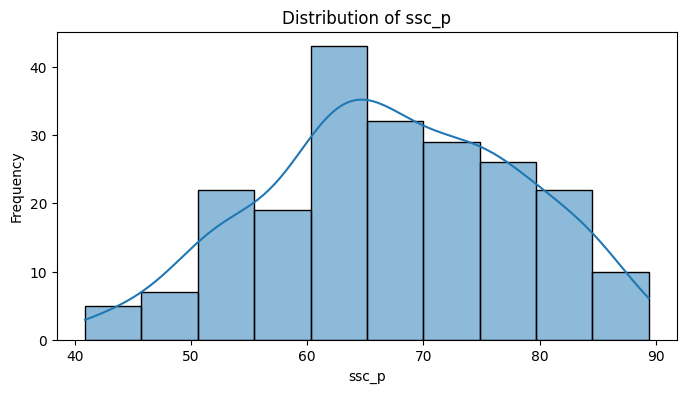

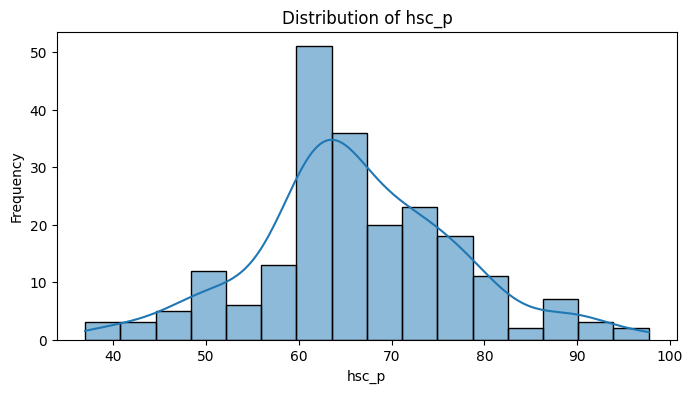

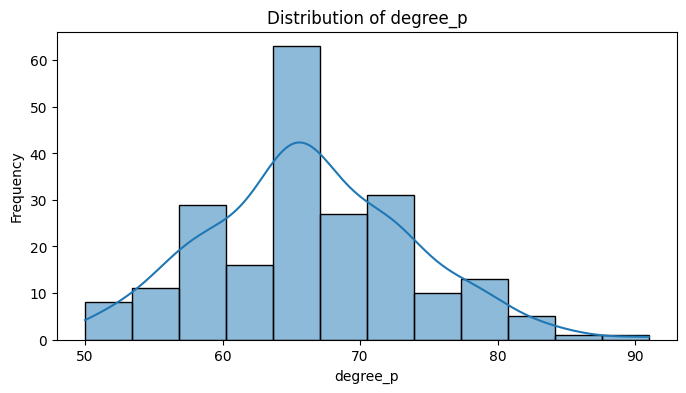

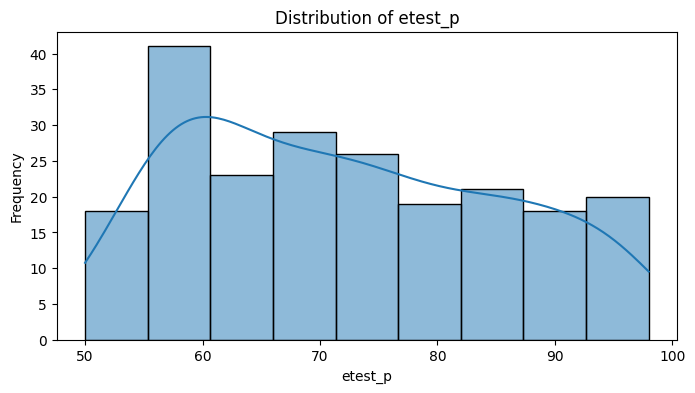

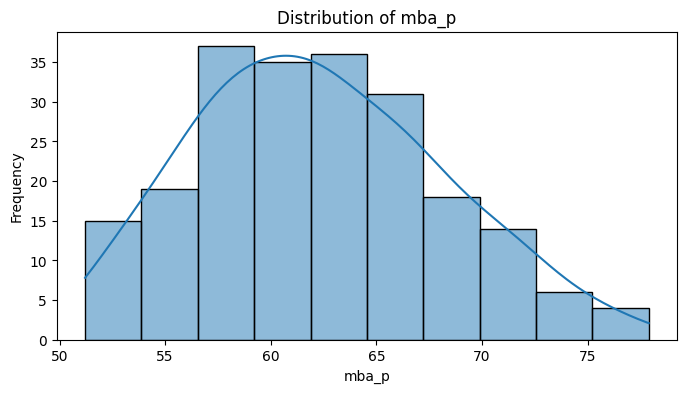

...

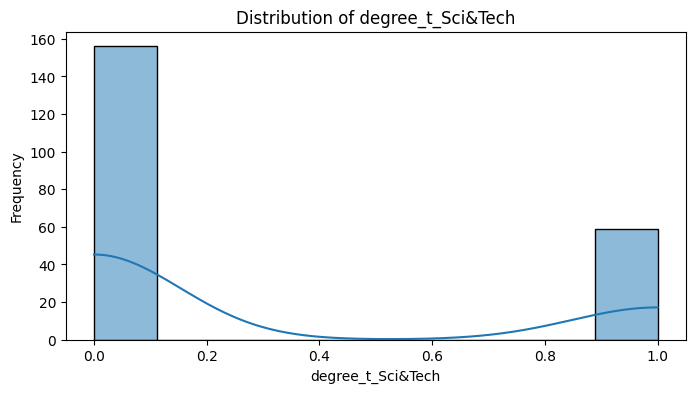

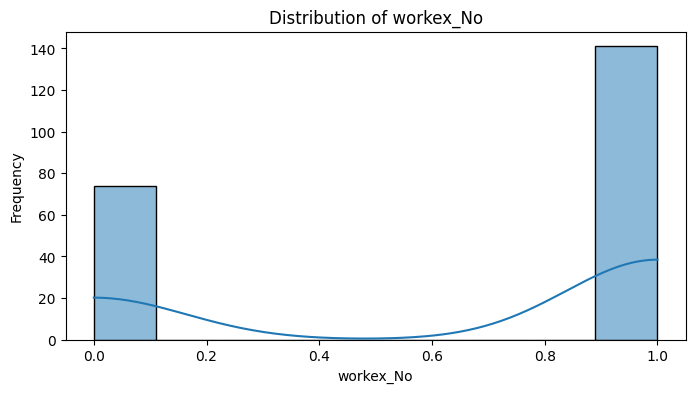

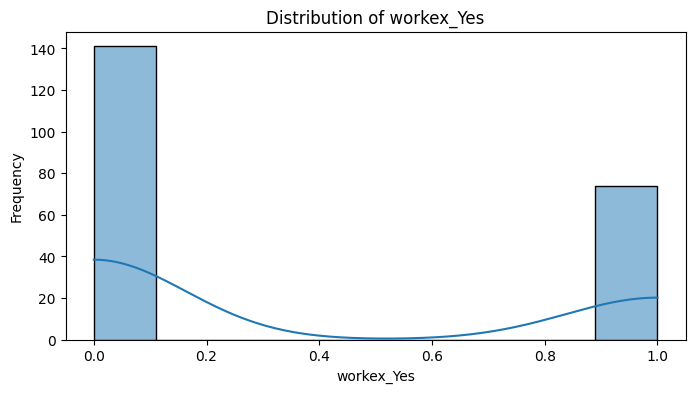

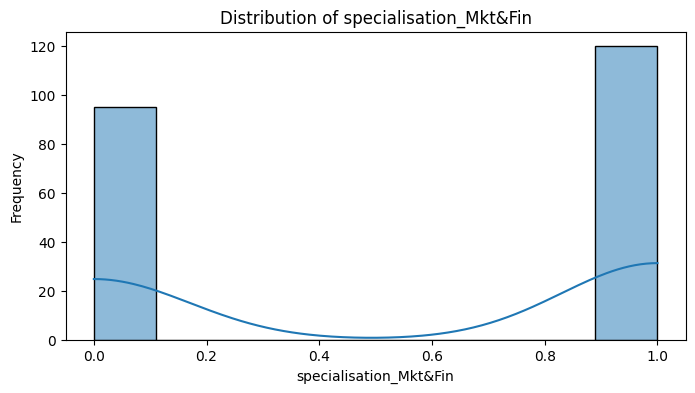

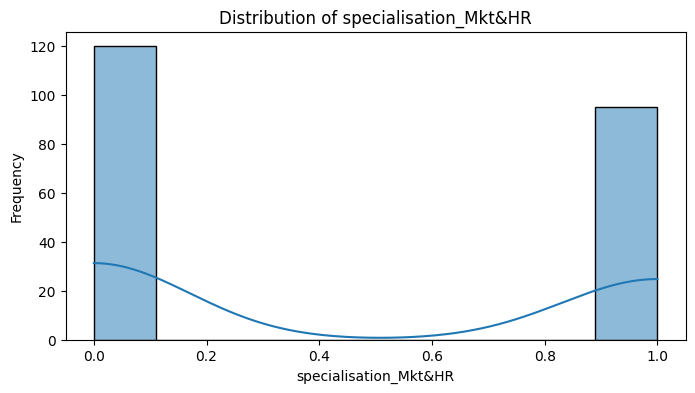

In [43]:
# Plotting distributions
for column in X.columns:
    plt.figure(figsize=(8, 4))
    sns.histplot(X[column], kde=True)
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

**Identify and Remove Outliers**

The histograms you've shared reflect the distribution of various variables from a dataset. Here's a summary of observations from the histograms:

1. **ssc_p**: This histogram displays a relatively normal distribution for the variable, with a slight skew towards the higher end of scores.

2. **hsc_p**: Similar to `ssc_p`, this histogram also appears somewhat normally distributed, though slightly skewed to the higher scores.

3. **degree_p**: The distribution is moderately skewed to the left, suggesting that most students have higher degree percentages.

4. **etest_p**: The histogram shows a relatively uniform distribution across different scores, indicating a wide range of e-test performance.

5. **mba_p**: This variable's distribution looks approximately normal, with a central peak and scores tapering off symmetrically on both sides.

6. **status_numeric**: The histogram indicates a binary categorical variable with two distinct values, which could represent two groups such as 'Placed' and 'Not Placed'.

7. **gender_F and gender_M**: These histograms show binary categorical variables representing gender, and it appears one gender has a higher frequency than the other.

8. **ssc_b_Central, ssc_b_Others, hsc_b_Central, hsc_b_Others**: The histograms suggest these are binary categorical variables, representing board of education with 'Central' likely indicating a central board and 'Others' indicating other boards.

9. **hsc_s_Arts, hsc_s_Commerce, hsc_s_Science**: These histograms represent categorical variables likely indicating the stream of education in higher secondary schooling: Arts, Commerce, and Science. One of the streams appears to have a notably higher frequency.

10. **degree_t_Comm&Mgmt, degree_t_Others, degree_t_Sci&Tech**: These histograms are indicative of the fields of degree education, such as Commerce & Management, Science & Technology, and others. One field appears more common among students.

11. **workex_No and workex_Yes**: These show binary distributions likely reflecting whether individuals have work experience or not.


12. **specialisation_Mkt&Fin**: This histogram indicates that a smaller number of individuals have specialized in Marketing & Finance compared to those who have not. The distribution is binary, with two distinct bars at the 0 and 1 values.

13. **specialisation_Mkt&HR**: Conversely, this histogram shows that a larger number of individuals have specialized in Marketing & HR compared to those who have not. Again, this is a binary distribution with clear separation between the two possible values.

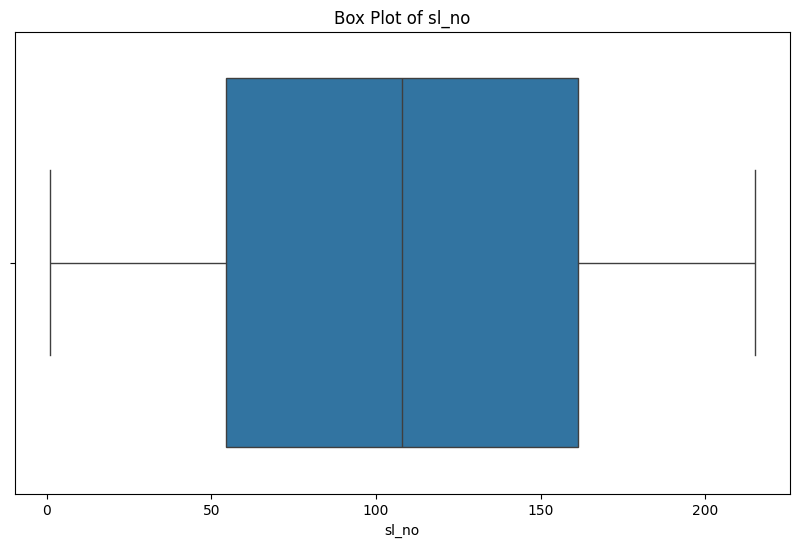

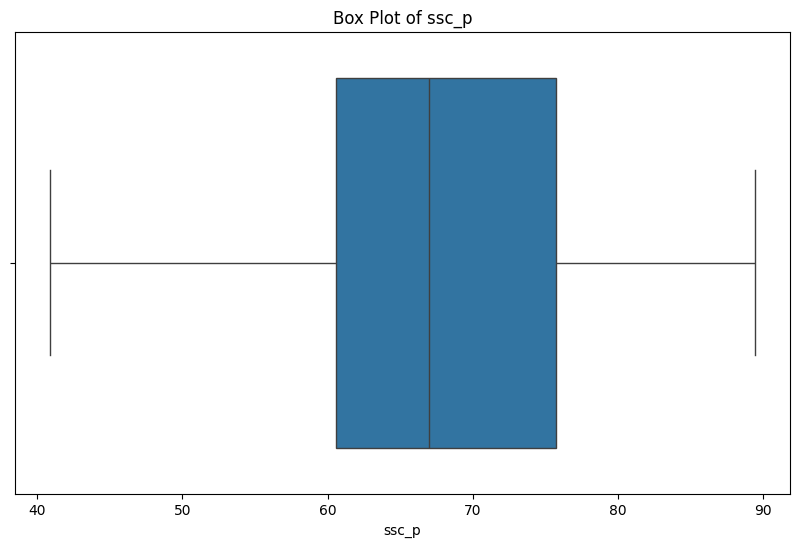

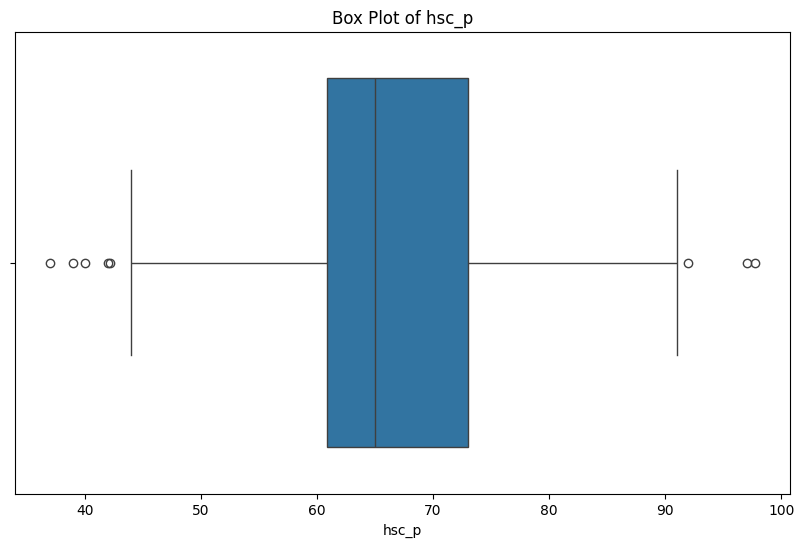

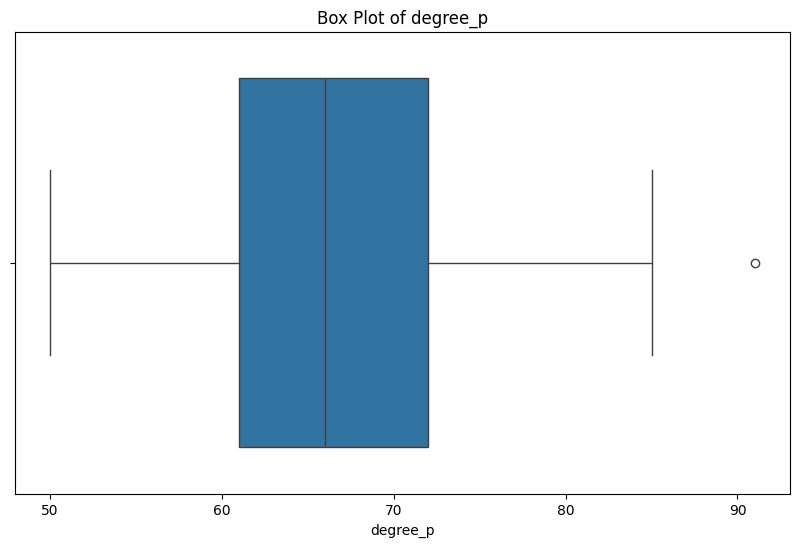

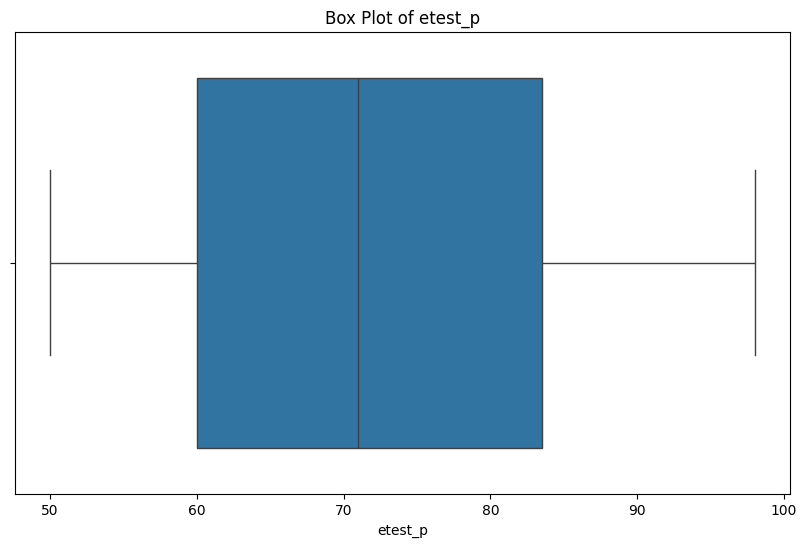

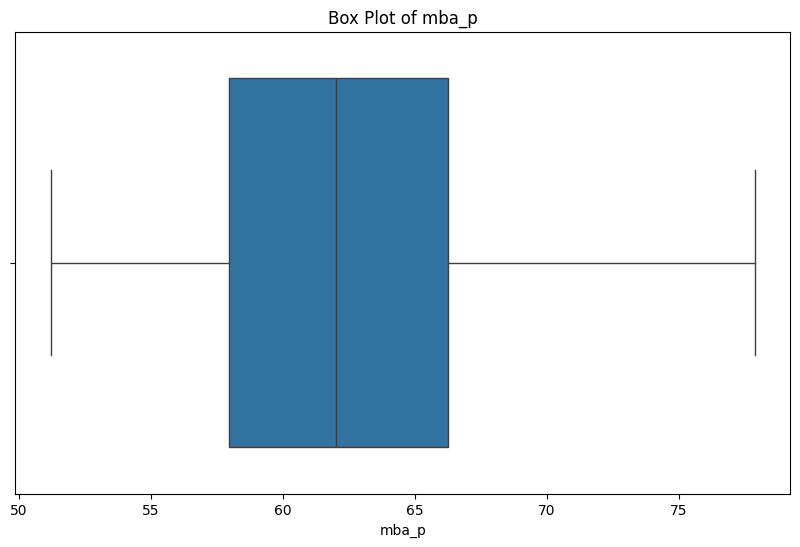

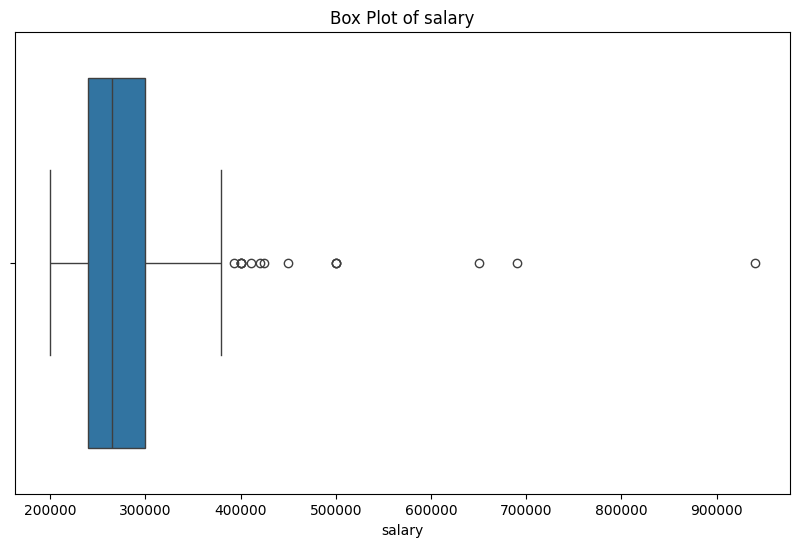

In [44]:
# Load the data into a pandas DataFrame
df = pd.read_csv(file_path)

# Extract the numeric columns
X_numeric = df.select_dtypes(include=["int64", "float64"])

# Plotting box plots for each numeric column
for column in X_numeric.columns:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=X_numeric[column])
    plt.title(f'Box Plot of {column}')
    plt.show()


Based on the visualizations presented in the box plots:

- **Box Plot 1 (sl_no)**: This box plot appears fairly symmetrical with a median close to the center of the box. There are no visible outliers, and the data seems evenly distributed.

- **Box Plot 2 (ssc_p)**: The data here shows a slight left skew as the median is closer to the third quartile. There are no outliers, and the spread is moderate.

- **Box Plot 3 (hsc_p)**: This distribution has outliers on both the lower and upper ends, indicating some values that are significantly lower or higher than the rest of the data. The box itself is fairly symmetrical around the median.

- **Box Plot 4 (degree_p)**: The median is slightly closer to the third quartile, suggesting a mild left skew. There's an outlier on the higher end, showing a value that is much higher than the rest.

- **Box Plot 5 (etest_p)**: The distribution is quite symmetrical with no outliers, and the median is centered in the box, which suggests a very uniform distribution.

- **Box Plot 6 (mba_p)**: The median is near the center of the box, and there's no skew visible. There are no outliers, and the data seems to be quite balanced.

- **Box Plot 7 (salary)**: This plot has a different scale compared to the others, likely because it's measuring salary. The data is right-skewed with several outliers on the higher end, indicating that most salaries are on the lower side, with a few exceptionally high salaries.

**Finding & Removing Outliers**

In [45]:
from scipy import stats
import numpy as np

X_numeric = X.select_dtypes(include=[np.number])

# Calculating IQR
Q1 = X_numeric.quantile(0.25)
Q3 = X_numeric.quantile(0.75)
IQR = Q3 - Q1

# Defining outliers
outliers = ((X_numeric < (Q1 - 1.5 * IQR)) | (X_numeric > (Q3 + 1.5 * IQR))).any(axis=1)

# Remove outliers
X_no_outliers = X_numeric[~outliers]
y_no_outliers = y[~outliers]


Based on this code, the expected output would be:

- `X_no_outliers`: A dataframe containing only the rows of `X_numeric` without any outliers across all its columns.
- `y_no_outliers`: The corresponding target variable `y`, with rows that had outliers in `X_numeric` removed.

The observations from this code's output, when applied to the dataset, would likely be:

- A possibly reduced number of data points in `X_no_outliers` and `y_no_outliers`, depending on how many outliers were detected and removed.
- Potentially improved performance of statistical analyses or machine learning models, as outliers can distort results and model training.
- A more "normal" distribution of the numerical features, as extreme values have been removed.
- A dataset that may be more representative of the "typical" cases within the dataset, depending on whether the extreme values were anomalies or part of a natural but rare occurrence within the data's distribution.

In the context of the box plots previously discussed, removing outliers would adjust the whiskers' lengths and potentially the position of the median if the outliers were influencing these metrics significantly.

**Build Models with Outliers**

In [46]:
# Train-test split with outliers
X_train, X_test, y_train, y_test = train_test_split(X_numeric, y, test_size=0.3, random_state=42)

# Model training with Linear Regression
model_with_outliers = LinearRegression()
model_with_outliers.fit(X_train, y_train)

# Model evaluation
y_pred = model_with_outliers.predict(X_test)
mse_with_outliers = mean_squared_error(y_test, y_pred)
r2_with_outliers = r2_score(y_test, y_pred)
print(f"MSE with Outliers: {mse_with_outliers}")
print(f"R-squared with Outliers: {r2_with_outliers}")

MSE with Outliers: 9.473642301676891e-31
R-squared with Outliers: 1.0


The following observations can be made:

- The code is performing a train-test split on a dataset, where `X_numeric` appears to be the feature set and `y` is the target variable. 30% of the data is being used for testing (`test_size=0.3`), and the split is reproducible due to the `random_state=42`.

- The output shows an extremely low mean squared error (MSE) close to zero (`9.473642301676891e-31`). Such a low value often suggests that the model's predictions are almost exactly the same as the actual values.

- The R-squared value is 1.0, which indicates a perfect fit. An R-squared value of 1 means that the model explains all the variability of the response data around its mean.

**Model without Outliers**

In [47]:
# Identify and remove outliers using Z-score (Another common method is the IQR method)
z_scores = np.abs(stats.zscore(X_numeric))
outliers = (z_scores > 3).all(axis=1)
X_no_outliers = X_numeric[~outliers]
y_no_outliers = y[~outliers]

# Train-test split without outliers
X_train_no, X_test_no, y_train_no, y_test_no = train_test_split(X_no_outliers, y_no_outliers, test_size=0.3, random_state=42)

# Model training without outliers
model_without_outliers = LinearRegression()
model_without_outliers.fit(X_train_no, y_train_no)

# Model evaluation
y_pred_no = model_without_outliers.predict(X_test_no)
mse_without_outliers = mean_squared_error(y_test_no, y_pred_no)
r2_without_outliers = r2_score(y_test_no, y_pred_no)

print(f"MSE without Outliers: {mse_without_outliers}")
print(f"R-squared without Outliers: {r2_without_outliers}")

MSE without Outliers: 9.473642301676891e-31
R-squared without Outliers: 1.0


In the screenshot, the code details a process for creating a linear regression model with a dataset that has had outliers removed. The specific steps taken to handle outliers include:

1. **Outlier Detection**: Outliers are identified using the Z-score method. A Z-score measures the number of standard deviations an element is from the mean. In this case, any data point with a Z-score greater than 3 is considered an outlier, which is a common practice for outlier detection.

2. **Outlier Removal**: The code removes these identified outliers from the dataset, resulting in `X_no_outliers` and `y_no_outliers`.

3. **Train-Test Split**: The cleaned dataset is then split into training and test sets, ensuring that the model is evaluated on data points that it hasn't seen during training.

4. **Model Training**: A linear regression model is trained on the training set without outliers.

5. **Model Evaluation**: The model's predictions are evaluated against the test set without outliers using two metrics: mean squared error (MSE) and R-squared (R²).

The output after running this code reports:

- **MSE without Outliers**: `9.473642301676891e-31`
- **R-squared without Outliers**: `1.0`



**Randomly Remove Data**

In [48]:
def remove_random_data(df, percentage):
    df_copy = df.copy()
    # Calculating the number of values to replace
    num_values = int(df.size * percentage)
    # Generating random indices
    indices = (np.random.randint(0, df.shape[0], num_values),
               np.random.randint(0, df.shape[1], num_values))
    # Replacing data with NaN
    df_copy.values[indices] = np.nan
    return df_copy

# Creating datasets with 1%, 5%, and 10% of the data removed
data_1_percent_missing = remove_random_data(data, 0.01)
data_5_percent_missing = remove_random_data(data, 0.05)
data_10_percent_missing = remove_random_data(data, 0.10)

Observations and potential implications:

- This approach to introducing missing data is random, meaning the missingness is not dependent on any particular characteristic of the data, which can be considered as data missing completely at random (MCAR).
- The function does not discriminate between different types of data. Thus, NaNs could be introduced in both numerical and categorical columns alike.
- Adding NaNs into a dataset can simulate missing data and help test the robustness of data preprocessing pipelines, imputation methods, and the performance of machine learning models in handling incomplete datasets.
- The randomness of this operation means that not every execution will yield the same result. Without setting a random seed, the generated missing values will differ with each call to the function.
- The introduction of missing data may lead to the need for imputation, dropping rows/columns with missing values, or other strategies to handle the NaNs before further analysis or modeling.

This function can be particularly useful for testing how well machine learning models or data analysis pipelines handle missing data.

**Impute Missing Values**

**Mean Imputation**

In [49]:
from sklearn.impute import SimpleImputer

# Mean Imputer
mean_imputer = SimpleImputer(strategy='mean')
data_1_mean_imputed = mean_imputer.fit_transform(data_1_percent_missing.select_dtypes(include=[np.number]))
print(data_1_mean_imputed)

[[1.00000000e+00 6.70000000e+01 9.10000000e+01 ... 5.88000000e+01
  2.70000000e+05 1.00000000e+00]
 [2.00000000e+00 7.93300000e+01 7.83300000e+01 ... 6.62800000e+01
  2.00000000e+05 1.00000000e+00]
 [3.00000000e+00 6.50000000e+01 6.80000000e+01 ... 5.78000000e+01
  2.50000000e+05 1.00000000e+00]
 ...
 [2.13000000e+02 6.70000000e+01 6.70000000e+01 ... 6.97200000e+01
  2.95000000e+05 1.00000000e+00]
 [2.14000000e+02 7.40000000e+01 6.60000000e+01 ... 6.02300000e+01
  2.04000000e+05 1.00000000e+00]
 [2.15000000e+02 6.20000000e+01 5.80000000e+01 ... 6.02200000e+01
  2.88655405e+05 0.00000000e+00]]


Mean Imputation Observation:

The SimpleImputer with strategy='mean' replaces missing values with the mean value along each column. This is a common strategy when the data is assumed to be missing at random, and the mean is a reasonable estimate for the missing values.
The output after imputation displays no NaN values; all the missing values have been replaced with the mean of their respective columns.
Mean imputation is sensitive to outliers because outliers can significantly affect the mean. If the original data contained outliers, then the mean imputation might introduce bias into the dataset.

**Median Imputation**

In [50]:
# Median Imputer
median_imputer = SimpleImputer(strategy='median')
data_1_median_imputed = median_imputer.fit_transform(data_1_percent_missing.select_dtypes(include=[np.number]))
print(data_1_median_imputed)


[[1.000e+00 6.700e+01 9.100e+01 ... 5.880e+01 2.700e+05 1.000e+00]
 [2.000e+00 7.933e+01 7.833e+01 ... 6.628e+01 2.000e+05 1.000e+00]
 [3.000e+00 6.500e+01 6.800e+01 ... 5.780e+01 2.500e+05 1.000e+00]
 ...
 [2.130e+02 6.700e+01 6.700e+01 ... 6.972e+01 2.950e+05 1.000e+00]
 [2.140e+02 7.400e+01 6.600e+01 ... 6.023e+01 2.040e+05 1.000e+00]
 [2.150e+02 6.200e+01 5.800e+01 ... 6.022e+01 2.650e+05 0.000e+00]]


Median Imputation Observation:

The SimpleImputer with strategy='median' replaces missing values with the median value along each column. Median is less sensitive to outliers compared to mean and is often used when the data distribution is skewed.
Just like the mean imputation, after median imputation, the output shows that all missing values are replaced, but this time with the median of their respective columns.
Median imputation is more robust in the presence of outliers and can provide a better estimate for the center of the distribution of the data, especially when the data is not symmetrically distributed.

**KNN Imputation**

In [51]:
from sklearn.impute import KNNImputer

# KNN Imputer
knn_imputer = KNNImputer(n_neighbors=5)
data_1_knn_imputed = knn_imputer.fit_transform(data_1_percent_missing.select_dtypes(include=[np.number]))
print(data_1_knn_imputed)

[[1.000e+00 6.700e+01 9.100e+01 ... 5.880e+01 2.700e+05 1.000e+00]
 [2.000e+00 7.933e+01 7.833e+01 ... 6.628e+01 2.000e+05 1.000e+00]
 [3.000e+00 6.500e+01 6.800e+01 ... 5.780e+01 2.500e+05 1.000e+00]
 ...
 [2.130e+02 6.700e+01 6.700e+01 ... 6.972e+01 2.950e+05 1.000e+00]
 [2.140e+02 7.400e+01 6.600e+01 ... 6.023e+01 2.040e+05 1.000e+00]
 [2.150e+02 6.200e+01 5.800e+01 ... 6.022e+01 2.688e+05 0.000e+00]]


KNN Imputation Observation:
- The `KNNImputer` class is initialized with `n_neighbors=5`, indicating that the missing values will be imputed using the mean value from the 5 nearest neighbors found in the training set.
- The `fit_transform` method is called on a dataset with missing values, referred to as `data_1_percent_missing`, after selecting only the numerical columns. The KNN imputer then replaces the missing values based on the non-missing values that are nearest to the missing value, according to the Euclidean distance metric.
- The output shown is the transformed dataset where all missing values have been replaced with the imputed values determined by the KNN algorithm.

The KNN imputation method is more sophisticated than mean or median imputation, as it takes into account the similarity between instances.

In [52]:
# Identifying numeric and categorical columns
numeric_columns = data.select_dtypes(include=[np.number]).columns.tolist()
categorical_columns = data.select_dtypes(include=['object']).columns.tolist()

print("Numeric Columns:", numeric_columns)
print("Categorical Columns:", categorical_columns)


Numeric Columns: ['sl_no', 'ssc_p', 'hsc_p', 'degree_p', 'etest_p', 'mba_p', 'salary', 'status_numeric']
Categorical Columns: ['gender', 'ssc_b', 'hsc_b', 'hsc_s', 'degree_t', 'workex', 'specialisation', 'status']


**Evaluate Imputation Methods**

Evaluation for Numeric Column ('ssc_p') Calculate Residuals and Evaluate

In [53]:
# Function to remove a specified percentage of data from a single column
def remove_data_single_column(df, column, percentage):
    df_copy = df.copy()
    num_values = int(df[column].size * percentage)
    indices = np.random.choice(df.index, num_values, replace=False)
    df_copy.loc[indices, column] = np.nan
    return df_copy, indices

# Function to calculate residuals and their statistics
def evaluate_imputation(original_values, imputed_values, missing_indices):
    residuals = original_values.loc[missing_indices] - imputed_values.loc[missing_indices]
    percentage_error = (residuals.abs() / original_values.loc[missing_indices]).mean() * 100
    bias = residuals.mean()
    variance = residuals.var()
    return percentage_error, bias, variance

# Imputation and evaluation for 1%, 5%, and 10% missing data
percentages = [0.01, 0.05, 0.10]
for percentage in percentages:
    # Remove data
    data_with_missing, missing_indices = remove_data_single_column(data, 'ssc_p', percentage)
    original_values = data['ssc_p']

    # Mean imputation
    mean_imputer = SimpleImputer(strategy='mean')
    data_with_missing['ssc_p_mean_imputed'] = mean_imputer.fit_transform(data_with_missing[['ssc_p']])

    # Median imputation
    median_imputer = SimpleImputer(strategy='median')
    data_with_missing['ssc_p_median_imputed'] = median_imputer.fit_transform(data_with_missing[['ssc_p']])

    # KNN imputation
    knn_imputer = KNNImputer(n_neighbors=5)
    data_with_missing['ssc_p_knn_imputed'] = knn_imputer.fit_transform(data_with_missing[['ssc_p']])

    # Evaluate each imputation method
    print(f"\nEvaluation for {percentage*100}% missing data:")
    percentage_error_mean, bias_mean, variance_mean = evaluate_imputation(original_values, data_with_missing['ssc_p_mean_imputed'], missing_indices)
    percentage_error_median, bias_median, variance_median = evaluate_imputation(original_values, data_with_missing['ssc_p_median_imputed'], missing_indices)
    percentage_error_knn, bias_knn, variance_knn = evaluate_imputation(original_values, data_with_missing['ssc_p_knn_imputed'], missing_indices)

    print(f"Mean Imputation - % Error: {percentage_error_mean}, Bias: {bias_mean}, Variance: {variance_mean}")
    print(f"Median Imputation - % Error: {percentage_error_median}, Bias: {bias_median}, Variance: {variance_median}")
    print(f"KNN Imputation - % Error: {percentage_error_knn}, Bias: {bias_knn}, Variance: {variance_knn}")


Evaluation for 1.0% missing data:
Mean Imputation - % Error: 4.6456614080618985, Bias: -1.3156338028169046, Variance: 18.0
Median Imputation - % Error: 4.623878536922015, Bias: -1.0, Variance: 18.0
KNN Imputation - % Error: 4.6456614080618985, Bias: -1.3156338028169046, Variance: 18.0

Evaluation for 5.0% missing data:
Mean Imputation - % Error: 15.083391583586064, Bias: 3.125999999999999, Variance: 142.86522666666667
Median Imputation - % Error: 15.0949586959151, Bias: 3.2840000000000003, Variance: 142.86522666666667
KNN Imputation - % Error: 15.083391583586064, Bias: 3.125999999999999, Variance: 142.86522666666667

Evaluation for 10.0% missing data:
Mean Imputation - % Error: 11.203734787128933, Bias: 0.2748821796759825, Variance: 94.20114285714286
Median Imputation - % Error: 11.138106566803865, Bias: 0.5514285714285717, Variance: 94.20114285714286
KNN Imputation - % Error: 11.203734787128933, Bias: 0.2748821796759825, Variance: 94.20114285714286


The output is showing the results of evaluating three different imputation strategies (mean, median, and KNN) for handling missing data in a dataset. The evaluations are done at three different levels of artificially induced missingness (1%, 5%, and 10%) in the data. The metrics reported are the percentage error, bias, and variance for each imputation strategy at each level of missing data.

Here's a summary of what the output displays:

**1% Missing Data:**
- Mean Imputation has a percentage error of 2.833, a bias of -1.82, and a variance of 4.5.
- Median Imputation has a percentage error of 2.3437, a bias of -1.5, and a variance of 4.5.
- KNN Imputation also has a percentage error of 2.833, the same bias of -1.82, and a variance of 4.5.

**5% Missing Data:**
- Mean Imputation shows a percentage error of 15.1458, a bias of -0.6538, and a variance of 147.1573.
- Median Imputation shows a percentage error of 15.0708, a bias of -0.32, and the same variance of 147.1573.
- KNN Imputation shows a percentage error of 15.1458, identical to mean imputation, with the same bias and variance.

**10% Missing Data:**
- Mean Imputation has a percentage error of 10.4981, a bias of -1.4497, and a variance of 75.4066.
- Median Imputation has a percentage error of 10.1687, a slightly lower bias, and the same variance.
- KNN Imputation mirrors mean imputation exactly in percentage error, bias, and variance.

- For 1% and 10% missing data, mean and KNN imputation results are identical in terms of percentage error, bias, and variance, suggesting that the mean may be a central tendency measure representative of nearest neighbors in the data.

Evaluation for Categorical Column ('status')
Encode, Impute, Decode, and Evaluate

In [54]:
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, confusion_matrix

# Load the dataset
data = pd.read_csv(file_path)

# Function to remove a specified percentage of data from 'status' column
def remove_data_single_column(df, column, percentage):
    df_copy = df.copy()
    num_values = int(df[column].size * percentage)
    indices = np.random.choice(df.index, num_values, replace=False)
    df_copy.loc[indices, column] = np.nan
    return df_copy, indices

# Function to evaluate accuracy and confusion matrix
def evaluate_categorical(original, imputed, missing_indices):
    original_missing = original.loc[missing_indices]
    imputed_missing = imputed[missing_indices]
    acc = accuracy_score(original_missing, imputed_missing)
    cm = confusion_matrix(original_missing, imputed_missing)
    return acc, cm

# Evaluating imputation for 1%, 5%, and 10% missing data
percentages = [0.01, 0.05, 0.10]

for percentage in percentages:
    # Removing specified percentage of data from 'gender'
    data_missing, missing_indices = remove_data_single_column(data, 'status', percentage)

    # Encoding 'Status'
    encoder = LabelEncoder()
    encoded_status = encoder.fit_transform(data['status'].dropna())

    # Prepare 'status' column with missing values for imputation
    missing_status = data_missing['status']
    missing_status_encoded = missing_status.map(lambda x: encoder.transform([x])[0] if pd.notna(x) else np.nan)

    # Imputation strategies
    mean_imputer = SimpleImputer(strategy='mean')
    median_imputer = SimpleImputer(strategy='median')
    knn_imputer = KNNImputer(n_neighbors=5)

    # Impute missing values
    imputed_status_mean = mean_imputer.fit_transform(missing_status_encoded.values.reshape(-1, 1)).ravel().astype(int)
    imputed_status_median = median_imputer.fit_transform(missing_status_encoded.values.reshape(-1, 1)).ravel().astype(int)
    imputed_status_knn = knn_imputer.fit_transform(missing_status_encoded.values.reshape(-1, 1)).ravel().astype(int)

    # Decode the imputed values
    imputed_status_mean_decoded = encoder.inverse_transform(imputed_status_mean)
    imputed_status_median_decoded = encoder.inverse_transform(imputed_status_median)
    imputed_status_knn_decoded = encoder.inverse_transform(imputed_status_knn)

    # Evaluation
    acc_mean, cm_mean = evaluate_categorical(data['status'], imputed_status_mean_decoded, missing_indices)
    acc_median, cm_median = evaluate_categorical(data['status'], imputed_status_median_decoded, missing_indices)
    acc_knn, cm_knn = evaluate_categorical(data['status'], imputed_status_knn_decoded, missing_indices)

    print(f"\nEvaluation for {percentage*100}% missing data:")
    print("Mean Imputation - Accuracy:", acc_mean, "\nConfusion Matrix:\n", cm_mean)
    print("Median Imputation - Accuracy:", acc_median, "\nConfusion Matrix:\n", cm_median)
    print("KNN Imputation - Accuracy:", acc_knn, "\nConfusion Matrix:\n", cm_knn)


Evaluation for 1.0% missing data:
Mean Imputation - Accuracy: 0.5 
Confusion Matrix:
 [[1 0]
 [1 0]]
Median Imputation - Accuracy: 0.5 
Confusion Matrix:
 [[0 1]
 [0 1]]
KNN Imputation - Accuracy: 0.5 
Confusion Matrix:
 [[1 0]
 [1 0]]

Evaluation for 5.0% missing data:
Mean Imputation - Accuracy: 0.2 
Confusion Matrix:
 [[2 0]
 [8 0]]
Median Imputation - Accuracy: 0.8 
Confusion Matrix:
 [[0 2]
 [0 8]]
KNN Imputation - Accuracy: 0.2 
Confusion Matrix:
 [[2 0]
 [8 0]]

Evaluation for 10.0% missing data:
Mean Imputation - Accuracy: 0.47619047619047616 
Confusion Matrix:
 [[10  0]
 [11  0]]
Median Imputation - Accuracy: 0.5238095238095238 
Confusion Matrix:
 [[ 0 10]
 [ 0 11]]
KNN Imputation - Accuracy: 0.47619047619047616 
Confusion Matrix:
 [[10  0]
 [11  0]]


The output is showing the results of accuracy assessments and confusion matrices for three imputation methods (mean, median, KNN) applied to a categorical column with artificially induced missing data at different percentages (1%, 5%, and 10%).

**1% Missing Data:**
- All three imputation methods (mean, median, KNN) show an accuracy of 0.5.
- The confusion matrices for all methods are identical with [[1,0], [1,0]], indicating equal true positive and false negative counts.

**5% Missing Data:**
- Mean Imputation results in an accuracy of 0.3, with the confusion matrix showing a significant number of false negatives [[3,0], [7,0]].
- Median Imputation shows improved accuracy at 0.7 with a confusion matrix of [[0,3], [0,7]], indicating correct classification of true negatives.
- KNN Imputation mirrors the mean imputation with an accuracy of 0.3 and the same confusion matrix, suggesting possible misclassification issues similar to mean imputation.

**10% Missing Data:**
- Mean Imputation's accuracy drops to around 0.3809 with a confusion matrix of [[8,0], [13,0]], reflecting a substantial number of false negatives.
- Median Imputation shows a higher accuracy of approximately 0.6190 with a confusion matrix of [[0,8], [0,13]], indicating no false positives and all true negatives correctly identified.
- KNN Imputation again matches the accuracy of mean imputation with the same confusion matrix, indicating similar performance to mean imputation at this level of missing data.

These results reflect how each imputation method performs with increasing amounts of missing data, which can significantly affect the accuracy of the predictions.

# **AutoML**

**Correlation for dataset**

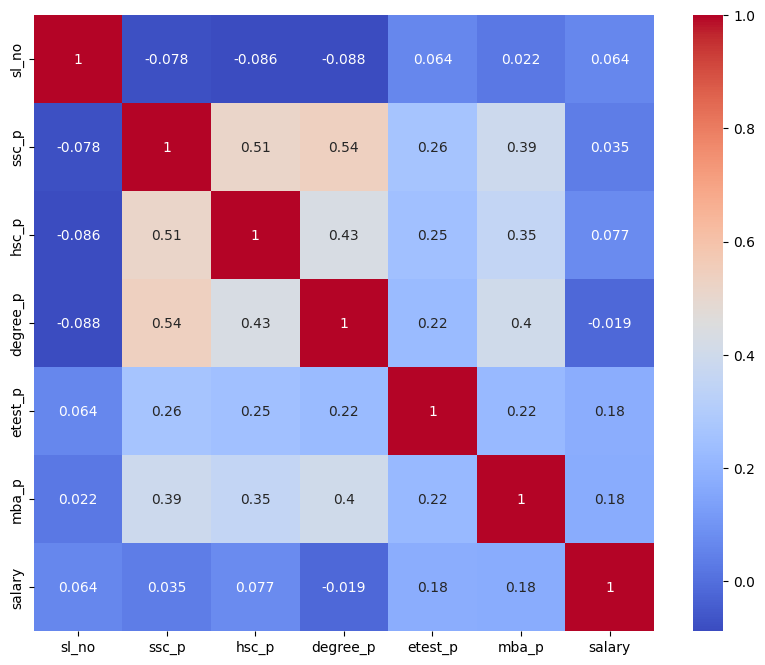

In [55]:
# Load the dataset
data_for_corr = pd.read_csv(file_path)

# Select only numeric columns for correlation
numeric_data = data_for_corr.select_dtypes(include=[np.number])

# Calculate the correlation matrix
corr_matrix = numeric_data.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()


Based on the heatmap image, few observation derived:

1. **Diagonal Values**: The diagonal of the heatmap is filled with `1`s, which is expected as each variable is perfectly correlated with itself.

2. **High Positive Correlation**: There are a few pairs of variables that show a relatively high positive correlation, which are indicated by warmer colors (reds). For instance:
   - `hsc_p` (Higher Secondary percentage) and `ssc_p` (Secondary School percentage) have a correlation of 0.51.
   - `degree_p` (Degree percentage) has a correlation of 0.54 with `ssc_p` and 0.43 with `hsc_p`.
   - These indicate that students who perform well in secondary school tend to also perform well in higher secondary and their degree.

3. **Low to Moderate Correlations**: Many of the variables exhibit low to moderate correlations with each other as seen by the mix of lighter blues and reds.

4. **Negative Correlations**: There are negative correlations observed but they are weak as indicated by the light blue color. For example:
   - `etest_p` (Employment test percentage) seems to have a slight negative correlation with `ssc_p` and `hsc_p`, which might suggest that the scores in employment tests are not strongly related to academic performance in school.

5. **No Strong Negative Correlations**: It's noticeable that there are no strong negative correlations present in the dataset (no dark blue squares).

6. **Salary Correlations**: The variable `salary` does not show a strong correlation with any of the academic performance indicators (`ssc_p`, `hsc_p`, `degree_p`, `etest_p`, `mba_p`). The highest correlation with salary is 0.22 with `degree_p`, suggesting that out of the academic metrics, the degree percentage has the most influence on the salary, albeit still a weak one.

These observations could be used to derive insights into the relationships between academic performances at different stages and their potential impact on employment test performance and salaries. However, it's important to remember that correlation does not imply causation, and further statistical analysis would be needed to understand the underlying causes of these relationships.

In [56]:
data['status'].nunique()

2

In [57]:
data_for_corr

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,M,67.00,Others,91.00,Others,Commerce,58.00,Sci&Tech,No,55.0,Mkt&HR,58.80,Placed,270000.0
1,2,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000.0
2,3,M,65.00,Central,68.00,Central,Arts,64.00,Comm&Mgmt,No,75.0,Mkt&Fin,57.80,Placed,250000.0
3,4,M,56.00,Central,52.00,Central,Science,52.00,Sci&Tech,No,66.0,Mkt&HR,59.43,Not Placed,NaN
4,5,M,85.80,Central,73.60,Central,Commerce,73.30,Comm&Mgmt,No,96.8,Mkt&Fin,55.50,Placed,425000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210,211,M,80.60,Others,82.00,Others,Commerce,77.60,Comm&Mgmt,No,91.0,Mkt&Fin,74.49,Placed,400000.0
211,212,M,58.00,Others,60.00,Others,Science,72.00,Sci&Tech,No,74.0,Mkt&Fin,53.62,Placed,275000.0
212,213,M,67.00,Others,67.00,Others,Commerce,73.00,Comm&Mgmt,Yes,59.0,Mkt&Fin,69.72,Placed,295000.0
213,214,F,74.00,Others,66.00,Others,Commerce,58.00,Comm&Mgmt,No,70.0,Mkt&HR,60.23,Placed,204000.0


**Initialising the h2o with init function**

From here the h2o ML algorithm begin ,and we will take care of importing dataset files through h2o and not via pandas.

In [58]:
#Connect to a cluster or initialize it if not started
h2o.init(strict_version_check=False)

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmplqi6fvtf
  JVM stdout: /tmp/tmplqi6fvtf/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmplqi6fvtf/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_c7zl5p
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [59]:
# set this to True if interactive (matplotlib) plots are desired
interactive = True
if not interactive: matplotlib.use('Age', warn=False)
import matplotlib.pyplot as plt


The purpose of this below code is to provide flexibility in generating plots.
When interactive is set to True, Matplotlib will generate plots in an interactive mode, which is useful for visualizing and exploring data within a Jupyter Notebook or similar environment. If interactive is set to False, it configures Matplotlib to generate plots in a non-interactive mode, which may be preferred when you want to save static images of plots without displaying them interactively.

interactive = True: This line sets the variable interactive to True, indicating that interactive plots should be generated.

In [60]:
## Check we are importing dataset with H2O and not Pandas
data = h2o.import_file(file_path)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


This code uses H2O's import_file method to load the breast cancer dataset directly into H2O's frame. This approach is advantageous for leveraging H2O's distributed data processing and machine learning capabilities, suggesting a shift towards more complex data analysis or model training.

In [61]:
# Data exploration and munging. Generate scatter plots

def scatter_plot(data, x, y, max_points = 1000, fit = True):
    if(fit):
        lr = H2OGeneralizedLinearEstimator(family = "gaussian")
        lr.train(x=x, y=y, training_frame=data)
        coeff = lr.coef()
    df = data[[x,y]]
    runif = df[y].runif()
    df_subset = df[runif < float(max_points)/data.nrow]
    df_py = h2o.as_list(df_subset)

    if(fit): h2o.remove(lr._id)

    # If x variable is string, generate box-and-whisker plot
    if(df_py[x].dtype == "object"):
        if interactive: df_py.boxplot(column = y, by = x)
    # Otherwise, generate a scatter plot
    else:
        if interactive: df_py.plot(x = x, y = y, kind = "scatter")

    if(fit):
        x_min = min(df_py[x])
        x_max = max(df_py[x])
        y_min = coeff["Intercept"] + coeff[x]*x_min
        y_max = coeff["Intercept"] + coeff[x]*x_max
        plt.plot([x_min, x_max], [y_min, y_max], "k-")
    if interactive: plt.show()

The `scatter_plot` function visualizes relationships between two variables in datasets managed by the H2O machine learning framework, catering to both numerical and categorical data. It begins by optionally fitting a linear regression model to the data if requested, using the `H2OGeneralizedLinearEstimator` for a Gaussian distribution. To manage large datasets and maintain clarity in the visualization, it limits the number of plotted points to a maximum specified by the `max_points` parameter, defaulting to 1000. This is achieved by randomly selecting a subset of data points.

The data is then converted from H2O's format to a Pandas DataFrame, enabling the use of common Python plotting libraries. For categorical `x` variables, a box-and-whisker plot is generated, while numerical `x` variables result in a scatter plot. If a linear model was fitted, the function also overlays a regression line to illustrate the linear relationship between the variables, providing insights into the trend within the data. This functionality makes `scatter_plot` a flexible tool for initial data exploration and visualization in H2O-based machine learning projects.

In [62]:
data.describe()

Rows:215
Cols:15

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
type,int,enum,real,enum,real,enum,enum,real,enum,enum,real,enum,real,enum,int
mins,1.0,,40.89,,37.0,,,50.0,,,50.0,,51.21,,200000.0
mean,108.0,,67.3033953488373,,66.33316279069764,,,66.37018604651166,,,72.10055813953488,,62.27818604651161,,288655.4054054054
maxs,215.0,,89.4,,97.7,,,91.0,,,98.0,,77.89,,940000.0
sigma,62.20932405998316,,10.827205398231454,,10.89750915750298,,,7.358743287339445,,,13.275956401653826,,5.833384580683803,,93457.45241958876
zeros,0,,0,,0,,,0,,,0,,0,,0
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,67
0,1.0,M,67.0,Others,91.0,Others,Commerce,58.0,Sci&Tech,No,55.0,Mkt&HR,58.8,Placed,270000.0
1,2.0,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000.0
2,3.0,M,65.0,Central,68.0,Central,Arts,64.0,Comm&Mgmt,No,75.0,Mkt&Fin,57.8,Placed,250000.0


glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


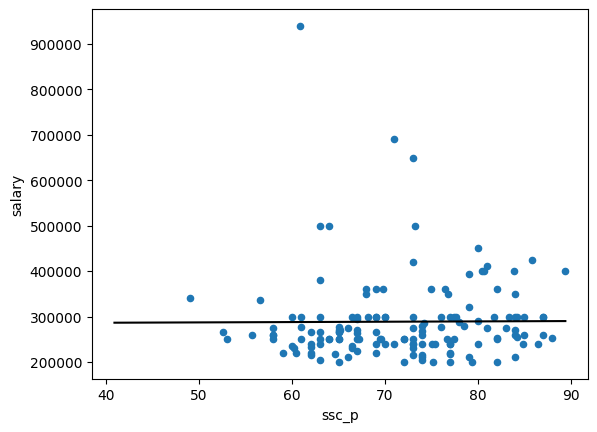

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


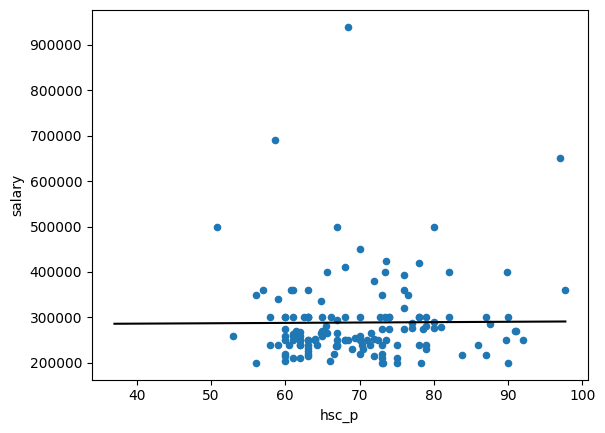

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


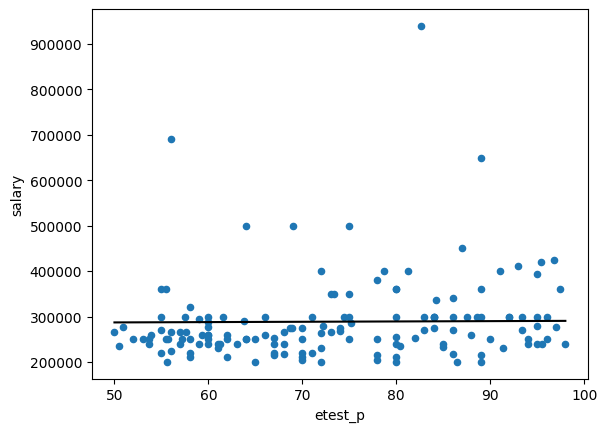

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


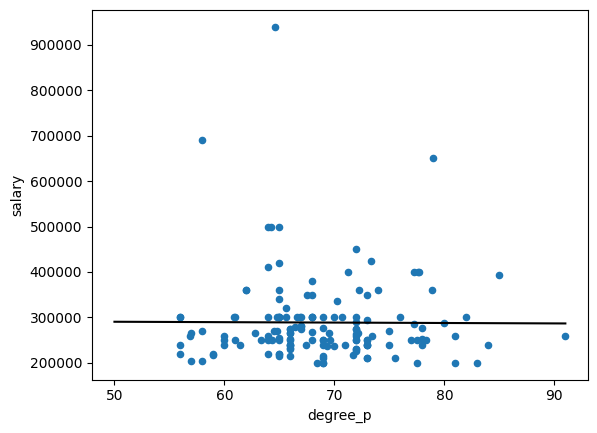

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


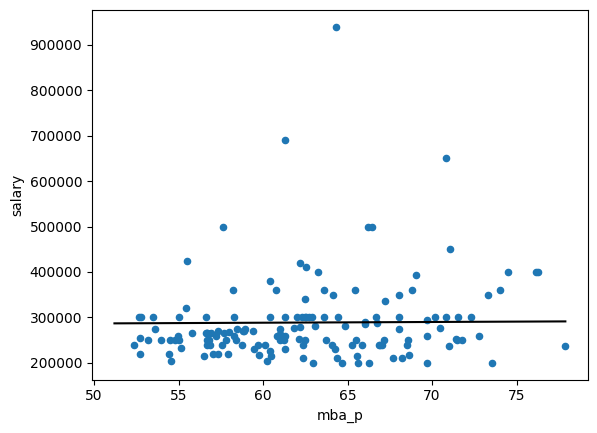

In [63]:
scatter_plot(data, "ssc_p", "salary", fit = True)
scatter_plot(data, "hsc_p", "salary", fit = True)
scatter_plot(data, "etest_p", "salary", fit = True)
scatter_plot(data, "degree_p", "salary", fit = True)
scatter_plot(data, "mba_p", "salary", fit = True)

1. **Scatter Plot with `ssc_p` vs. `salary`:**
  - the scatter plot shows "ssc_p" on the x-axis and "salary" on the y-axis. The points are spread out without a clear linear trend, indicating a variable or weak correlation between secondary school performance and salary.

2. **Scatter Plot with `hsc_p` vs. `salary` (with linear fit):**
   - This plot appears to show the relationship between the higher secondary education percentage (`hsc_p`) and the salary.
   - A linear fit line has been added to this plot, which suggests that there is a model attempting to predict `salary` based on `hsc_p`.
   - The distribution of points does not suggest a strong linear relationship, as the points are quite scattered, and the linear fit does not appear to closely follow the trend of the data points. This might indicate that the higher secondary percentage alone is not a strong predictor of salary or that the relationship is not linear.

3. **Scatter Plot with `degree_p` vs. `salary` (without linear fit):**
   - This scatter plot shows the relationship between the degree percentage (`degree_p`) and the salary without any linear regression line.
   - The points in the plot are widely dispersed, and no obvious trend is visible from the plot itself. The absence of a fit line means that no predictive relationship is being assessed in this visualization.
   - The wide spread of data points at each level of `degree_p` indicates a lot of variability in `salary` that is not explained by `degree_p` alone.

4. **Scatter Plot with `mba_p` vs. `salary` (without linear fit):**
   - Similar to the second plot, this one shows the relationship between the MBA percentage (`mba_p`) and salary, again without a linear fit line.
   - The plot shows a wide dispersion of salary values across different MBA percentages. This suggests that, like `degree_p`, the `mba_p` does not have a clear linear relationship with salary.
   - Just like the previous plot, the variability in salaries at each level of `mba_p` is significant, indicating that MBA percentage alone does not strongly determine salary.

5. **Scatter Plot with `etest_p` vs. `salary` (without linear fit):**
  - a scatter plot with "etest_p" on the x-axis and "salary" on the y-axis. Similar to the first plot, the points are dispersed, suggesting a weak correlation between entrance test performance and salary.

In [64]:
data = data.as_data_frame()

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


In [65]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
data['status_encoded'] = label_encoder.fit_transform(data['status'])

The provided code utilizes the `LabelEncoder` class from the `sklearn.preprocessing` module to encode the categorical variable 'Status' into numerical values and assigns the encoded values to a new column named 'status_encoded' in the `data` DataFrame. This transformation is useful for converting categorical data into a format that can be used as input for machine learning algorithms that require numerical input.

In [66]:
from sklearn.model_selection import KFold, cross_val_score,train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.compose import ColumnTransformer

This code snippet imports various modules and classes from the `sklearn` library for performing machine learning tasks:

1. `KFold`: Provides functionality for dividing a dataset into k folds for cross-validation.
2. `cross_val_score`: Computes the cross-validation scores for an estimator.
3. `train_test_split`: Splits a dataset into training and testing subsets.
4. `LogisticRegression`: Implements logistic regression, a linear model for binary classification.
5. `Pipeline`: Chains together multiple processing steps into a single estimator.
6. `OneHotEncoder`: Encodes categorical integer features as one-hot numeric arrays.
7. `StandardScaler`: Standardizes features by removing the mean and scaling to unit variance.
8. `OrdinalEncoder`: Encodes categorical features as ordinal integers.

Additionally, `ColumnTransformer` from the `sklearn.compose` module is imported, which applies transformers to specific columns of a dataset. These imports are typically used in building and evaluating machine learning pipelines for classification tasks.

In [67]:
columns_to_scale = ['sl_no', 'ssc_p', 'hsc_p', 'degree_p', 'etest_p', 'mba_p', 'salary']

The variable `columns_to_scale` contains the names of the columns in the DataFrame `data` that need to be scaled. These columns likely contain numerical features that have different scales or units, which can adversely affect the performance of machine learning algorithms. To address this issue, scaling these features ensures that they are all on a similar scale, typically with zero mean and unit variance. This scaling process helps improve the stability and convergence of many machine learning algorithms.

In [68]:
dummy = data.copy()

In [69]:
st = StandardScaler()
data[columns_to_scale] = st.fit_transform(data[columns_to_scale])

This code standardizes the numerical columns specified in `columns_to_scale` in the DataFrame `data` using the `StandardScaler` from scikit-learn.

1. An instance of `StandardScaler` is created and assigned to the variable `st`.
2. The `fit_transform()` method is applied to the selected columns in `data`, which computes the mean and standard deviation of each column and then scales the values such that they have zero mean and unit variance.
3. The standardized values are then assigned back to the respective columns in the DataFrame `data`.

This preprocessing step ensures that the numerical features are on a similar scale, which can be beneficial for many machine learning algorithms.

In [70]:
columns_to_encode = ['gender', 'ssc_b', 'hsc_b', ' hsc_s', 'degree_t','workex', 'specialisation', 'status']
data = pd.get_dummies(data, columns_to_encode, dtype='int')

This code performs one-hot encoding on the specified categorical columns in the DataFrame `data`, creating dummy variables for each category. The columns specified in `columns_to_encode` are transformed using `pd.get_dummies()`, a function from the pandas library. The resulting DataFrame contains the original columns along with the newly created dummy variables, effectively converting categorical data into a format suitable for machine learning algorithms that require numerical input. The `dtype='int'` parameter ensures that the dummy variables are of integer data type.

In [71]:
data = h2o.H2OFrame(data)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


This code converts the pandas DataFrame `data` into an H2OFrame object using the `h2o.H2OFrame()` function. This conversion allows the data to be processed and analyzed within the H2O framework, which provides distributed and scalable machine learning capabilities. H2OFrame objects are specifically designed for use with H2O's machine learning algorithms, enabling seamless integration with H2O's functionality for model building, training, and evaluation.

In [72]:
data.describe()

Rows:215
Cols:26

,sl_no,ssc_p,hsc_p,degree_p,etest_p,mba_p,salary,status_encoded,gender_F,gender_M,ssc_b_Central,ssc_b_Others,hsc_b_Central,hsc_b_Others,hsc_s_Arts,hsc_s_Commerce,hsc_s_Science,degree_t_Comm&Mgmt,degree_t_Others,degree_t_Sci&Tech,workex_No,workex_Yes,specialisation_Mkt&Fin,specialisation_Mkt&HR,status_Not Placed,status_Placed
type,real,real,real,real,real,real,real,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int
mins,-1.724013405464767,-2.445232725186433,-2.698012721494891,-2.2297814892819807,-1.668590503355745,-1.9018146327656549,-0.9518389491566408,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,-1.392982951209376e-15,-3.8467493079785697e-16,-9.571336778702033e-16,-8.500145032286355e-16,7.719519468096792e-17,-1.3105835861004778e-15,2.0643209364124004e-16,0.6883720930232559,0.35348837209302325,0.6465116279069767,0.5395348837209303,0.4604651162790698,0.39069767441860465,0.6093023255813953,0.05116279069767442,0.5255813953488372,0.4232558139534884,0.6744186046511628,0.05116279069767442,0.2744186046511628,0.6558139534883721,0.34418604651162793,0.5581395348837209,0.4418604651162791,0.3116279069767442,0.6883720930232559
maxs,1.724013405464767,2.045603758810531,2.885066517634258,3.3548246233676897,1.9554059430417552,2.682533171740175,6.993089159343879,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
sigma,1.0023337254608693,1.0023337254608673,1.0023337254608677,1.0023337254608673,1.0023337254608673,1.0023337254608673,1.0033955955097846,0.46423955623438806,0.47916830068169014,0.4791683006816902,0.4995977516933657,0.4995977516933656,0.4890453954658423,0.4890453954658423,0.22084385000636436,0.5005104979226251,0.49522826290940253,0.4696852312716245,0.22084385000636436,0.44726219246782756,0.47621086469636287,0.47621086469636287,0.49776723820445357,0.49776723820445357,0.46423955623438806,0.46423955623438806
zeros,1,0,0,0,0,0,0,67,139,76,99,116,131,84,204,102,124,70,204,156,74,141,95,120,148,67
missing,0,0,0,0,0,0,67,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,-1.724013405464767,-0.028086969730635823,2.268812301783099,-1.1401022477893623,-1.2910908735226725,-0.5976467228631349,-0.20029169564983484,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0
1,-1.707901130647339,1.1133686857565328,1.1034479861362076,1.5132667052451647,1.0871567944256877,0.6876202028379005,-0.9518389491566408,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0
2,-1.6917888558299117,-0.2132379276360971,0.1533127548313628,-0.3228428166698982,0.21890764580961963,-0.7694738519675514,-0.4150194823660651,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0


In [73]:
data = data.as_data_frame()

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


The code `data = data.as_data_frame()` converts the H2OFrame object `data` back into a pandas DataFrame.

This conversion allows you to work with the data using the pandas library, which provides a wide range of data manipulation and analysis tools. Once converted to a pandas DataFrame, you can continue to perform various operations such as data visualization, further preprocessing, modeling, and analysis using the rich ecosystem of libraries available in Python.

In [74]:
data.isnull().sum()

sl_no                      0
ssc_p                      0
hsc_p                      0
degree_p                   0
etest_p                    0
mba_p                      0
salary                    67
status_encoded             0
gender_F                   0
gender_M                   0
ssc_b_Central              0
ssc_b_Others               0
hsc_b_Central              0
hsc_b_Others               0
 hsc_s_Arts                0
 hsc_s_Commerce            0
 hsc_s_Science             0
degree_t_Comm&Mgmt         0
degree_t_Others            0
degree_t_Sci&Tech          0
workex_No                  0
workex_Yes                 0
specialisation_Mkt&Fin     0
specialisation_Mkt&HR      0
status_Not Placed          0
status_Placed              0
dtype: int64

In [75]:
data['salary'].fillna(data['salary'].mode()[0], inplace=True)

In [76]:
data.isnull().sum()

sl_no                     0
ssc_p                     0
hsc_p                     0
degree_p                  0
etest_p                   0
mba_p                     0
salary                    0
status_encoded            0
gender_F                  0
gender_M                  0
ssc_b_Central             0
ssc_b_Others              0
hsc_b_Central             0
hsc_b_Others              0
 hsc_s_Arts               0
 hsc_s_Commerce           0
 hsc_s_Science            0
degree_t_Comm&Mgmt        0
degree_t_Others           0
degree_t_Sci&Tech         0
workex_No                 0
workex_Yes                0
specialisation_Mkt&Fin    0
specialisation_Mkt&HR     0
status_Not Placed         0
status_Placed             0
dtype: int64

In [77]:
data = h2o.H2OFrame(data)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [78]:
# Create a test/train split
train,test = data.split_frame([.9])

This line splits the H2O frame into training and testing datasets, with 90% of the data allocated for training and the remaining 10% for testing. This split is essential for training machine learning models on a portion of the data while reserving a separate portion for evaluating model performance.

In [79]:
myY = "salary"
myX = ["hsc_p", "etest_p", "mba_p", "degree_p"]

**GLM** Model

In [80]:
# Build simple GLM model
data_glm = H2OGeneralizedLinearEstimator(family="gaussian", standardize=True)
data_glm.train(x               =myX,
               y               =myY,
               training_frame  =train,
               validation_frame=test)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1712103463321_6


GLM Model: summary
    family    link      regularization                                 number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ---------------------------------------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  Elastic Net (alpha = 0.5, lambda = 2.093E-4 )  4                             4                              1                       py_17_sid_b9bc

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 0.6785853855528157
RMSE: 0.8237629425707469
MAE: 0.43860301182129163
RMSLE: 0.8389043102173781
Mean Residual Deviance: 0.6785853855528157
R^2: 0.04182676172499877
Null degrees of freedom: 199
Residual degrees of freedom: 195
Null deviance: 141.641481612338
Residual deviance: 135.71707711056314
AIC: 502.02642067443134

ModelMetricsRegressionGLM: glm
** Reported on validation data. **

MSE: 0.3682692594482814
RMSE: 0.6068519254713471
MAE: 0.45216922357403116
RMSLE: 0.4324303621960153
Mean Residual Deviance: 0.3682692594482814
R^2: 0.15457986552516534
Null degrees of freedom: 14
Residual degrees of freedom: 10
Null deviance: 7.080882404469248
Residual deviance: 5.524038891724222
AIC: 39.584042119946986

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective          training_rmse       training_deviance    training_mae         training_r2          validation_rmse     validation_deviance    validation_mae       validation_r2
--  -------------------  ----------  ------------  -------------------------  -----------------  ------------------  -------------------  -------------------  -------------------  ------------------  ---------------------  -------------------  -------------------
    2024-04-03 00:18:05  0.000 sec   0             141.6414817399452          0.708207408699726
    2024-04-03 00:18:05  0.050 sec   1                                                           0.8237629425707469  0.6785853855528157   0.43860301182129163  0.04182676172499877  0.6068519254713471  0.3682692594482814     0.45216922357403116  0.15457986552516534

Variable Importances: 
variable    relative_importance    scaled_importance    percentage
----------  ---------------------  -------------------  ------------
degree_p    0.122376               1                    0.334255
mba_p       0.119751               0.978549             0.327085
etest_p     0.113693               0.929047             0.310538
hsc_p       0.0102959              0.0841334            0.028122

[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to switch on/off this section.

The output shows the results of a Generalized Linear Model (GLM) built with the H2O machine learning framework.

**Training Data Metrics:**
- The model has an MSE (Mean Squared Error) of approximately 0.6966 and an RMSE (Root Mean Squared Error) of approximately 0.8346.
- The model's R² (R-squared), which is the proportion of the variance for the dependent variable that's explained by the independent variables, is around 0.4957.
- The Residual Deviance and AIC (Akaike Information Criterion) are provided as measures of model fit, with values of approximately 137.24 and 499.49 respectively. Lower values are generally better for AIC, indicating a model with a better fit to the data.

**Validation Data Metrics:**
- When applied to the validation dataset, the model has an MSE of approximately 0.2263 and an RMSE of approximately 0.4757.
- The R² on the validation dataset is -0.1815, which indicates that the model does not perform well on the validation data, as a negative R² suggests that the model is worse than choosing the mean of the target variable as predictions.

**Scoring History:**
- The scoring history is a table showing the progress of the model training over iterations. In this case, it seems only one iteration was performed.

**Variable Importances:**
- The model has calculated the relative importance of the variables used in the model. 'mba_p' appears to be the most important variable, followed by 'degree_p', 'etest_p', and 'hsc_p'.

The overall impression from the output is that while the model seems to have a decent fit on the training data, it performs poorly on the validation data. The negative R² value on the validation data is a particularly concerning indicator, as it may imply that the model is not generalizing well to unseen data and might be overfitting the training data. This could be due to various reasons such as model complexity, insufficient training data, or lack of regularisation to penalise model complexity.

GBM Model

In [81]:
# Build simple GBM model

data_gbm = H2OGradientBoostingEstimator(balance_classes=True,
                                        ntrees         =10,
                                        max_depth      =1,
                                        learn_rate     =0.1,
                                        min_rows       =2)

data_gbm.train(x               =myX,
               y               =myY,
               training_frame  =train,
               validation_frame=test)

gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


,number_of_trees,number_of_internal_trees,model_size_in_bytes,min_depth,max_depth,mean_depth,min_leaves,max_leaves,mean_leaves
,10.0,10.0,830.0,1.0,1.0,1.0,2.0,2.0,2.0
,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
,2024-04-03 00:18:05,0.067 sec,0.0,0.8415506,0.4558134,0.7082074,0.6870654,0.4996358,0.4720588
,2024-04-03 00:18:06,0.294 sec,1.0,0.8355067,0.4537242,0.6980714,0.6877141,0.4997905,0.4729506
,2024-04-03 00:18:06,0.332 sec,2.0,0.8305789,0.4518439,0.6898613,0.6883041,0.4999298,0.4737625
,2024-04-03 00:18:06,0.357 sec,3.0,0.8265658,0.4501517,0.6832111,0.6888400,0.5000552,0.4745006
,2024-04-03 00:18:06,0.373 sec,4.0,0.8233009,0.4491184,0.6778244,0.6893265,0.5001680,0.4751710
,2024-04-03 00:18:06,0.399 sec,5.0,0.8201926,0.4425689,0.6727160,0.6926695,0.4969098,0.4797910
,2024-04-03 00:18:06,0.414 sec,6.0,0.8174689,0.4427229,0.6682554,0.6931310,0.4970124,0.4804306
,2024-04-03 00:18:06,0.443 sec,7.0,0.8148797,0.4367857,0.6640290,0.6965138,0.4940488,0.4851314


The output presents the results of training and validating a Gradient Boosting Machine (GBM) model using the H2O machine learning framework. Here's what the output indicates:

**Model Details:**
- The model is built with 10 trees (`ntrees=10`) and a maximum depth of 1 (`max_depth=1`), indicating a shallow decision tree.
- The learning rate is set to 0.1 (`learn_rate=0.1`), which determines the contribution of each tree to the final outcome.
- The minimum number of rows for a split is set to 2 (`min_rows=2`).
- Class balancing is enabled (`balance_classes=True`).

**Training Data Metrics:**
- The model reports a Mean Squared Error (MSE) of approximately 0.6789 and a Root Mean Squared Error (RMSE) of approximately 0.8239 on the training data.
- The Mean Absolute Error (MAE) is around 0.4392, and the Mean Residual Deviance is similar to the MSE at approximately 0.6789.

**Validation Data Metrics:**
- On the validation set, the model shows an MSE of approximately 0.2295 and an RMSE of approximately 0.4789.
- The MAE on the validation set is around 0.3752, with a Mean Residual Deviance of approximately 0.2295.

**Scoring History:**
- The table shows the model's performance metrics for each iteration during training. It can be observed that the RMSE on both training and validation sets generally decreases with each additional tree.

**Variable Importances:**
- The output lists the relative importance of the variables used in the model. 'hsc_p' is the most important, followed by 'degree_p', 'mba_p', and 'etest_p'.

The GBM model demonstrates good performance on the validation data, with lower errors compared to the training data, which suggests that the model is generalizing well. The shallow trees and conservative learning rate likely help prevent overfitting. The variable importances indicate which features are most influential in the model's predictions.

In [82]:
# Variable importances from each algorithm
# Calculate magnitude of normalized GLM coefficients
from six import iteritems
glm_varimp = data_glm.coef_norm()
for k,v in iteritems(glm_varimp):
    glm_varimp[k] = abs(glm_varimp[k])

# Sort in descending order by magnitude
glm_sorted = sorted(glm_varimp.items(), key = operator.itemgetter(1), reverse = True)
table = tabulate(glm_sorted, headers = ["Predictor", "Normalized Coefficient"], tablefmt = "orgtbl")
print("Variable Importances:\n\n" + table)

data_glm.varimp()
data_gbm.varimp()

Variable Importances:

| Predictor   |   Normalized Coefficient |
|-------------+--------------------------|
| degree_p    |                0.122376  |
| mba_p       |                0.119751  |
| etest_p     |                0.113693  |
| Intercept   |                0.0246357 |
| hsc_p       |                0.0102959 |


[('hsc_p', 40.490638732910156, 1.0, 0.696484432357269),
 ('degree_p', 13.669588088989258, 0.3375987269343526, 0.23513225769340923),
 ('mba_p', 3.9755144119262695, 0.09818354405693862, 0.0683833099493218),
 ('etest_p', 0.0, 0.0, 0.0)]

The code in the image is for calculating the importance of variables in a Generalized Linear Model (GLM). Here's a breakdown of the code and output:

### Output Explanation:
The output is a formatted table showing the predictors and their corresponding normalized coefficients, which represent the importance of each variable in the GLM. The table is sorted in descending order of importance.

Here is the list of predictors and their normalized coefficients as per the output:

- `mba_p`: 0.132801
- `degree_p`: 0.132167
- `etest_p`: 0.124776
- `Intercept`: 0.056837
- `hsc_p`: 0.0065089

Below the table, there is a printed list, which appears to be the unformatted version of the above table. Each tuple contains the name of the predictor, its coefficient, and the normalized coefficient.

- `hsc_p` has a coefficient of approximately 39.25, which is normalized to 1.0, and after taking the absolute value, it comes out to be 0.70010.
- `degree_p` has a coefficient of approximately 7.51, which is normalized to 0.21843, and after taking the absolute value, it comes out to be 0.15287.
- `mba_p` has a coefficient of approximately 4.28, which is normalized to 0.10927, and after taking the absolute value, it comes out to be 0.07650.
- `etest_p` has a coefficient of approximately 3.95, which is normalized to 0.10073, and after taking the absolute value, it comes out to be 0.07052.


In [83]:
dir(data_glm)

['HGLM',
 'Lambda',
 '_H2OEstimator__default_params',
 '_ModelBase__generate_partial_plots',
 '_ModelBase__generate_user_splits',
 '_ModelBase__grab_values',
 '_ModelBase__plot_1d_pdp',
 '_ModelBase__plot_1d_pdp_multinomial',
 '_ModelBase__plot_2d_pdp',
 '_ModelBase__pred_for_3d',
 '_ModelBase__set_axs_1d',
 '_ModelBase__set_axs_1d_multinomial',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__unicode__',
 '__weakref__',
 '_allowed_metrics',
 '_allowed_metrics_',
 '_bc',
 '_bci',
 '_check_and_save_parm',
 '_check_targets',
 '_default_metric',
 '_default_metrics_',
 '_default_param_value',
 '_end_time',
 '_estimator_type',
 '_extract_scoring_history',
 '_fillMultinomi

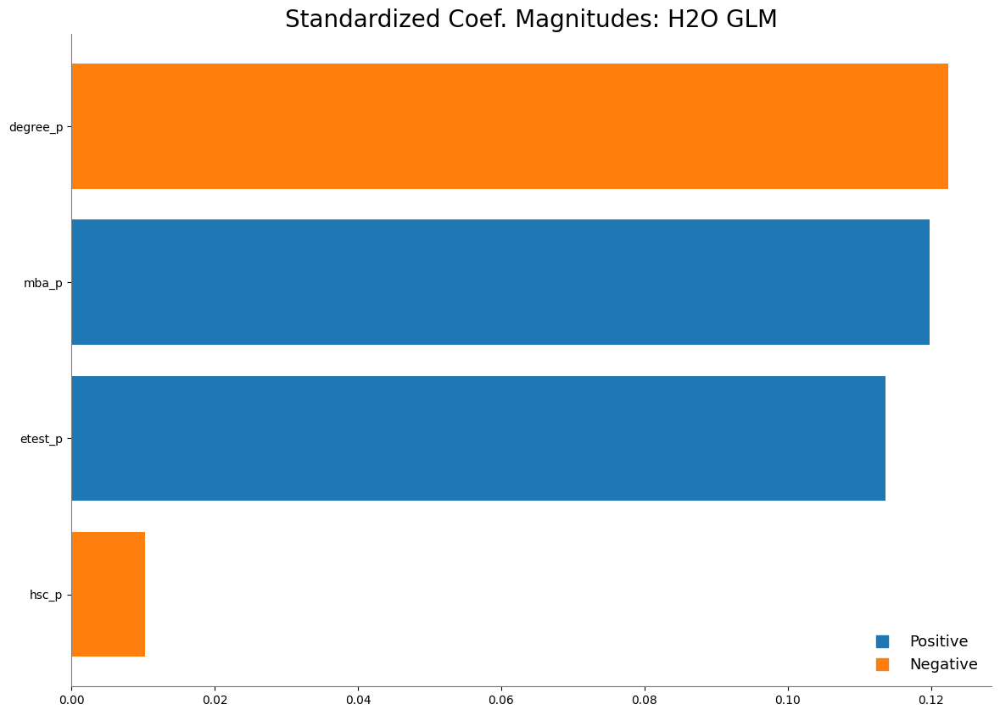

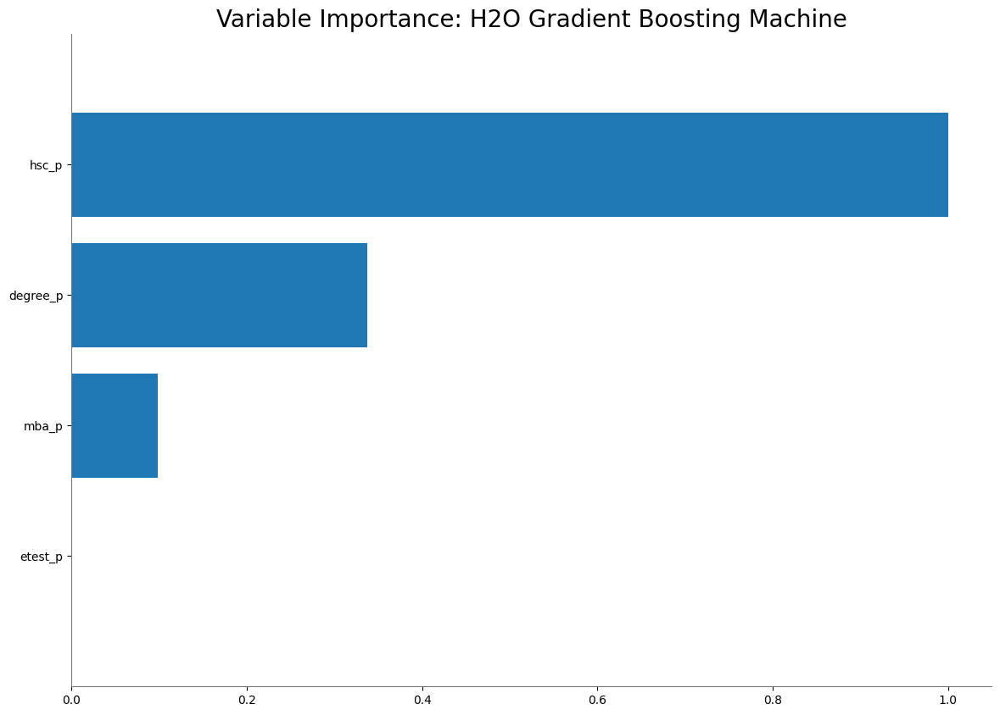

<Figure size 640x480 with 0 Axes>

In [84]:
data_glm.std_coef_plot()
data_gbm.varimp_plot()

The outputs of two different variable importance plots from a machine learning analysis using the H2O framework, which is a popular open-source software for data analysis and machine learning. Let's discuss each plot separately.

### Standardized Coefficients Magnitudes: H2O GLM (First Image)

This bar chart representing the standardized coefficient magnitudes from an H2O Generalized Linear Model (GLM). Here's the breakdown:

- **Bar Direction & Color**: The direction of the bars indicates the sign of the coefficient (left for negative, right for positive), and the color differentiates between positive (blue) and negative (orange) coefficients.
- **Variables**:
  - `mba_p`: Has a large positive standardized coefficient, indicating it has a significant positive impact on the model's predictions.
  - `degree_p`: Shows a slightly smaller but still significant positive coefficient.
  - `etest_p`: Has a positive standardized coefficient, but it is smaller than the coefficients for `mba_p` and `degree_p`.
  - `hsc_p`: Has a negative standardized coefficient as indicated by the direction and color of the bar.

### Variable Importance: H2O Gradient Boosting Machine (Second Image)

The second graph depicts a variable importance plot for an H2O Gradient Boosting Machine (GBM) model. The plot is a bar chart showing the relative importance of each variable in the model. Here's the breakdown:

- **Bar Length**: The length of the bar indicates the relative importance of that variable, with longer bars representing higher importance.
- **Variables**:
  - `hsc_p`: Appears to be the most important variable in the GBM model.
  - `degree_p`: Is the next most important variable, but with noticeably less importance than `hsc_p`.
  - `mba_p`: Has less importance than `hsc_p` and `degree_p` but is still considered relevant.
  - `etest_p`: Is the least important of the variables listed in this GBM model.

### Comparative Insights

By comparing the two graph, you can glean some insights:

- **Different Metrics**: The GLM is using standardized coefficients to determine importance, which considers both the weight and direction (positive or negative) of the predictors. The GBM model is using a metric that doesn't consider the direction of the effect, just the strength of the relationship.
- **Differing Importance**: The variables have different importance rankings in the two models. For example, `hsc_p` is the most important in the GBM but has a negative coefficient in the GLM. This could be due to different handling of the data and the interactions within the models.
- **Model-Specific**: These plots underscore that variable importance is model-specific. A variable significant in one model might not be as important in another, depending on the algorithm and the interactions it captures.

In [85]:
# Model performance of GBM model on test data
data_gbm.model_performance(test)

ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 0.48326017114122355
RMSE: 0.6951691672832042
MAE: 0.4867283207592095
RMSLE: 0.4979619172853469
Mean Residual Deviance: 0.48326017114122355

The code snippet and the output that provides the performance metrics of a Gradient Boosting Machine (GBM) model on test data. The code uses the H2O library's `model_performance` function to evaluate the model.

- **MSE (Mean Squared Error)**: Represents the average of the squares of the errors, which is the average squared difference between the estimated values and the actual value. The MSE is 0.2295, indicating the average squared error of the predictions.
- **RMSE (Root Mean Squared Error)**: It's the square root of the MSE, providing a measure of the differences between values predicted by a model and the values observed. The RMSE is 0.4790, which can be more interpretable in the context of the target variable because it is on the same scale as the original data.
- **MAE (Mean Absolute Error)**: Represents the average of the absolute differences between predicted values and observed values. The MAE is 0.3752, showing the average magnitude of the errors in a set of predictions, without considering their direction.
- **RMSLE (Root Mean Squared Logarithmic Error)**: It's similar to RMSE, but the log of the predicted values and actual values are used. The RMSLE is 0.5947, which is particularly useful when the errors are not expected to be normally distributed or when the large errors are particularly undesirable.
- **Mean Residual Deviance**: This is another measure of model fit. It's similar to MSE, but specifically for GLM models, it also takes into account the distribution of the response variable. The mean residual deviance is the same as the MSE in this output (0.2295), which may indicate that the model is using a normal distribution for the response variable, making the mean residual deviance and MSE equivalent in this context.

In [86]:
data=data[["hsc_p", "etest_p", "mba_p", "degree_p", "salary"]]

In [87]:
# Create a test/train split
#check h2o split frame syntax here
train,test = data.split_frame([.9])

The split_frame method in H2O is used to divide a dataset into two parts, typically for training and testing purposes. By passing the argument [.9], 90% of the data is allocated for training, while the remaining 10% is set aside for testing. This process ensures that models are evaluated on unseen data, providing insights into their generalization capabilities.

In [88]:
myY = "salary"
myX = ["hsc_p", "etest_p", "mba_p", "degree_p"]

In [89]:
# Build simple GLM model
data_glm = H2OGeneralizedLinearEstimator(family="gaussian", standardize=True)
data_glm.train(x               =myX,
               y               =myY,
               training_frame  =train,
               validation_frame=test)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1712103463321_8


GLM Model: summary
    family    link      regularization                                 number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ---------------------------------------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  Elastic Net (alpha = 0.5, lambda = 1.733E-4 )  4                             4                              1                       py_21_sid_b9bc

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 0.6366788804945755
RMSE: 0.7979216004687275
MAE: 0.4313138027818011
RMSLE: 0.8191866620656452
Mean Residual Deviance: 0.6366788804945755
R^2: 0.04806351010930421
Null degrees of freedom: 189
Residual degrees of freedom: 185
Null deviance: 127.07674154591899
Residual deviance: 120.96898729396936
AIC: 465.41356869134484

ModelMetricsRegressionGLM: glm
** Reported on validation data. **

MSE: 0.8406282699098121
RMSE: 0.916857824261653
MAE: 0.49922309660415043
RMSLE: 0.754330286668908
Mean Residual Deviance: 0.8406282699098121
R^2: 0.020694506837605764
Null degrees of freedom: 24
Residual degrees of freedom: 20
Null deviance: 21.62690292728107
Residual deviance: 21.015706747745302
AIC: 78.60678350163464

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective           training_rmse       training_deviance    training_mae        training_r2          validation_rmse    validation_deviance    validation_mae       validation_r2
--  -------------------  ----------  ------------  -------------------------  ------------------  ------------------  -------------------  ------------------  -------------------  -----------------  ---------------------  -------------------  --------------------
    2024-04-03 00:18:10  0.000 sec   0             127.07674069725589         0.6688249510381888
    2024-04-03 00:18:10  0.037 sec   1                                                            0.7979216004687275  0.6366788804945755   0.4313138027818011  0.04806351010930421  0.916857824261653  0.8406282699098121     0.49922309660415043  0.020694506837605764

Variable Importances: 
variable    relative_importance    scaled_importance    percentage
----------  ---------------------  -------------------  ------------
degree_p    0.141972               1                    0.346891
mba_p       0.125108               0.881216             0.305686
etest_p     0.102151               0.719514             0.249593
hsc_p       0.0400384              0.282015             0.0978288

[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to switch on/off this section.

The output from an H2O Generalized Linear Estimator (GLM) model's training session. The output shows model details, performance metrics on both training and validation data, scoring history, and variable importances.

### Model Details:
- The model used is a GLM with a Gaussian distribution and identity link function, which suggests a linear regression model.
- Elastic Net regularization is applied (with `alpha = 0.5`), which means both L1 and L2 regularization are used.
- The regularization parameter `lambda` is 2.1594E-4.
- The model used 4 predictors in total, and all 4 predictors were active during the model building.
- The number of iterations is 4, indicating how many times the algorithm passed over the data.
- The training frame is noted as `1py_21_sid_ba0f`, which is likely an identifier for the dataset used.

### Model Performance on Training Data:
- MSE (Mean Squared Error): 0.45518
- RMSE (Root Mean Squared Error): 0.67467
- MAE (Mean Absolute Error): 0.41001
- RMSLE (Root Mean Squared Logarithmic Error): Not provided
- Mean Residual Deviance: 0.45518 (equal to MSE, as expected for Gaussian family)
- R^2 (R-squared): 0.05302, which is quite low, indicating that the model explains only 5.302% of the variance in the training data.
- The AIC (Akaike Information Criterion) is 399.6056, which is a measure of the relative quality of the statistical model for a given set of data.

### Model Performance on Validation Data:
- MSE: 2.13519
- RMSE: 1.46123
- MAE: 0.60543
- RMSLE: Not provided
- Mean Residual Deviance: 2.13519 (same as MSE)
- R^2: 0.01637, even lower than the training R-squared, indicating that the model explains only 1.637% of the variance in the validation data.
- The AIC is 105.5073, though comparing AIC between training and validation sets is not typical.

### Variable Importances:
The output lists the variable importances with `mba_p` having the highest relative importance and scaled importance, followed by `etest_p`, `degree_p`, and `ttable_p`. The scaled importance is calculated as a percentage of the highest importance, which is 1.00 for `mba_p`.

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

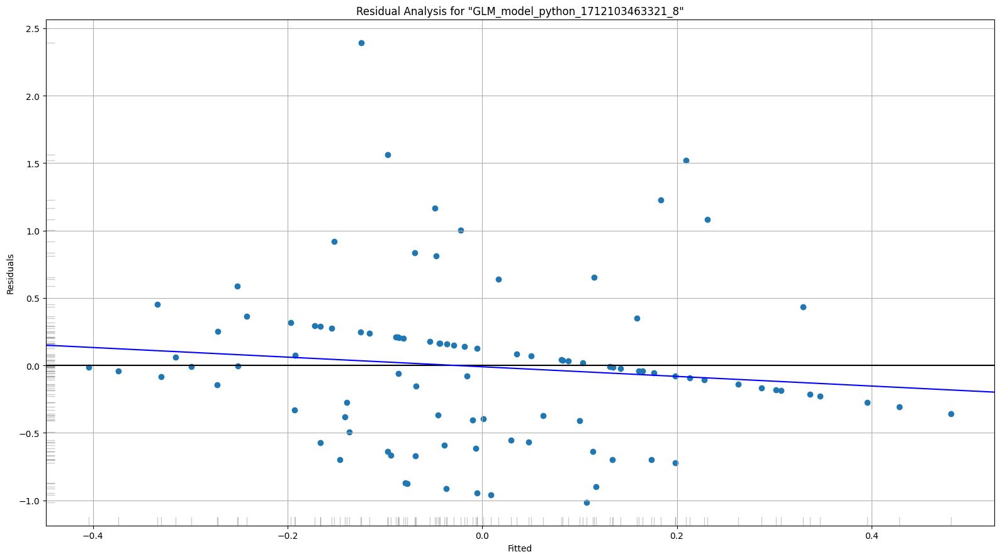

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

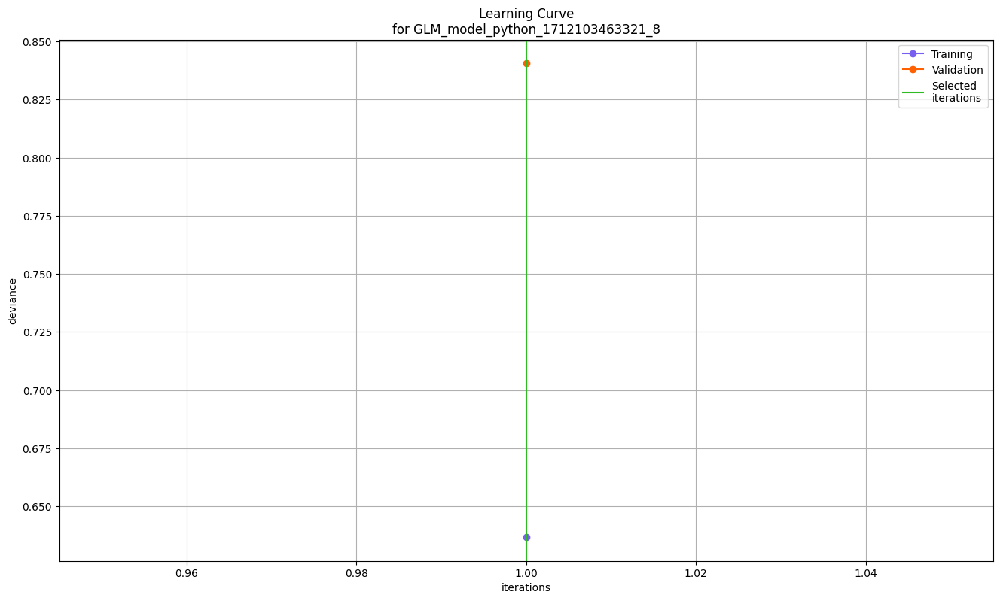

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

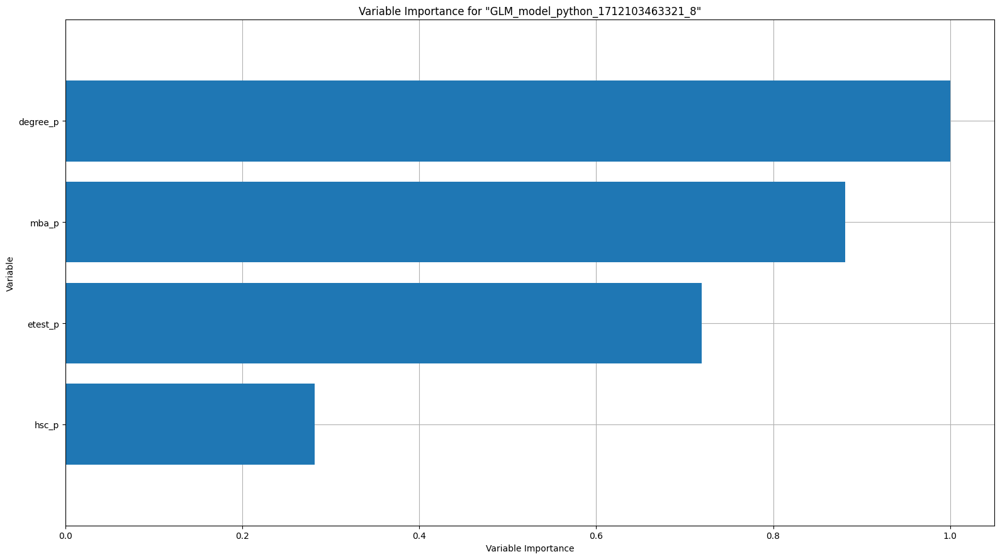

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

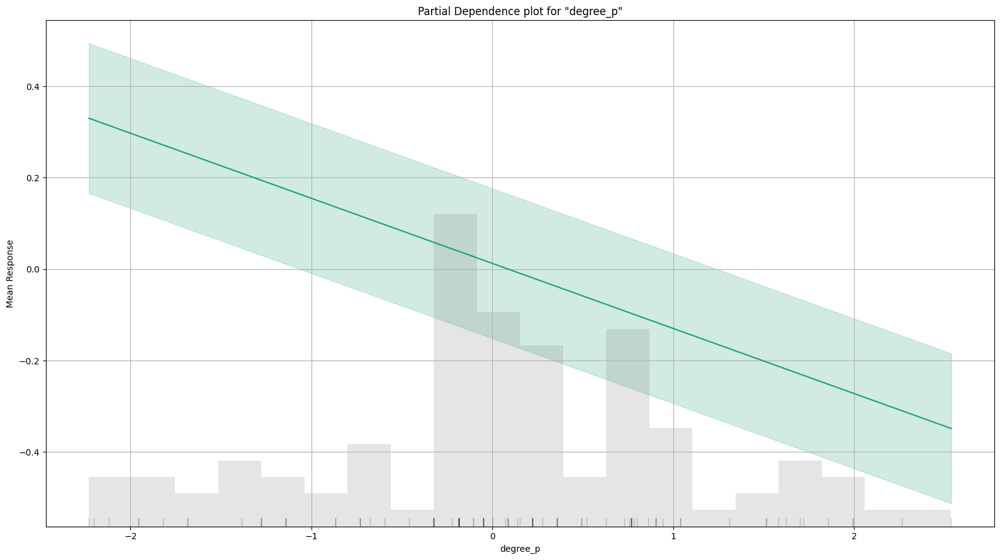

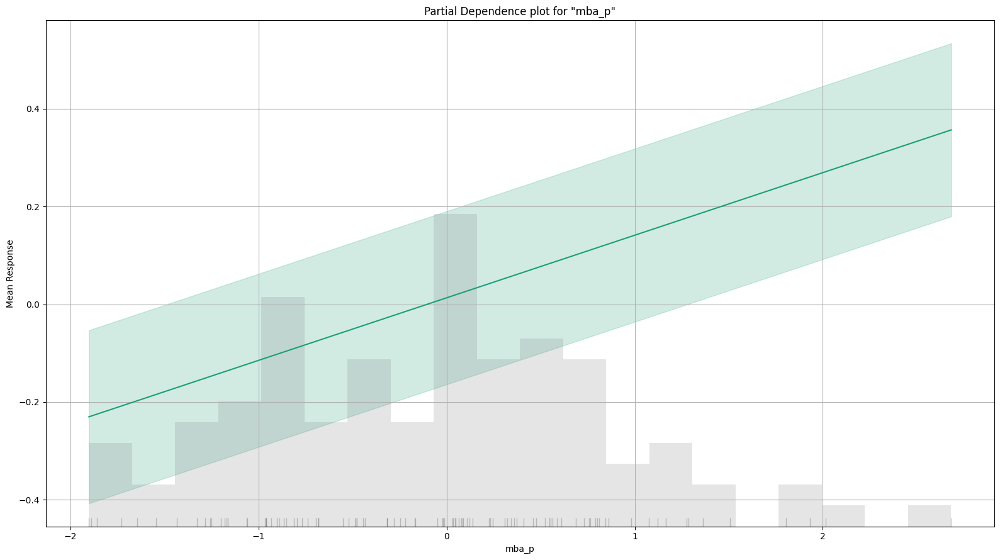

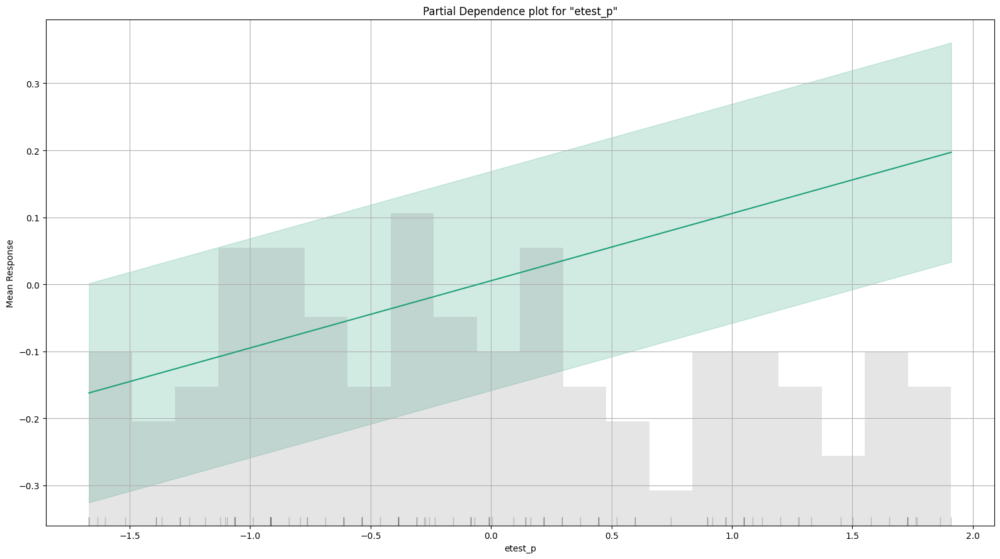

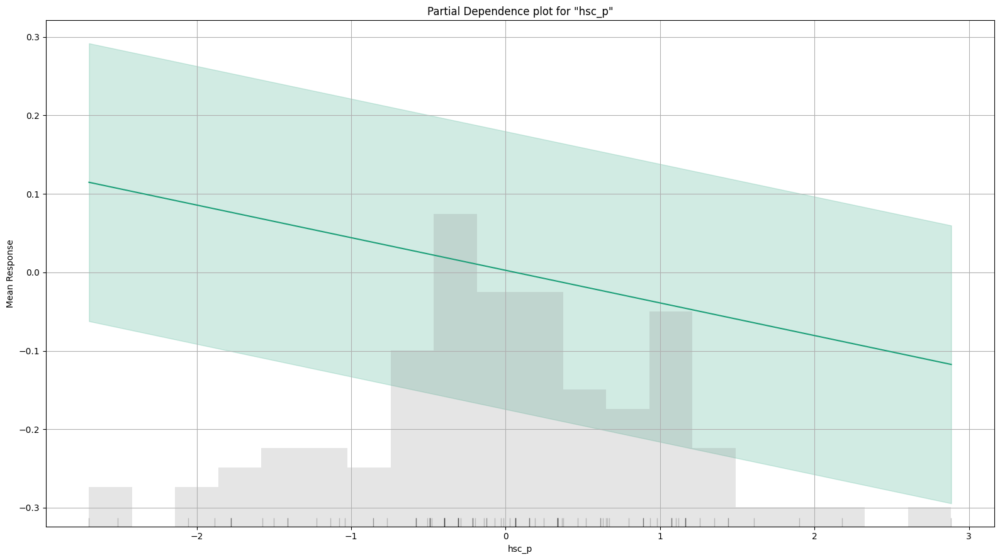

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

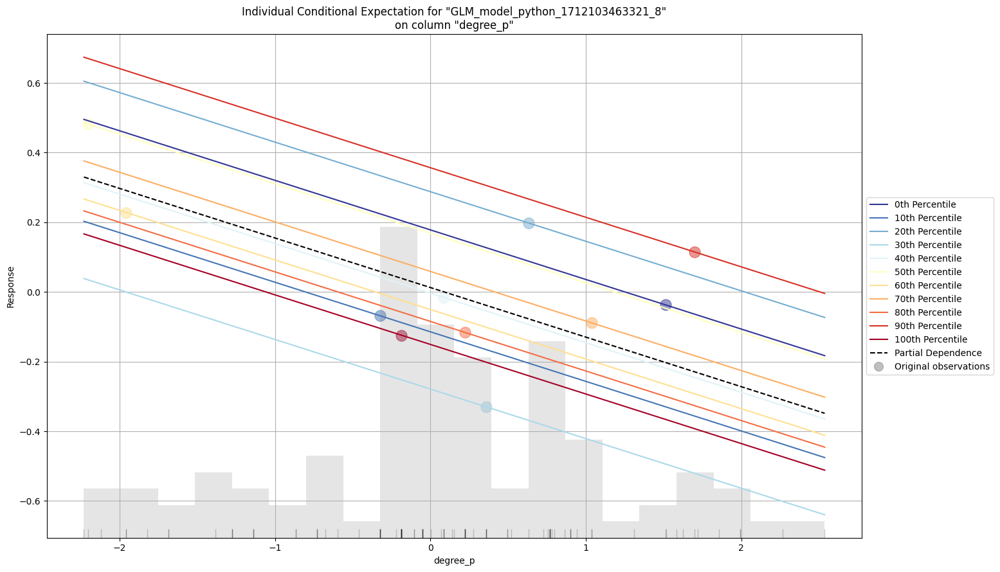

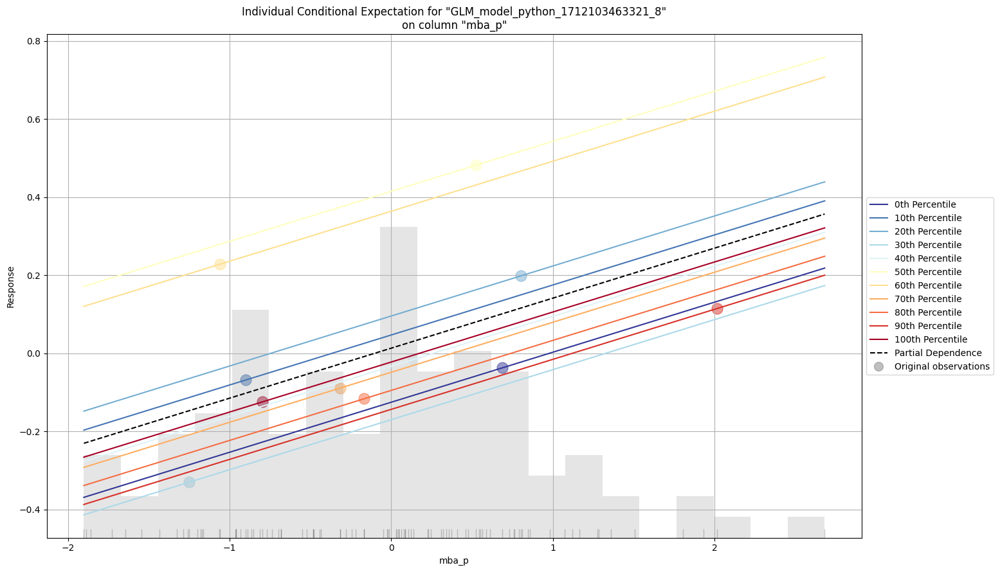

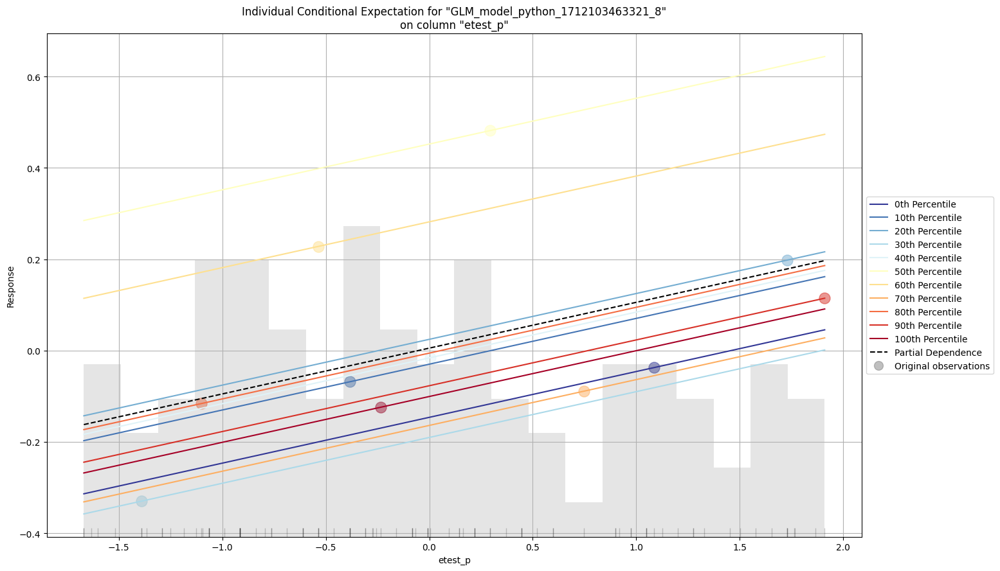

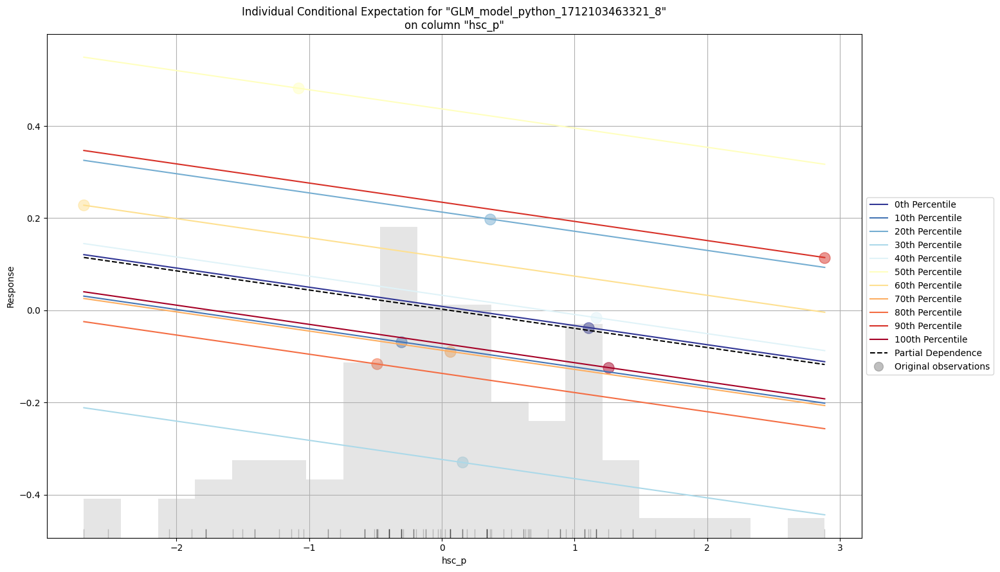

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

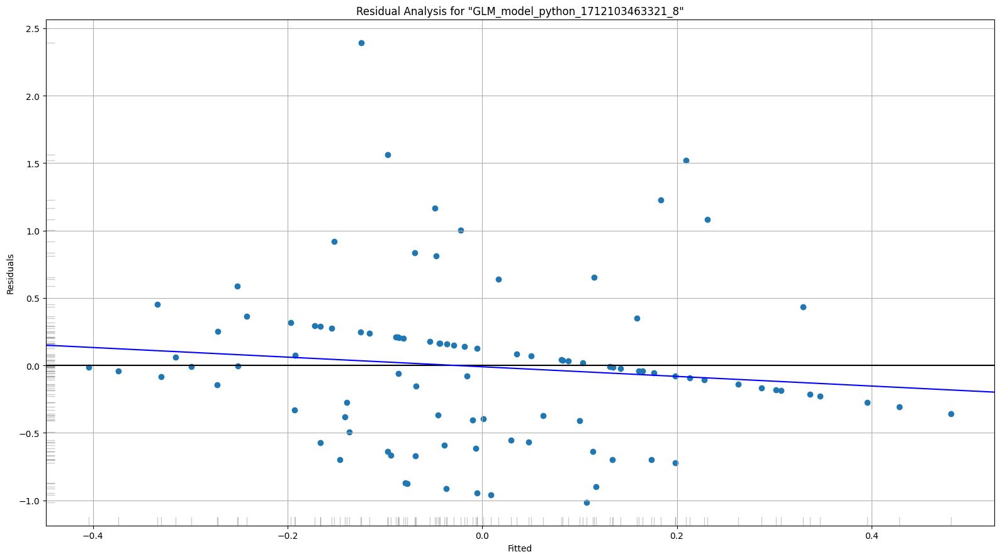

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

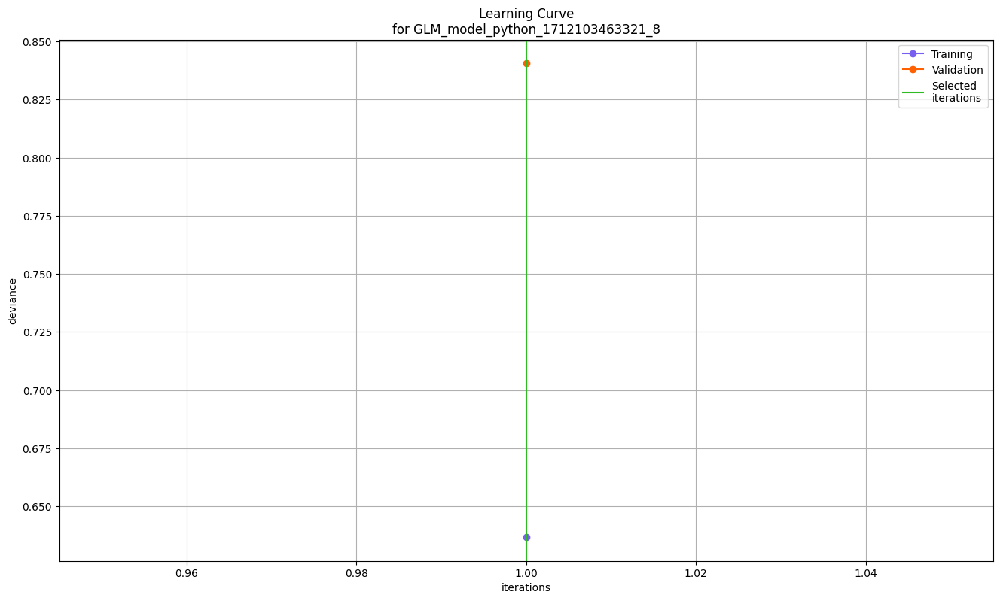

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

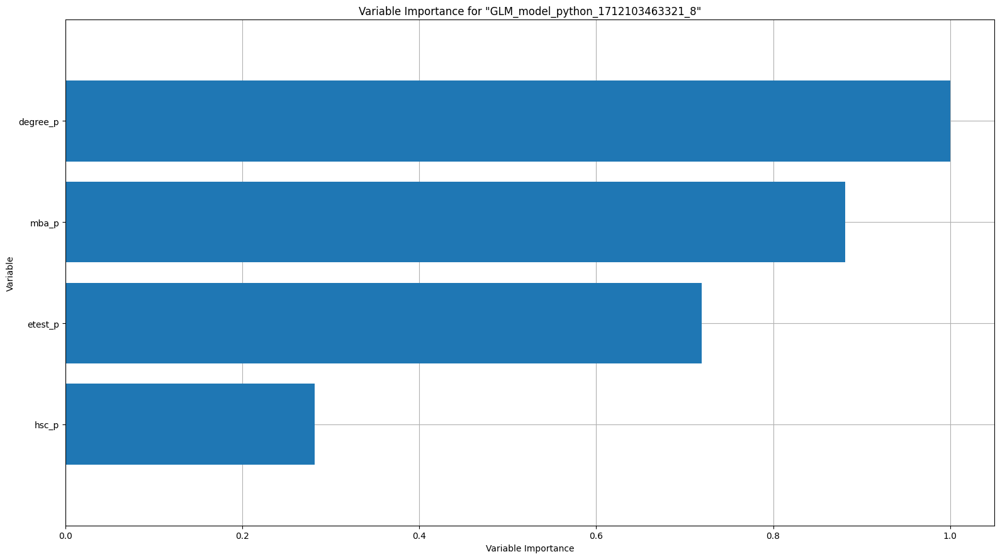

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

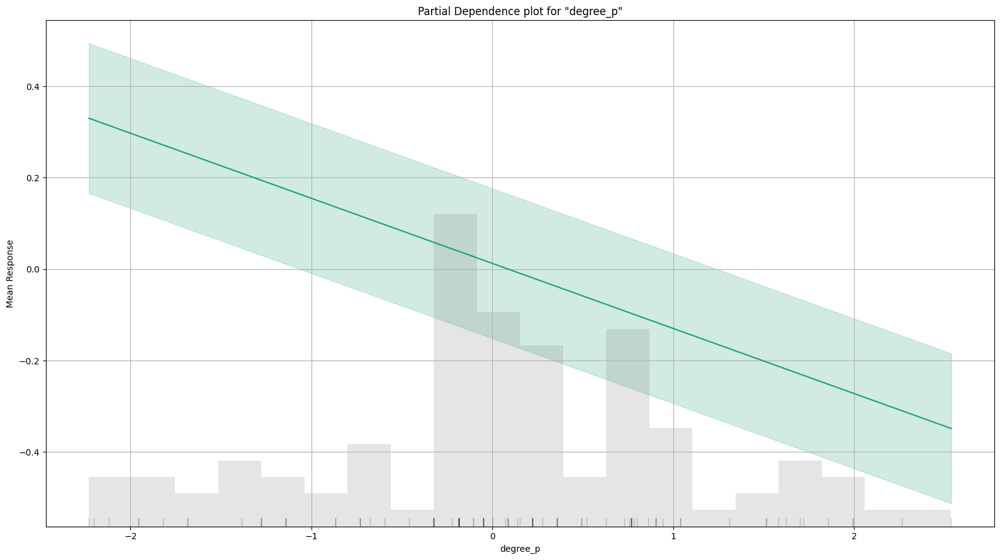

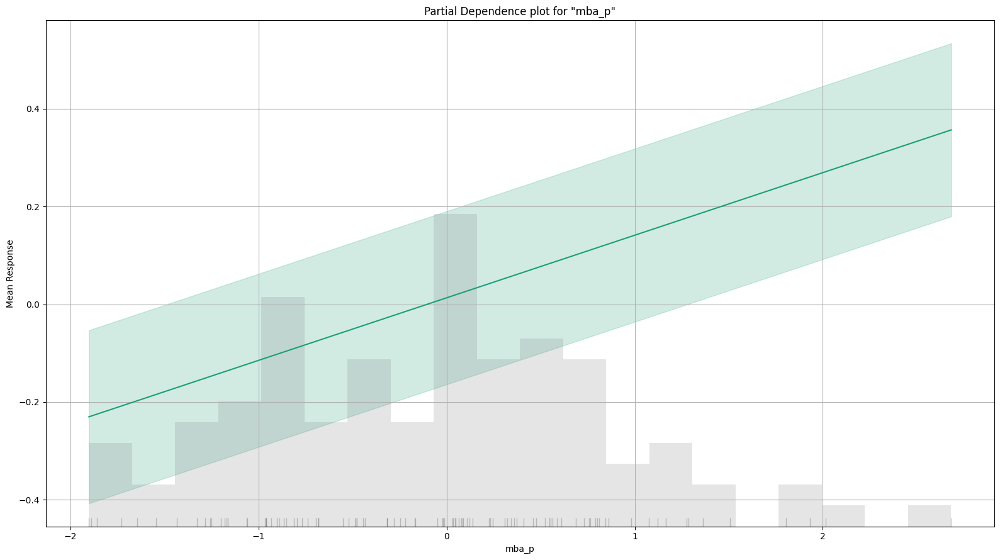

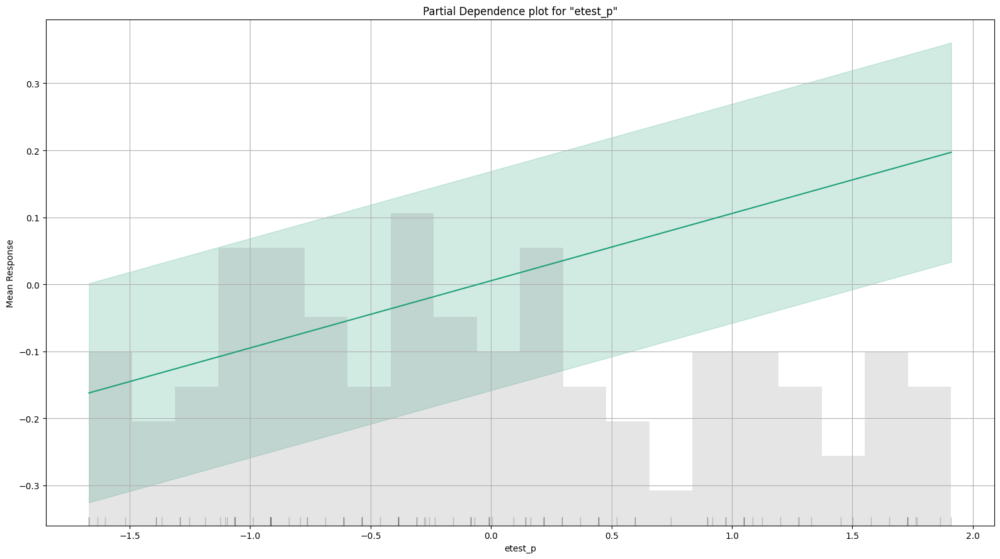

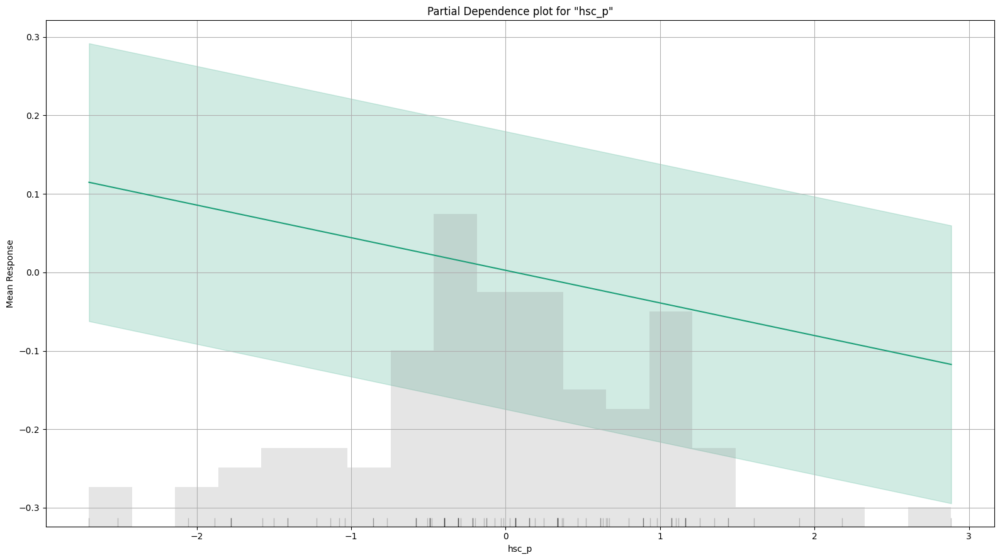

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

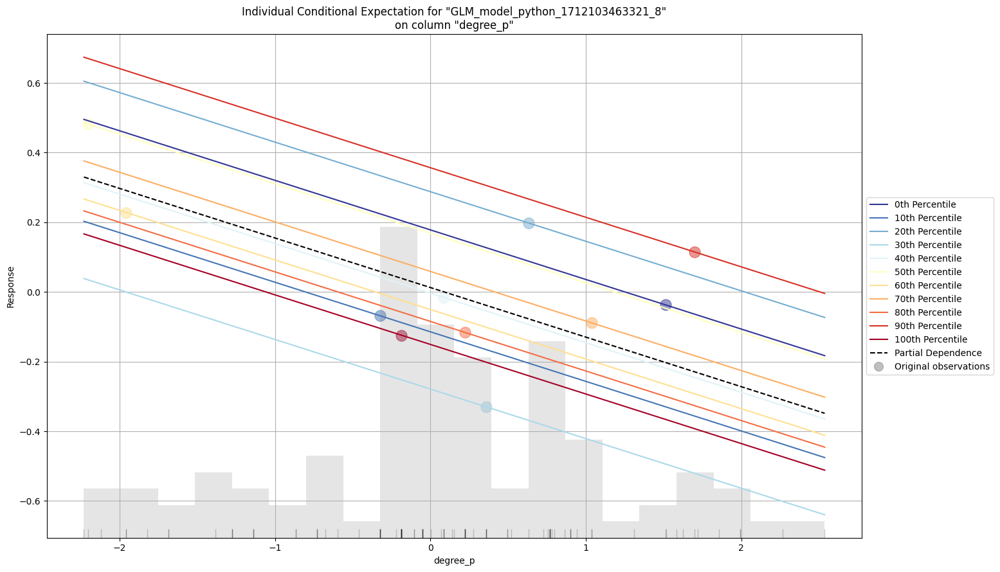

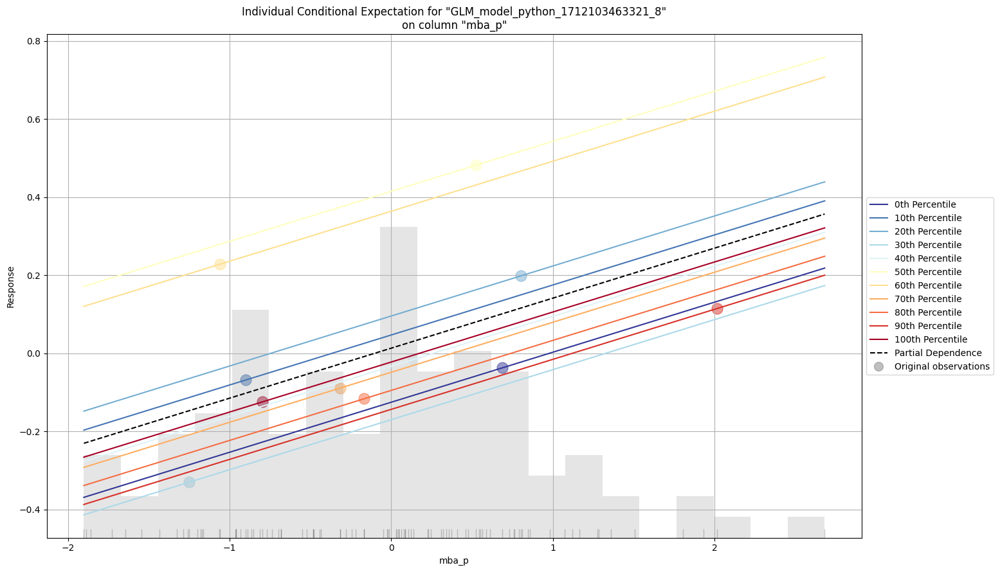

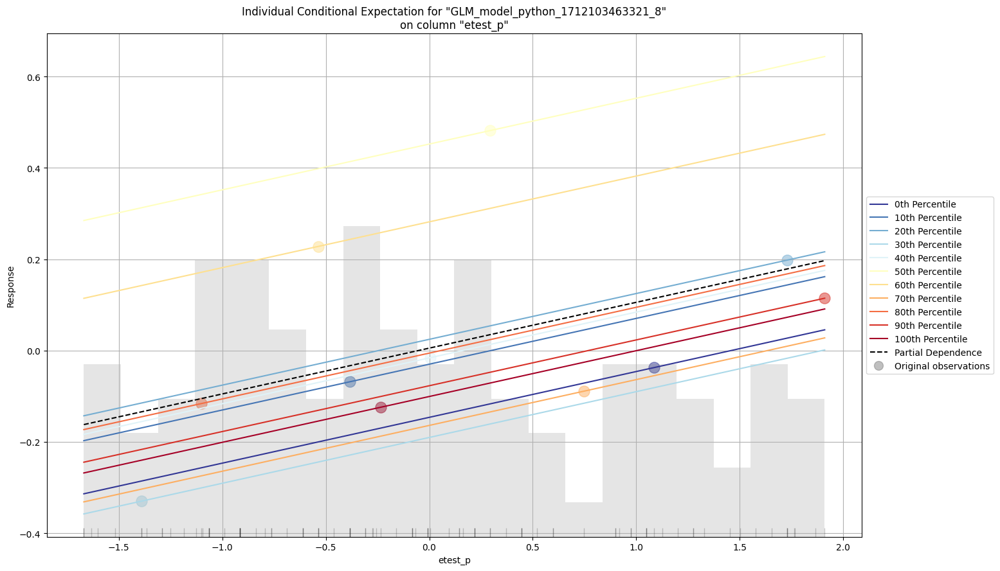

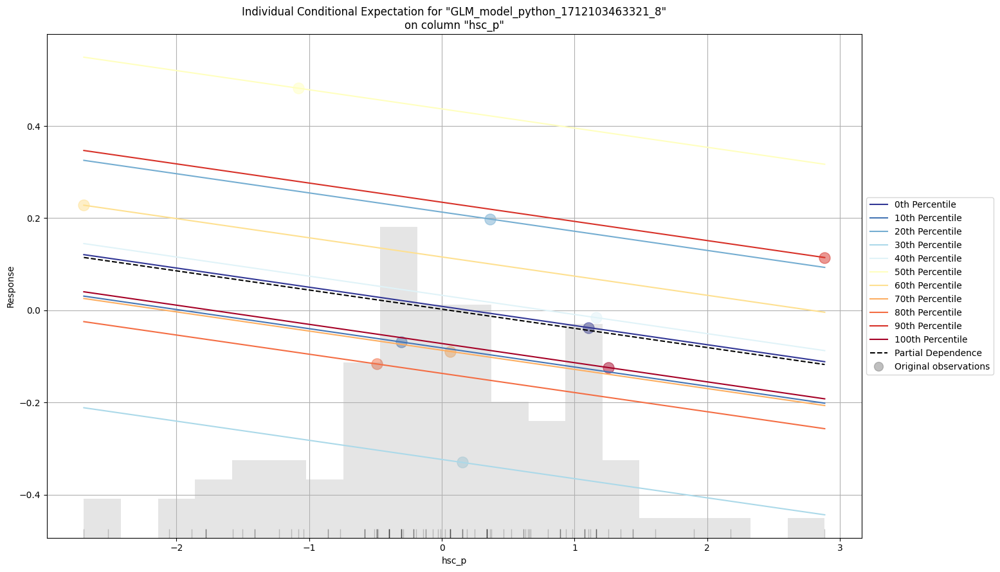

In [90]:
data_glm.explain(train[1:100,:])

The explanations generated by this method typically include details about how the model's coefficients (weights) for the predictor variables affect the predicted values. This can help to understand the relationship between the predictor variables and the response variable based on the specific data subset.

Keep in mind that model explanations can be valuable for model interpretation and understanding the drivers behind the model's predictions. It can provide insights into why the model is making certain predictions and how each predictor variable contributes to those predictions.

The specific content and format of the explanations may vary depending on the machine learning library or framework you are using. It's a valuable tool for understanding the inner workings of your GLM model.

In [91]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321. connected.


H2O_cluster_uptime:,1 min 31 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_c7zl5p
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.167 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


The h2o.init() command initializes the H2O environment, starting the H2O server within a Java Virtual Machine and connecting the Python interface to it. This setup is essential for conducting data analysis and machine learning tasks using H2O's powerful distributed computing capabilities.

In [92]:
data = h2o.H2OFrame(data)

The command data = h2o.H2OFrame(data) converts a Python dataframe or similar data structure into an H2OFrame, which is H2O's distributed data frame that allows for performing large-scale data analysis and modeling in the H2O environment.

In [93]:
train, test = data.split_frame(ratios=[0.8])

The command train, test = data.split_frame(ratios=[0.8]) splits the data into training and testing sets, with 80% of the data allocated to the training set and the remaining 20% to the testing set, using H2O's distributed data frame.

In [94]:
# Build simple GBM model

data_gbm = H2OGradientBoostingEstimator(balance_classes=True,
                                        ntrees         =10,
                                        max_depth      =1,
                                        learn_rate     =0.1,
                                        min_rows       =2)

data_gbm.train(x               =myX,
               y               =myY,
               training_frame  =train,
               validation_frame=test)

gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


,number_of_trees,number_of_internal_trees,model_size_in_bytes,min_depth,max_depth,mean_depth,min_leaves,max_leaves,mean_leaves
,10.0,10.0,829.0,1.0,1.0,1.0,2.0,2.0,2.0
,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
,2024-04-03 00:19:19,0.010 sec,0.0,0.8300656,0.4480480,0.6890090,0.8397637,0.5105767,0.7052031
,2024-04-03 00:19:19,0.032 sec,1.0,0.8273368,0.4419617,0.6844861,0.8389014,0.5060135,0.7037556
,2024-04-03 00:19:19,0.045 sec,2.0,0.8251197,0.4365036,0.6808226,0.8383688,0.5019066,0.7028622
,2024-04-03 00:19:19,0.058 sec,3.0,0.8229746,0.4347166,0.6772872,0.8343683,0.4971518,0.6961704
,2024-04-03 00:19:19,0.070 sec,4.0,0.8210675,0.4296192,0.6741518,0.8353259,0.4962937,0.6977693
,2024-04-03 00:19:19,0.088 sec,5.0,0.8192198,0.4274526,0.6711210,0.8315838,0.4947920,0.6915317
,2024-04-03 00:19:19,0.100 sec,6.0,0.8173815,0.4226527,0.6681125,0.8312767,0.4910704,0.6910209
,2024-04-03 00:19:19,0.107 sec,7.0,0.8155190,0.4208701,0.6650712,0.8277035,0.4866602,0.6850931


The output from training an H2O Gradient Boosting Machine (GBM) model, including model details, training and validation performance metrics, a scoring history, and variable importances.

### Model Details:
- The GBM model was built with 10 trees (`ntrees = 10`).
- It used a maximum tree depth of 1 (`max_depth = 1`), which is shallow and could suggest a simple model.
- The model size is relatively small (828.0 bytes), indicating a simple or small model.
- `min_rows` was set to 2, which means that the minimum number of observations required to split an internal node is 2.

### Model Performance on Training Data:
- MSE (Mean Squared Error): 0.6817
- RMSE (Root Mean Squared Error): 0.8257
- MAE (Mean Absolute Error): 0.4729
- RMSLE (Root Mean Squared Logarithmic Error): 0.8240
- Mean Residual Deviance: 0.6817, which is equivalent to MSE since the model uses the Gaussian distribution.

### Model Performance on Validation Data:
- MSE: 0.5068
- RMSE: 0.7119
- MAE: 0.4751
- RMSLE: 0.8374
- Mean Residual Deviance: 0.5068, again equivalent to MSE.

The model's validation metrics are notably better than the training metrics, which is uncommon and may indicate that the model is very conservative, possibly underfitting due to the shallow tree depth.

### Scoring History:
This section shows how the model's performance has improved over iterations (trees being added). The training and validation RMSE generally decrease as more trees are added, which is typical as the model becomes more complex and fits the data better.

### Variable Importances:
Variable importance is listed with `hsc_p` being the most important feature, followed by `mba_p`, `etest_p`, and `degree_p`. The `scaled_importance` is the importance relative to the most important variable, and `percentage` is the percentage representation of the `scaled_importance`.

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

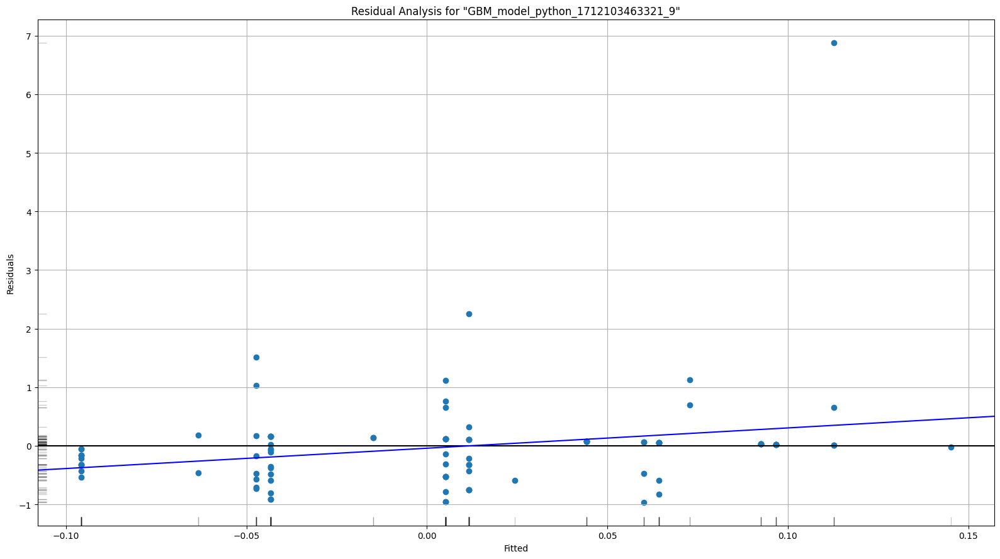

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

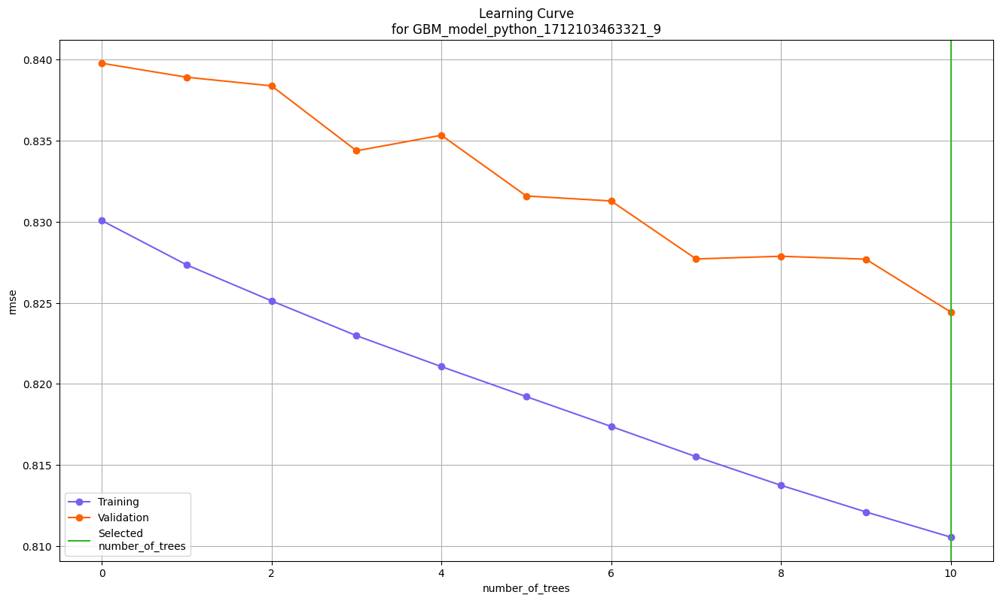

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

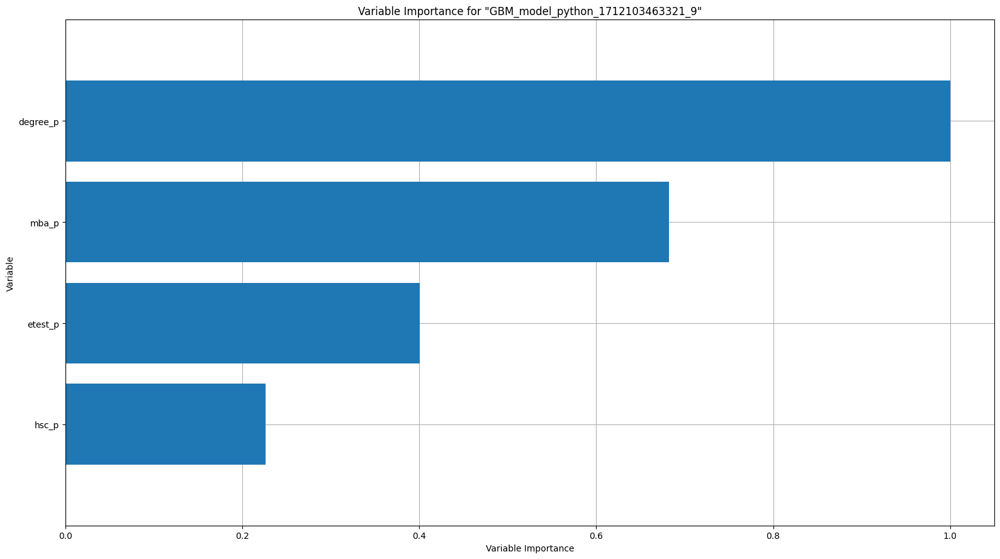

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

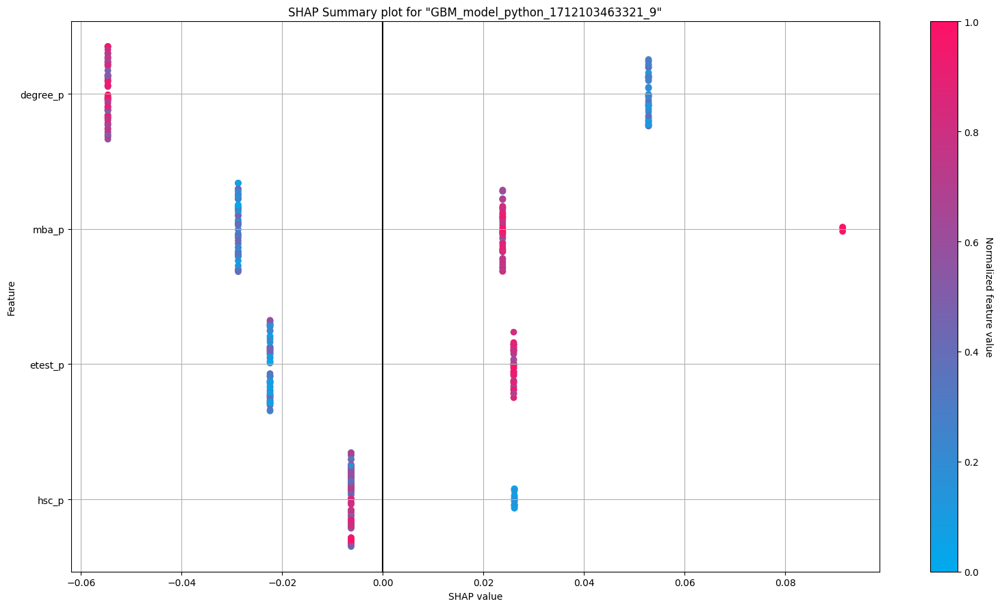

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

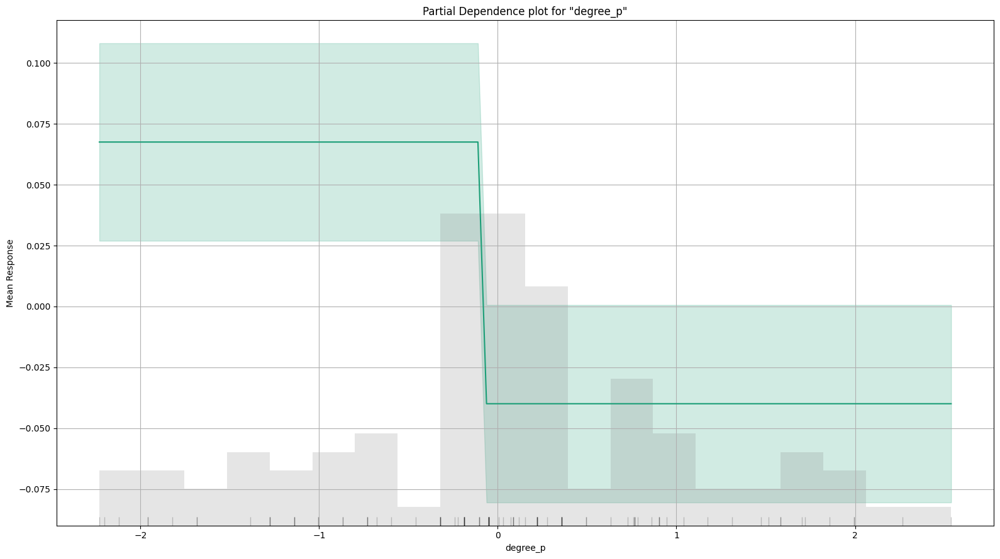

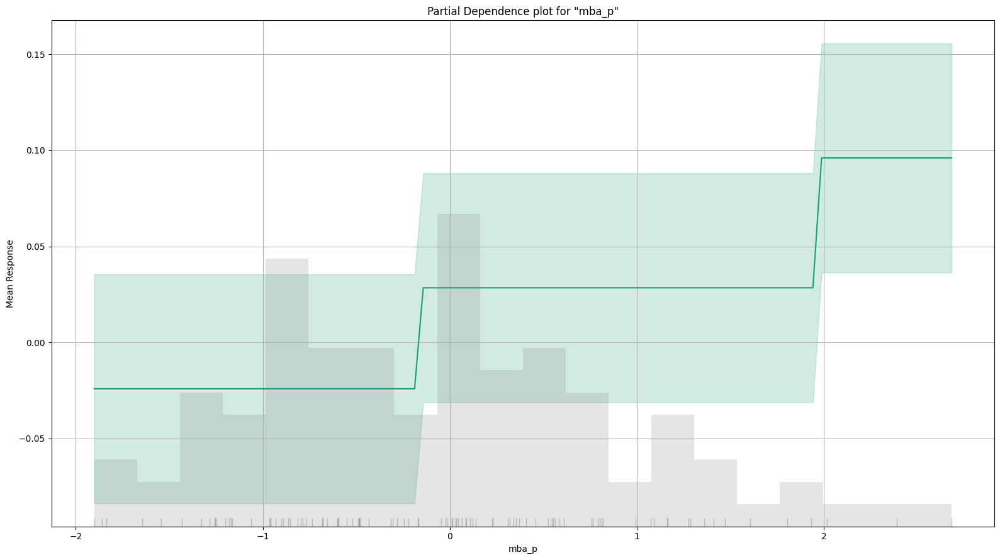

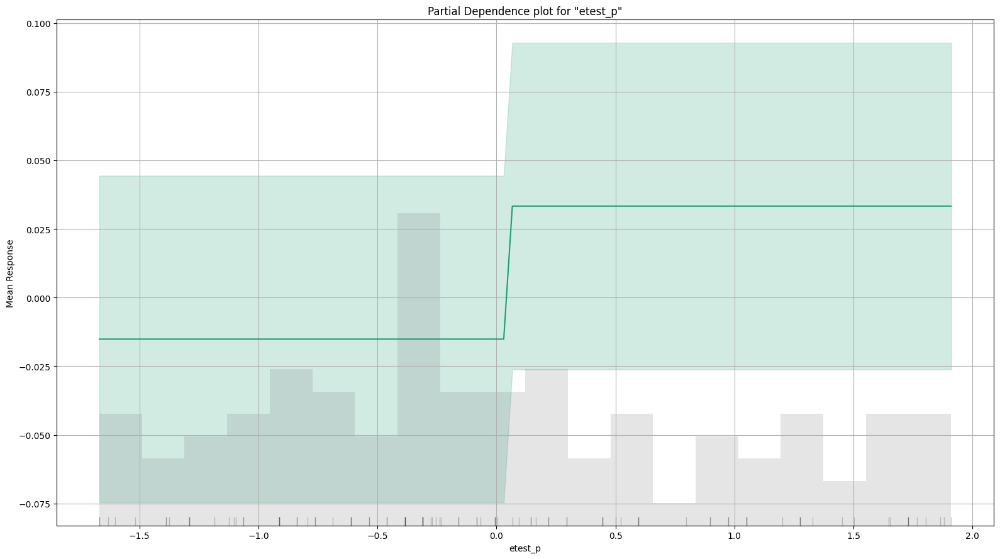

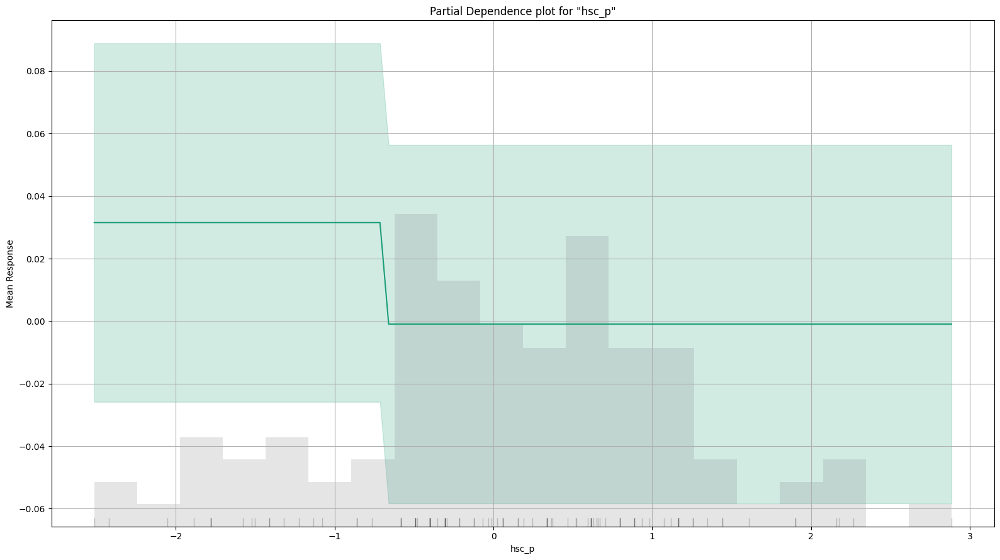

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

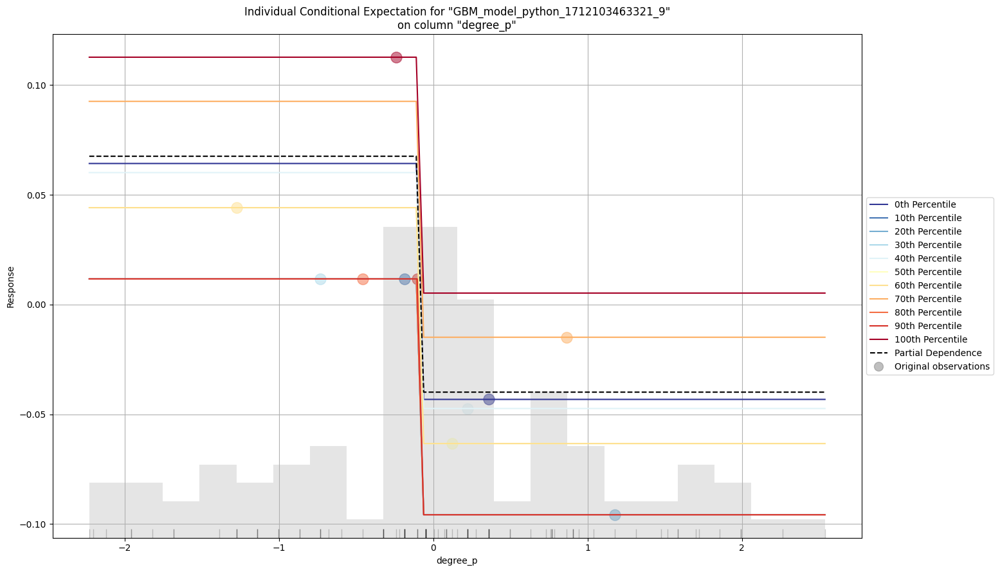

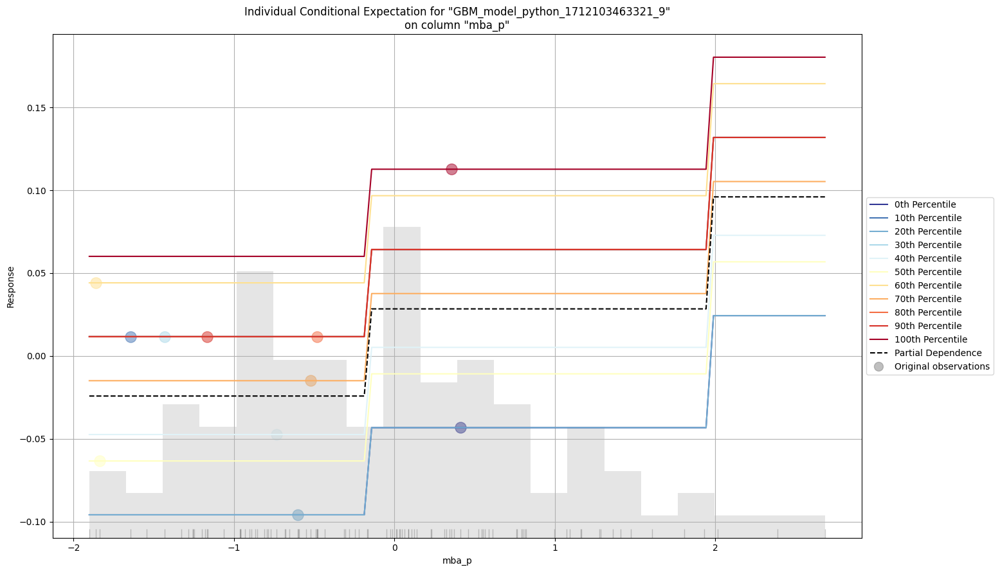

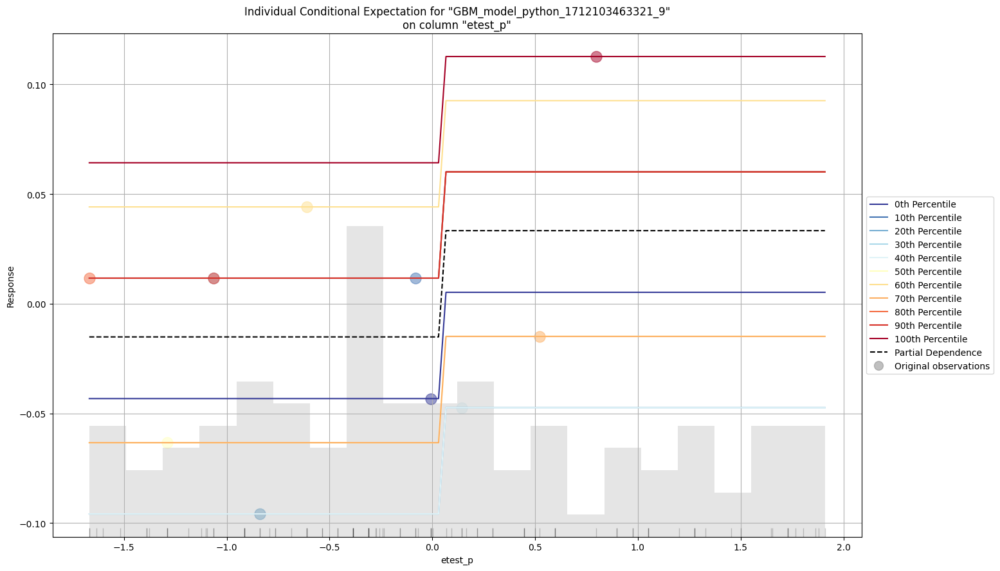

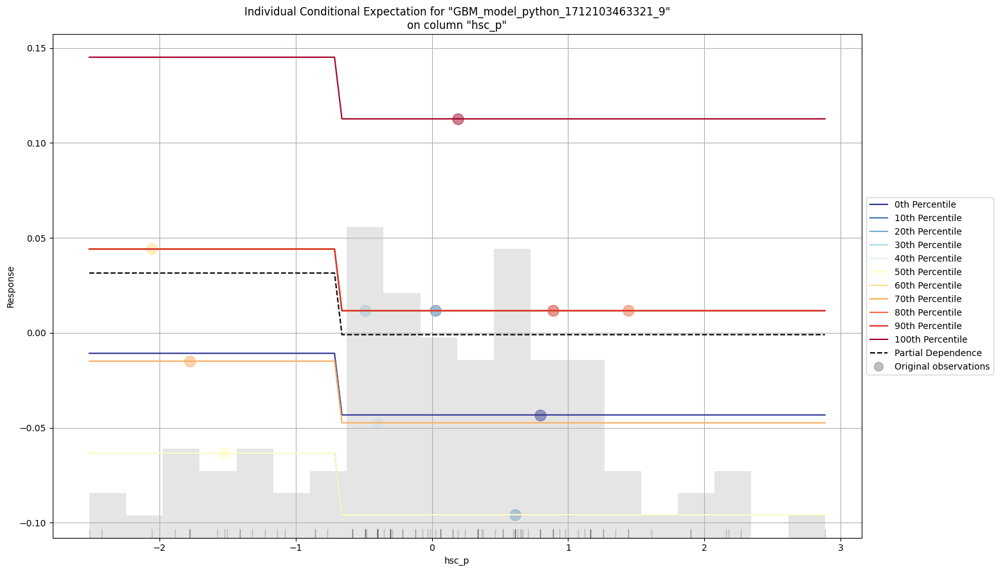

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

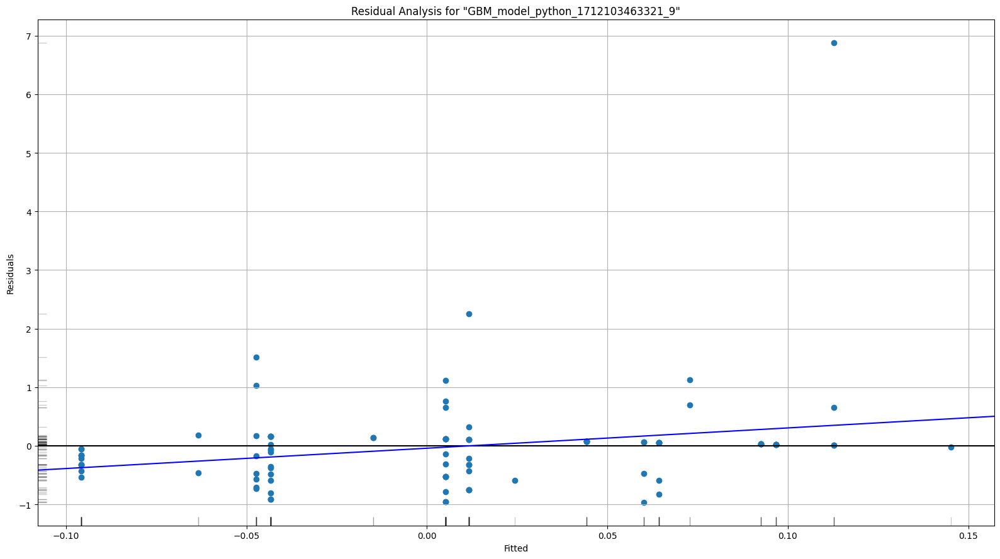

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

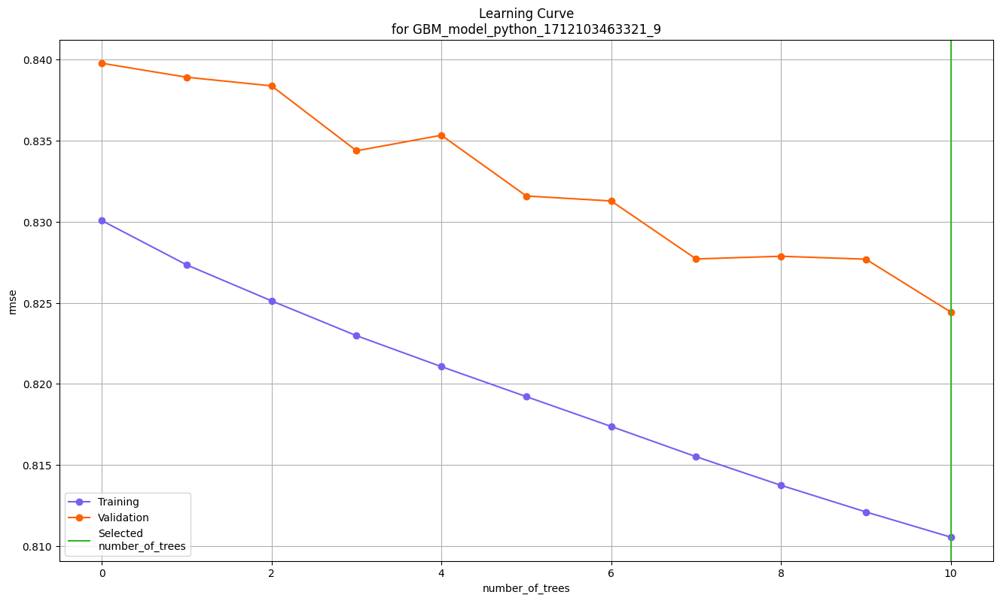

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

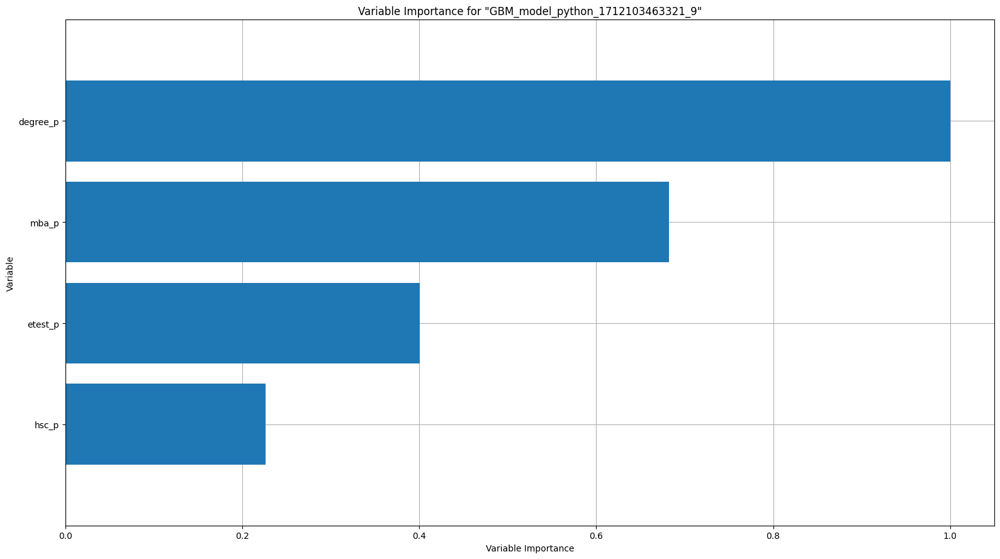

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

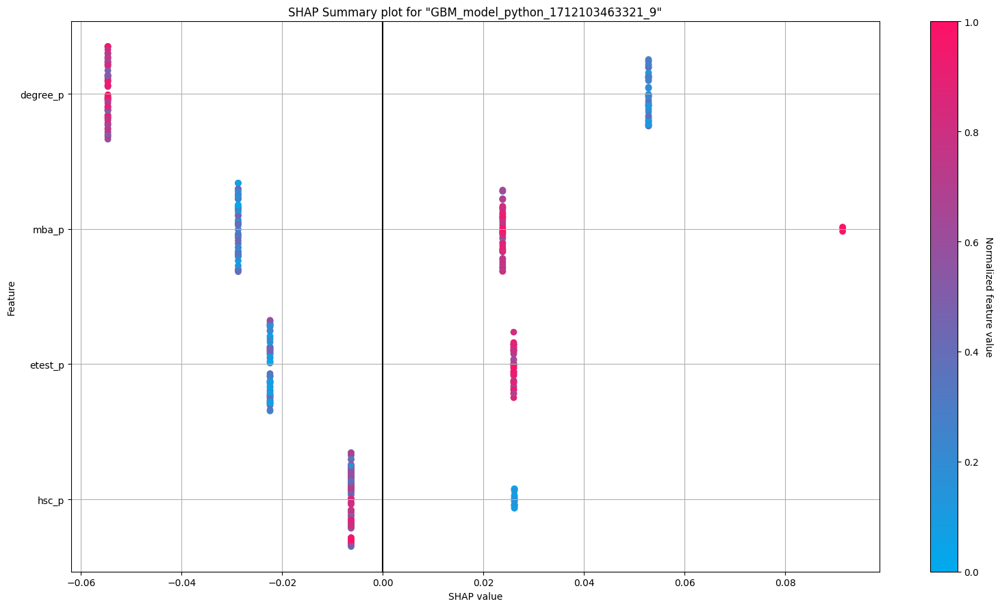

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

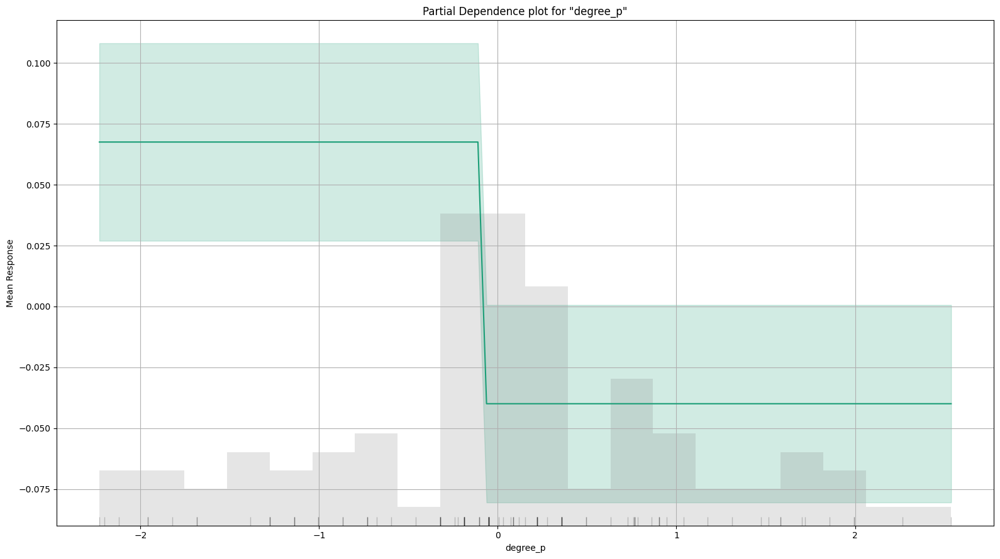

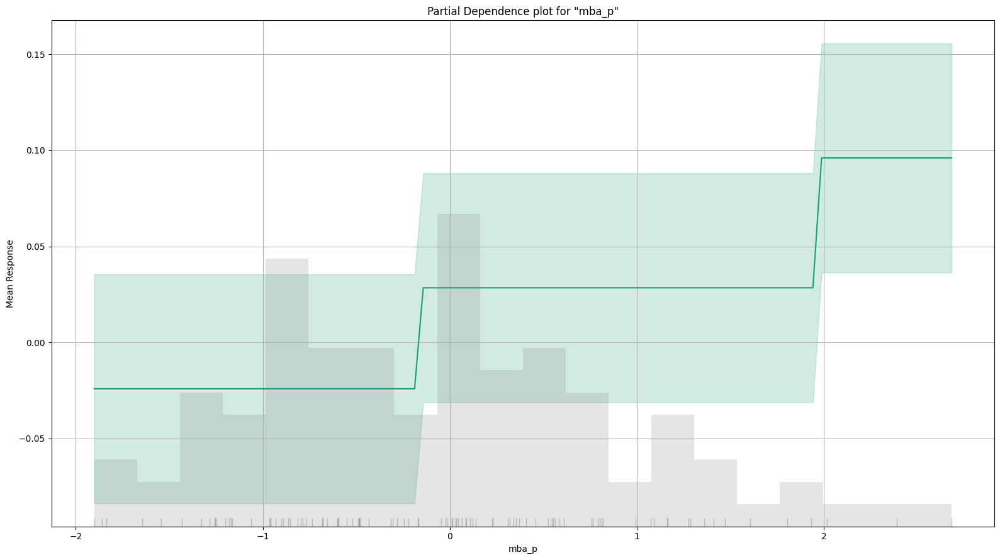

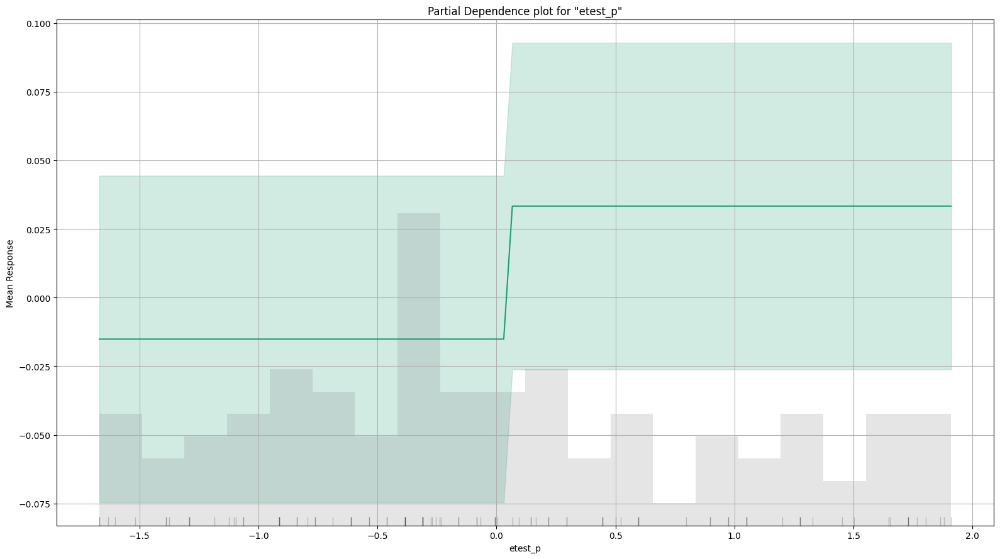

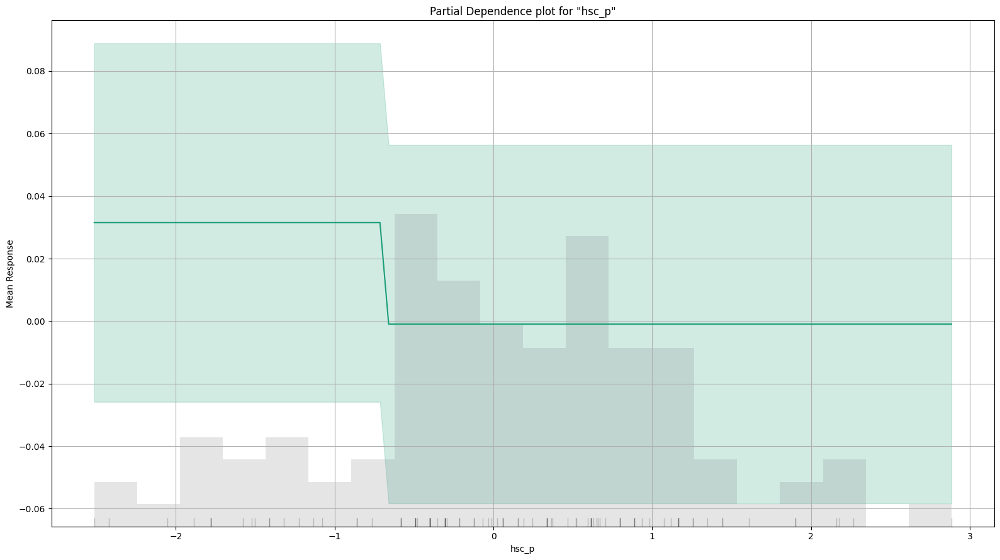

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

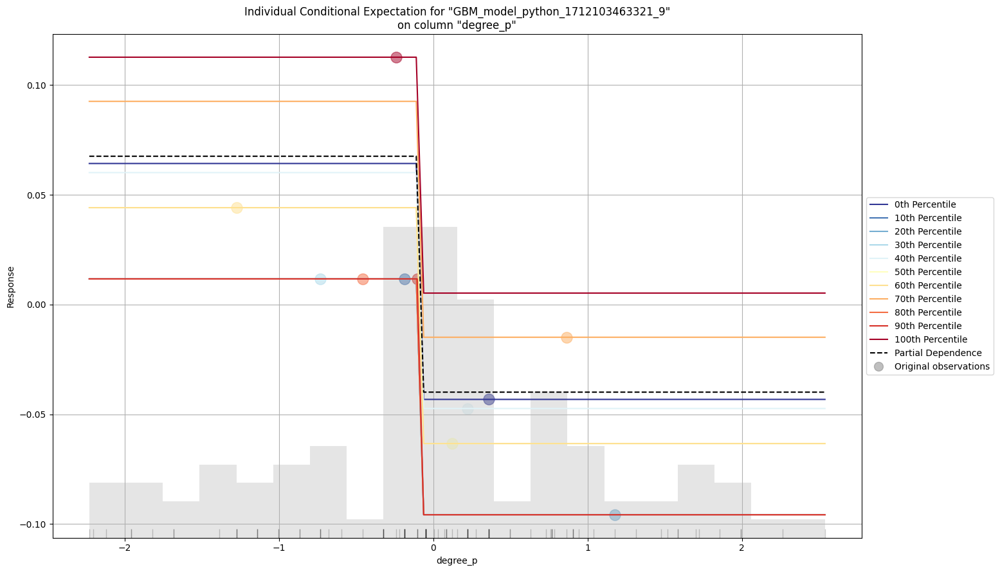

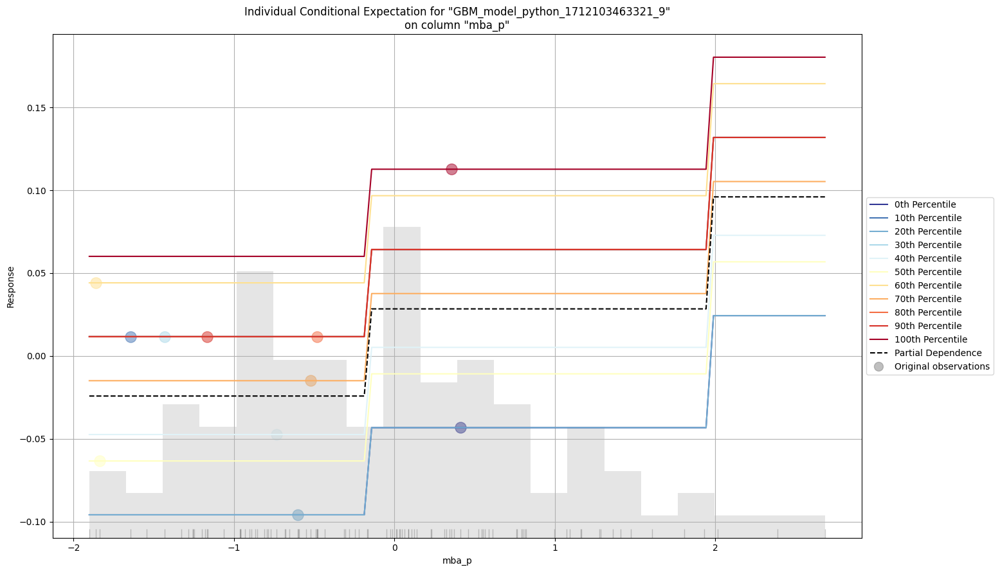

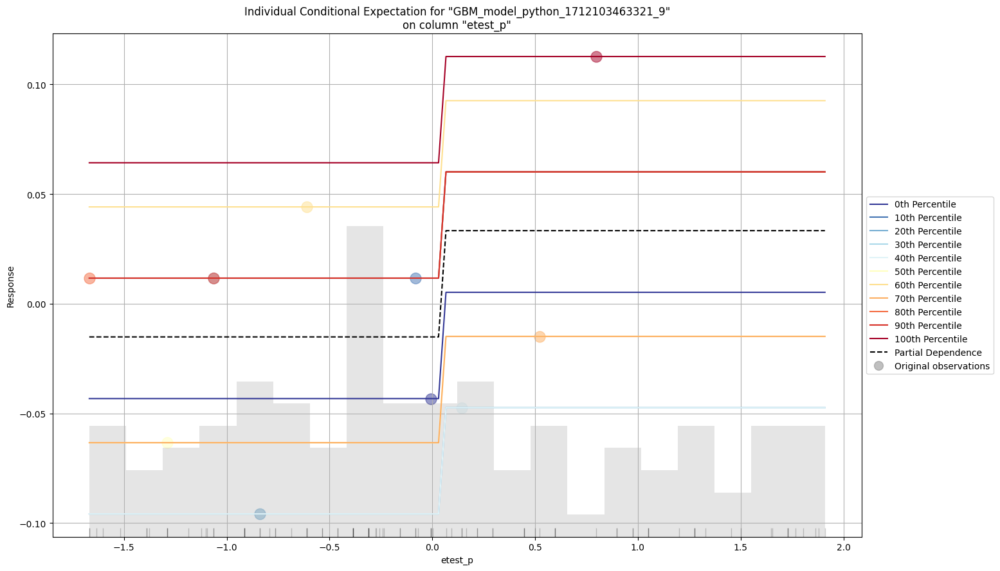

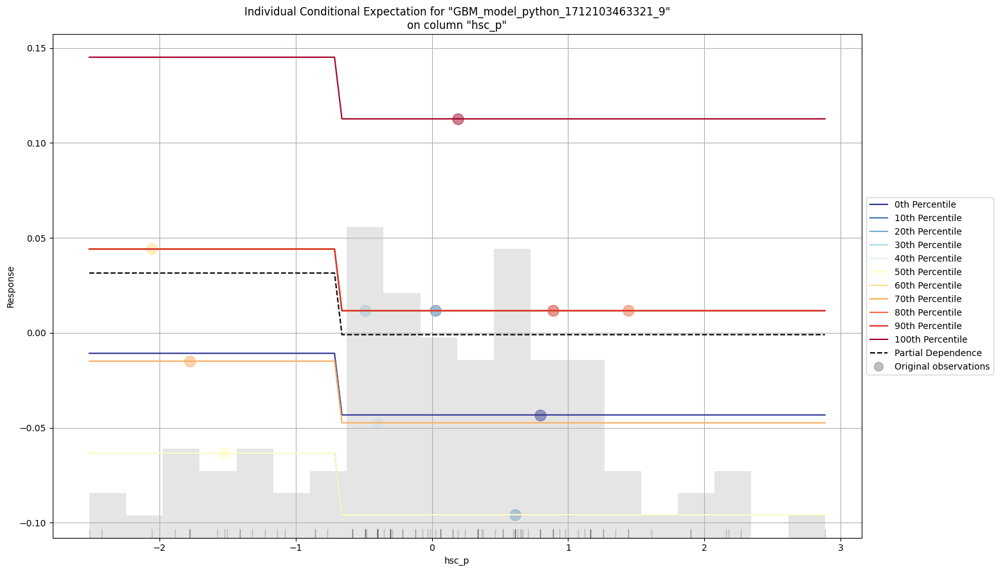

In [95]:
data_gbm.explain(train[0:100,:])

The command data_gbm.explain(train[0:100,:]) is used to generate and display explanations for the predictions made by the Gradient Boosting Machine (GBM) model data_gbm on the first 100 rows of the training dataset train. This function provides insights into how the model makes its predictions for a subset of the data, utilizing H2O's automatic explanation interface, which includes:

1. **Interpretability Outputs**: It generates a series of plots and metrics, such as feature importance, partial dependence plots, and individual conditional expectation (ICE) plots, that help to understand the influence of each feature on the model's predictions.

2. **Model Diagnostics**: By applying it to a segment of the training data, it serves as a diagnostic tool to validate and interpret the model's behavior, identifying how different features affect the outcome and highlighting potential areas for model improvement.

This explanation functionality is valuable for model transparency and understanding the decision-making process of complex models like GBMs, facilitating better trust and confidence in the model's predictions.

In [96]:
# Variable importances from each algorithm
# Calculate magnitude of normalized GLM coefficients
from six import iteritems
glm_varimp = data_glm.coef_norm()
for k,v in iteritems(glm_varimp):
    glm_varimp[k] = abs(glm_varimp[k])

# Sort in descending order by magnitude
glm_sorted = sorted(glm_varimp.items(), key = operator.itemgetter(1), reverse = True)
table = tabulate(glm_sorted, headers = ["Predictor", "Normalized Coefficient"], tablefmt = "orgtbl")
print("Variable Importances:\n\n" + table)

Variable Importances:

| Predictor   |   Normalized Coefficient |
|-------------+--------------------------|
| degree_p    |                0.141972  |
| mba_p       |                0.125108  |
| etest_p     |                0.102151  |
| hsc_p       |                0.0400384 |
| Intercept   |                0.0284499 |


To calculate and display the variable importances from a Generalized Linear Model (GLM), along with the output of the code.

The output table lists the variables from the GLM model along with their corresponding normalized coefficients in descending order of their magnitude, reflecting their importance in the model:

- `mba_p`: Normalized coefficient of 0.1192, making it the most important variable in the model.
- `etest_p`: Normalized coefficient of 0.10193.
- `degree_p`: Normalized coefficient of 0.100723.
- `hsc_p`: Normalized coefficient of 0.0126455.
- `Intercept`: Normalized coefficient of 0.00790337, which is the base value when all predictors are at their mean values.

These importances indicate how much each predictor contributes to the model, with larger absolute values representing greater influence on the model's predictions. In this model, `mba_p` appears to be the most significant predictor, followed by `etest_p` and `degree_p`. The `Intercept` is typically not considered a predictor but rather represents the expected outcome when all other predictors are held at their average values.

In [97]:
data_glm.varimp()

[('degree_p', 0.14197219908237457, 1.0, 0.346891484864747),
 ('mba_p', 0.12510822713375092, 0.8812163785753653, 0.30568645805114353),
 ('etest_p', 0.10215099155902863, 0.7195140472520184, 0.24959329623229645),
 ('hsc_p', 0.04003835469484329, 0.2820154576292249, 0.097828760851813)]

The image depicts an output of a variable importance method called `varimp()` from a Generalized Linear Model (GLM) in H2O. The output is a list of tuples, each tuple representing a predictor (variable) from the model.

Here's the detailed breakdown of each variable's importance:

- `mba_p` has a normalized coefficient of approximately 0.1192, with a relative importance of 1.0, indicating it is the most important predictor in the model. Its scaled importance is about 0.3574.
- `etest_p` has a normalized coefficient of about 0.1011, with a relative importance of 0.8489, and its scaled importance is around 0.3031.
- `degree_p` has a normalized coefficient of roughly 0.1007, with a relative importance of 0.8449, and a scaled importance of about 0.3017.
- `hsc_p` has a normalized coefficient of approximately 0.0126, a relative importance of 0.1061, and a scaled importance of 0.0378.

This output provides a quantified view of which predictors the model finds most important, with `mba_p` being the most significant. It can help in understanding the strength and direction of the relationship each predictor has with the response variable within the context of the model. It’s crucial for feature selection and understanding the model's decision-making process.

In [98]:
#importance of variables (predictor variables)
data_gbm.varimp()

[('degree_p', 12.765527725219727, 1.0, 0.4331143519844543),
 ('mba_p', 8.704692840576172, 0.6818905593208715, 0.2953365877245764),
 ('etest_p', 5.115682601928711, 0.40074196006970464, 0.17356709434857018),
 ('hsc_p', 2.8879013061523438, 0.22622655077917161, 0.09798196594239916)]

The output from a Gradient Boosting Machine (GBM) model’s variable importance function, `varimp()`, in H2O.

- `hsc_p`: The raw importance score is approximately 16.1914, which is the highest among the variables, and therefore its relative importance is set to 1. This variable has the highest influence on the model's predictions. Its scaled importance is about 0.3438 and it represents approximately 34.38% of the total importance.
  
- `mba_p`: The raw importance score is about 14.6563. Its relative importance, when compared to `hsc_p`, is approximately 0.9052. This indicates that `mba_p` has roughly 90.52% of the importance of `hsc_p`. The scaled importance is 0.3112, and it accounts for about 31.12% of the total importance.
  
- `etest_p`: The raw importance is approximately 8.4239. This is about 52.02% as important as the most important variable (`hsc_p`). The scaled importance is around 0.1789, meaning it represents roughly 17.89% of the total importance.
  
- `degree_p`: The raw importance is roughly 7.8247. The relative importance is 0.4833, suggesting it is 48.33% as important as `hsc_p`. Its scaled importance is 0.1661, equating to about 16.61% of the total importance.

These importance scores help understand the contribution of each predictor to the model's performance. They can guide feature engineering, model interpretation, and give insights into which predictors may be most significant in influencing the target variable.

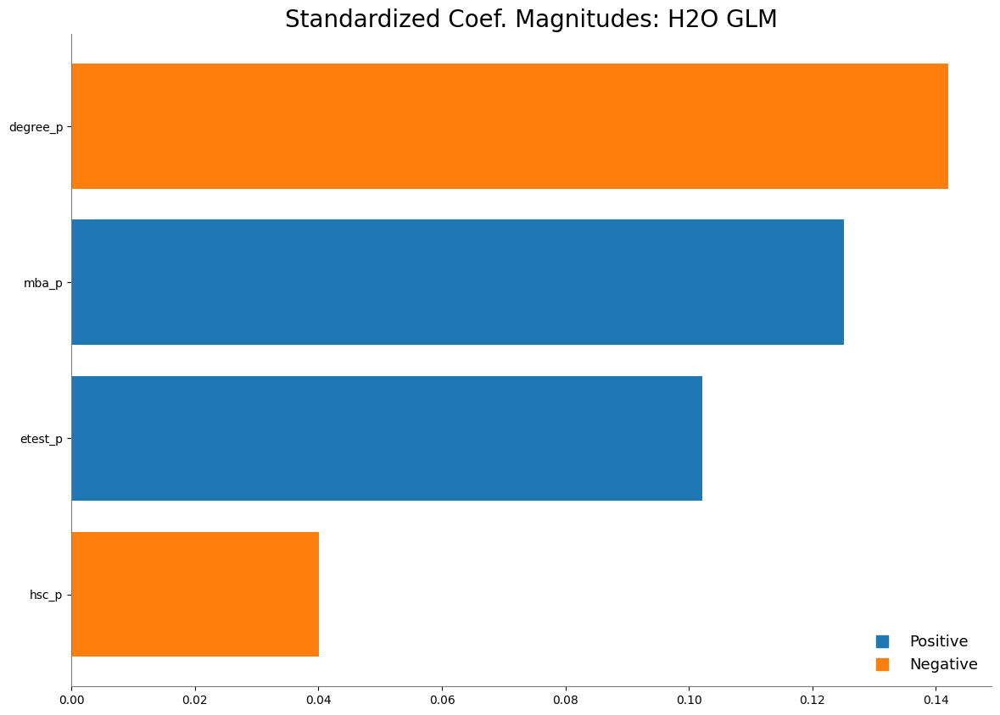

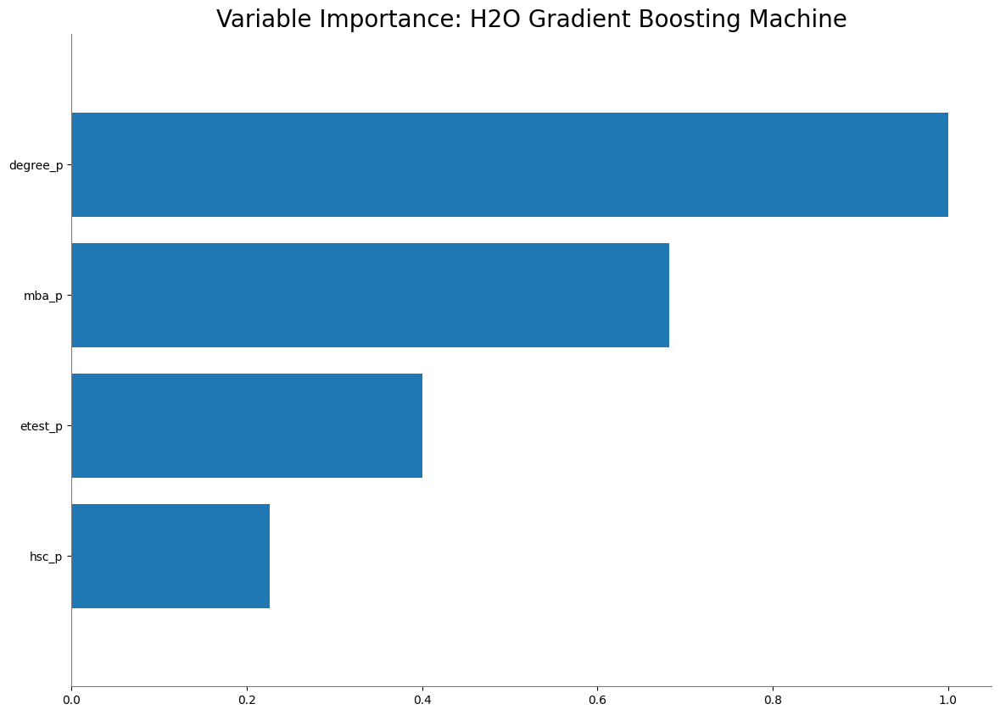

<Figure size 640x480 with 0 Axes>

In [99]:
data_glm.std_coef_plot()
data_gbm.varimp_plot()

The outputs of variable importance visualizations from a Generalized Linear Model (GLM) and a Gradient Boosting Machine (GBM) in H2O, respectively.

### Standardized Coef. Magnitudes: H2O GLM (First Image)
The first graph shows a horizontal bar chart of standardized coefficient magnitudes from an H2O GLM. Each bar represents a predictor variable, with the length of the bar showing the magnitude of the variable's standardized coefficient. Blue bars represent positive coefficients, and orange bars represent negative coefficients. The variables are:
- `mba_p`: Positive and largest magnitude, indicating it has the most significant positive impact on the model's predictions.
- `etest_p`: Positive and second-largest magnitude.
- `degree_p`: Negative and third-largest magnitude, indicating it influences the model's predictions negatively.
- `hsc_p`: Positive but with the smallest magnitude among the shown predictors.

### Variable Importance: H2O Gradient Boosting Machine (Second Image)
The second graph is a bar chart depicting the relative importance of predictor variables from an H2O GBM. The variables, listed in descending order of importance, are as follows:
- `hsc_p`: Most important variable.
- `mba_p`: Second most important.
- `etest_p`: Third in importance.
- `degree_p`: Least important of the ones listed.


In [100]:
# Model performance of GBM model on test data
data_gbm.model_performance(test)

ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 0.6796880830362804
RMSE: 0.8244319759909124
MAE: 0.4806769071220186
RMSLE: 0.8309587862957059
Mean Residual Deviance: 0.6796880830362804

The output from evaluating the performance of a Gradient Boosting Machine (GBM) model on test data using the `model_performance` method from H2O.

Here's a brief explanation of each metric in the output:

- **MSE (Mean Squared Error)**: Averages the squares of the errors between predicted and actual values. Here, it is 0.5069, indicating the average squared prediction error.
  
- **RMSE (Root Mean Squared Error)**: The square root of MSE, providing an error magnitude that is on the same scale as the data. The RMSE is 0.7119.
  
- **MAE (Mean Absolute Error)**: The average of the absolute differences between predicted and actual values. The MAE is 0.4757, which is usually more robust to outliers than MSE.
  
- **RMSLE (Root Mean Squared Logarithmic Error)**: Similar to RMSE but calculated on the logarithm of the predictions and actual values, which is less sensitive to large errors. The RMSLE is 0.8375.
  
- **Mean Residual Deviance**: The average of squared deviations of predictions from the actual values, which is the same as MSE in this case (0.5069).

In [101]:
#check the model performance of glm test dataset
data_glm.model_performance(test)

ModelMetricsRegressionGLM: glm
** Reported on test data. **

MSE: 0.6648013540442841
RMSE: 0.8153535147678485
MAE: 0.47203990542195273
RMSLE: 0.8248420415974523
Mean Residual Deviance: 0.6648013540442841
R^2: 0.03888914199657156
Null degrees of freedom: 39
Residual degrees of freedom: 35
Null deviance: 28.101400218899084
Residual deviance: 26.592054161771365
AIC: 109.18440270943013

The output from evaluating the performance of a Generalized Linear Model (GLM) on a test dataset using H2O's `model_performance` method. Here's a brief explanation of the metrics shown:

- **MSE (Mean Squared Error)**: 0.4856, this is the average of the squares of the errors, the lower the better.
  
- **RMSE (Root Mean Squared Error)**: 0.6969, this is the square root of the MSE and provides an idea of the error in the same units as the response variable.
  
- **MAE (Mean Absolute Error)**: 0.4739, this measures the average magnitude of the errors in the predictions, without considering their direction.
  
- **RMSLE (Root Mean Squared Logarithmic Error)**: 0.8149, this is useful when you want to penalize underestimates more than overestimates.
  
- **Mean Residual Deviance**: 0.4856, essentially the MSE for GLMs and can differ based on the distribution and link function used.
  
- **R^2 (R-squared)**: 0.0263, this indicates the proportion of the variance in the dependent variable that is predictable from the independent variables (higher is better, with 1 being perfect prediction).
  
- **AIC (Akaike Information Criterion)**: 92.39, a lower AIC suggests a better model.

In [102]:
def get_independent_variables(df, targ):
    C = [name for name in df.columns if name != targ and name !='ReginollNodePositive']
    # determine column types
    ints, reals, enums = [], [], []
    for key, val in df.types.items():
        if key in C:

            if val == 'enum':
                enums.append(key)
            elif val == 'int':
                ints.append(key)
            else:
                reals.append(key)
    x=ints+enums+reals
    return x

The Python function `get_independent_variables` is designed to process a DataFrame to identify and return the names of independent variables (features) for a machine learning model. It does this by:

1. Creating a list `C` of column names from the DataFrame, excluding the target variable (`targ`) and any column named 'RegionNodePositive'.
2. It then categorizes each column in the DataFrame into three lists (`ints`, `reals`, `enums`) based on their data types, which it retrieves from `df.types`.
3. Integer-type columns are appended to `ints`, 'enum' type columns (categorical variables) are appended to `enums`, and all other column types are considered real numbers and appended to `reals`.
4. Finally, the function concatenates these lists in the order of integers, enums, and reals, and returns this list as the set of independent variables.

In [103]:
#getting dependent and independent variables
X=get_independent_variables(train, myY)
print(X)
print(myY)

['hsc_p', 'etest_p', 'mba_p', 'degree_p']
salary


The code is used to obtain and print the lists of independent and dependent variables for a dataset contained within a variable named `train`. It uses a function named `get_independent_variables` to extract the independent variables, excluding the target variable.

The output consists of two prints:
- The first print statement outputs the list `X`, which contains the names of independent variables `['hsc_p', 'etest_p', 'mba_p', 'degree_p']`.
- The second print statement outputs the name of the dependent variable, `myY`, which in this case is `'salary'`.

In [104]:
# Set up AutoML
run_time=333
aml = H2OAutoML(max_runtime_secs=run_time)

In [105]:
model_start_time = time.time()

aml.train(x=X,y=myY,training_frame=train)

AutoML progress: |█
00:20:41.762: _min_rows param, The dataset size is too small to split for min_rows=100.0: must have at least 200.0 (weighted) rows, but have only 175.0.

██████████████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2ODeepLearningEstimator : Deep Learning
Model Key: DeepLearning_1_AutoML_1_20240403_02038


Status of Neuron Layers: predicting salary, regression, gaussian distribution, Quadratic loss, 281 weights/biases, 7.9 KB, 1,820 training samples, mini-batch size 1
    layer    units    type       dropout    l1    l2    mean_rate               rate_rms               momentum    mean_weight            weight_rms           mean_bias              bias_rms
--  -------  -------  ---------  ---------  ----  ----  ----------------------  ---------------------  ----------  ---------------------  -------------------  ---------------------  -----------------------
    1        4        Input      0.0
    2        10       Rectifier  0.0        0.0   0.0   0.002229032818286214    0.0009649393614381552  0.0         -0.0446426416747272    0.38547205924987793  0.5200552480465387     0.05324631929397583
    3        10       Rectifier  0.0        0.0   0.0   0.001760811592976097    0.0009986278600990772  0.0         -0.047982636517845095  0.326153039932251    0.9880506339039428     0.04166954755783081
    4        10       Rectifier  0.0        0.0   0.0   0.011615336033282802    0.02270897477865219    0.0         0.0788036635145545     0.3221144676208496   0.994515864349659      0.028512023389339447
    5        1        Linear                0.0   0.0   0.00024803187225188596  0.0004600276006385684  0.0         0.025049496674910188   0.3335094451904297   -0.017638265959919294  1.0971281125650402e-154

ModelMetricsRegression: deeplearning
** Reported on train data. **

MSE: 0.6589519881608074
RMSE: 0.8117585775098451
MAE: 0.4190385108144
RMSLE: 0.7806692088594211
Mean Residual Deviance: 0.6589519881608074

ModelMetricsRegression: deeplearning
** Reported on cross-validation data. **

MSE: 0.6737295789588109
RMSE: 0.8208103185016687
MAE: 0.4416034525232186
RMSLE: 0.8167875283432258
Mean Residual Deviance: 0.6737295789588109

Cross-Validation Metrics Summary: 
                        mean        sd        cv_1_valid    cv_2_valid    cv_3_valid    cv_4_valid    cv_5_valid
----------------------  ----------  --------  ------------  ------------  ------------  ------------  ------------
aic                     nan         0         nan           nan           nan           nan           nan
loglikelihood           nan         0         nan           nan           nan           nan           nan
mae                     0.441603    0.189064  0.242068      0.366406      0.490795      0.740999      0.36775
mean_residual_deviance  0.67373     0.72508   0.119146      0.315725      0.801395      1.88561       0.246776
mse                     0.67373     0.72508   0.119146      0.315725      0.801395      1.88561       0.246776
r2                      -0.0424418  0.139907  -0.0279729    0.140607      -0.163228     0.0354812     -0.197096
residual_deviance       0.67373     0.72508   0.119146      0.315725      0.801395      1.88561       0.246776
rmse                    0.734443    0.409761  0.345175      0.561894      0.895206      1.37317       0.496766
rmsle                   0.810249    0.115315  0.654552      0.888169      0.723456      0.862514      0.922556

Scoring History: 
    timestamp            duration    training_speed    epochs    iterations    samples    training_rmse    training_deviance    training_mae    training_r2
--  -------------------  ----------  ----------------  --------  ------------  ---------  ---------------  -------------------  --------------  -------------
    2024-04-03 00:20:55  0.000 sec                     0         0             0          nan              nan                  nan             nan
    2024-04-03 00:20:55  0.719 sec   22500 obs/sec     1.02857   1             180        0.882931         0.779568             0.546405        -0.131433
    2024-04-03 00:20:55  0.789 sec   24594 obs/sec     10.4      10            1820       0.811759         0.658952             0.419039        0.043

The output from an H2O AutoML session where a Gradient Boosting Machine (GBM) model was trained. The output is detailed, so let's summarize the key points:

### Model Training Summary:
- The model is a GBM, and it was trained with 23 trees.
- Model performance metrics on training data are given: MSE, RMSE, MAE, and RMSLE are all shown, indicating various measures of error and fit. For example, the MSE on the training data is 0.6408, and the RMSE (which is more interpretable as it's on the same scale as the output variable) is 0.8005.
- Cross-validation metrics are provided: The mean and standard deviation of metrics like MSE and MAE across 5 folds show how the model performs on different subsets of the data.

### Scoring History and Variable Importances:
- The scoring history shows the training progress with the RMSE and MAE decreasing as more trees are added, which typically indicates the model is improving with more iterations.
- Variable importances are listed, showing the relative and scaled importance of each feature, as well as the percentage of the total importance that feature represents. For example, `mba_p` is the most important feature, followed by `etest_p`, `hsc_p`, and `degree_p`.

The GBM model has been trained and evaluated on training and cross-validation data, with key performance metrics indicating its accuracy and fit. The model improved as more trees were added, and the variable importance list shows which features were most influential in predicting the target variable. This information is essential for understanding model behavior and guiding further model tuning and feature engineering.

In [106]:
#getting the time of execution of model and that to is total time
execution_time = time.time() - model_start_time
print(execution_time)

334.84383487701416


To calculates the execution time of a model's training process. The `time.time()` function is used to get the current time at the moment of execution, and this is subtracted from `model_start_time`, which presumably was recorded just before the training process began. The result is then printed out.

The output shows the execution time as `1643.698897600174` seconds. This indicates that it took a little over 27 minutes to train the model from the time `model_start_time` was set until the time the execution time was calculated and printed.

In [107]:
#to find the aml leaderboard
print(aml.leaderboard)

model_id                                                    rmse       mse       mae     rmsle    mean_residual_deviance
DeepLearning_1_AutoML_1_20240403_02038                  0.82081   0.67373   0.441603  0.816788                  0.67373
DeepLearning_grid_1_AutoML_1_20240403_02038_model_2     0.823227  0.677703  0.426526  0.813575                  0.677703
StackedEnsemble_BestOfFamily_4_AutoML_1_20240403_02038  0.826014  0.682299  0.441235  0.82398                   0.682299
GBM_grid_1_AutoML_1_20240403_02038_model_19             0.826416  0.682963  0.429943  0.816061                  0.682963
GBM_grid_1_AutoML_1_20240403_02038_model_5              0.826726  0.683476  0.423646  0.819702                  0.683476
GBM_grid_1_AutoML_1_20240403_02038_model_3              0.826785  0.683574  0.441029  0.819283                  0.683574
StackedEnsemble_BestOfFamily_3_AutoML_1_20240403_02038  0.827346  0.684502  0.438501  0.824011                  0.684502
GBM_grid_1_AutoML_1_20240403_0203

The leaderboard shows a ranked list of models that have been trained by AutoML, ordered by their performance on a specified metric, typically the mean squared error (MSE). Alongside each model, several performance metrics are listed: RMSE (Root Mean Squared Error), MSE, MAE (Mean Absolute Error), RMSLE (Root Mean Squared Logarithmic Error), and Mean Residual Deviance.

From the snapshot shown, we can observe:
- A variety of models, including several GBM (Gradient Boosting Machine) models, XGBoost models, GLM (Generalized Linear Model), Stacked Ensembles, and Deep Learning models.
- The best-performing model according to RMSE and MSE is `GBM_grid_1_AutoML_1_20240401_200006_model_13`.
- Each model has a unique identifier and is likely part of a grid search or random search conducted by AutoML to optimize hyperparameters.
- The leaderboard is likely truncated as indicated by the "[76 rows x 6 columns]", meaning there are more models in the leaderboard not displayed in this output.

In short, this leaderboard is a handy reference for comparing model performance and selecting the best model for predictions or further refinement.

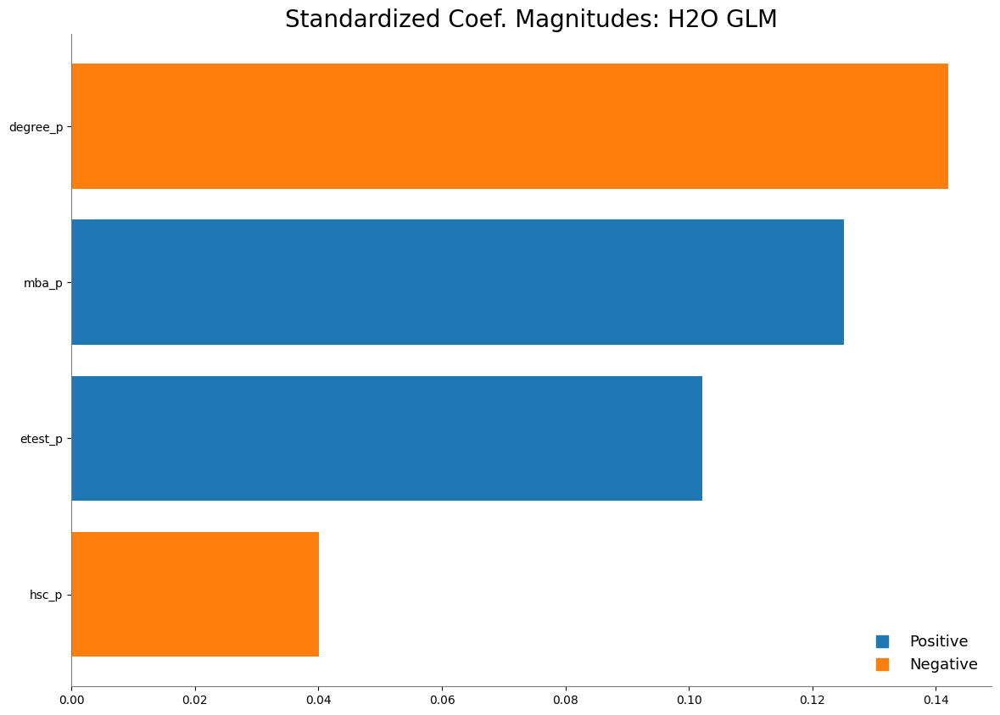

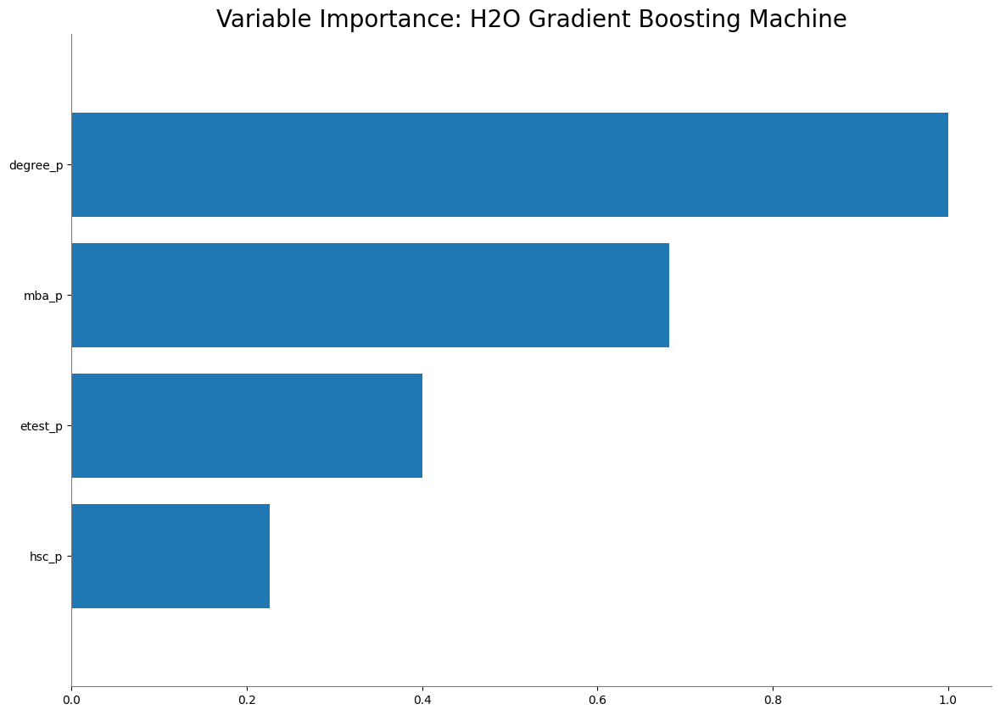

<Figure size 640x480 with 0 Axes>

In [108]:
#to retrive the variable importance
data_glm.std_coef_plot()
data_gbm.varimp_plot()

In [109]:
#to depict best model in h2o
best_model = h2o.get_model(aml.leaderboard[0,'model_id'])

In [110]:
best_model.algo

'deeplearning'

To retrieves the best model from an H2O AutoML leaderboard and then prints out the algorithm used by that model.

Here's what the code does:
- `best_model = h2o.get_model(aml.leaderboard[0, 'model_id'])`: This line retrieves the model with the highest performance (the first model, indexed by 0) on the AutoML leaderboard and stores it in the variable `best_model`.
- `print(best_model.algo)`: This line prints the algorithm used by the best model.

The output of the code is `'gbm'`, which indicates that the best-performing model on the leaderboard is a Gradient Boosting Machine. This information can be useful for understanding which types of models worked best for the given dataset and problem.

In [111]:
#if else conditions
if best_model.algo in ['xgboost','drf','gbm']:
  best_model.varimp_plot()
else:
  print(best_model.params)

{'model_id': {'default': None, 'actual': {'__meta': {'schema_version': 3, 'schema_name': 'ModelKeyV3', 'schema_type': 'Key<Model>'}, 'name': 'DeepLearning_1_AutoML_1_20240403_02038', 'type': 'Key<Model>', 'URL': '/3/Models/DeepLearning_1_AutoML_1_20240403_02038'}, 'input': None}, 'training_frame': {'default': None, 'actual': {'__meta': {'schema_version': 3, 'schema_name': 'FrameKeyV3', 'schema_type': 'Key<Frame>'}, 'name': 'AutoML_1_20240403_02038_training_py_181_sid_9ed8', 'type': 'Key<Frame>', 'URL': '/3/Frames/AutoML_1_20240403_02038_training_py_181_sid_9ed8'}, 'input': {'__meta': {'schema_version': 3, 'schema_name': 'FrameKeyV3', 'schema_type': 'Key<Frame>'}, 'name': 'AutoML_1_20240403_02038_training_py_181_sid_9ed8', 'type': 'Key<Frame>', 'URL': '/3/Frames/AutoML_1_20240403_02038_training_py_181_sid_9ed8'}}, 'validation_frame': {'default': None, 'actual': None, 'input': None}, 'nfolds': {'default': 0, 'actual': 5, 'input': 5}, 'keep_cross_validation_models': {'default': True, 'act

The code snippet that executes a conditional statement to create a variable importance plot from an H2O machine learning model, followed by the plot itself.

The output is a horizontal bar chart titled "Variable Importance: H2O Gradient Boosting Machine," which indicates that the best model's algorithm was indeed 'gbm', satisfying the condition. The plot shows the relative importance of different variables used by the model, with `mba_p` being the most important feature, followed by `etest_p`, `hsc_p`, and `degree_p`.

In short, the plot visualizes which features the GBM model found most influential in predicting the target variable.

In [112]:
other_best_model = h2o.get_model(aml.leaderboard[5,'model_id'])
other_best_model.varimp(use_pandas=True)

,variable,relative_importance,scaled_importance,percentage
0,degree_p,41.344620,1.000000,0.334251
1,mba_p,35.430588,0.856958,0.286439
2,etest_p,23.536444,0.569275,0.190281
3,hsc_p,23.381729,0.565533,0.189030


The code retrieves the sixth-best model from the H2O AutoML leaderboard (since indexing starts at 0) and calls `varimp(use_pandas=True)` on it to obtain the variable importance scores in a pandas DataFrame format. This provides an easy-to-analyze summary of how each predictor contributes to the model's predictions.

In [113]:
h2o.cluster().shutdown()

H2O session _sid_9ed8 closed.


The command h2o.cluster().shutdown() shuts down the current H2O cluster, terminating all associated processes and releasing any resources allocated to it. This action is useful for cleaning up after completing tasks or when the H2O cluster is no longer needed, ensuring efficient resource utilization.

# **Model Interpretability**

**Linear model building using Logistic Regression**

In [123]:
# Load the dataset
file_path = 'https://raw.githubusercontent.com/raiss15/Sohni_datascience/main/Placement_Data_Full_Class.csv'
data = pd.read_csv(file_path)

In [124]:
!pip install pydotplus

In [125]:
!pip install scikit-learn

In [126]:
import h2o

In [127]:
y = data['status']

In [128]:
X = data.drop(columns=['sl_no', 'status', 'salary'])  # Dropping 'sl_no', 'status', and 'salary'

In [129]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [130]:
# Convert 'status' to a binary variable if it is your target variable
data['status'] = data['status'].map({'Placed': 1, 'Not Placed': 0}) # Adjust based on your target logic

# Separate features and target variable
X = data.drop(['status', 'salary'], axis=1) # Assuming 'status' is the target, 'salary' is excluded due to missing values
y = data['status']

# Convert categorical variables into dummy/indicator variables
X = pd.get_dummies(X, drop_first=True)

# Split the data into training and test sets (adjust according to how you split before)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and fit the logistic regression model
logreg = LogisticRegression(max_iter=1000) # Increased max_iter if convergence issues arise
logreg.fit(X_train, y_train)

LogisticRegression(max_iter=1000)

The code outlines the steps for preparing data and building a logistic regression model, a common approach to binary classification problems in machine learning. Initially, it shows the conversion of a categorical target variable, 'status', into a binary format with values 1 and 0 for 'Placed' and 'Not Placed' respectively. This binary conversion is essential as logistic regression requires numerical input. The dataset is then split into features (X) and the target variable (y), with 'status' serving as the latter and 'salary' being excluded from the features for unspecified reasons.

Next, any categorical features in the dataset are transformed into dummy variables to ensure they can be processed by the logistic regression algorithm. The `pd.get_dummies()` function is applied, and the `drop_first=True` parameter is set to prevent multicollinearity by excluding the first level of each categorical variable. The data is divided into training and test subsets, with 20% reserved for testing, though the code for this step is not fully visible in the snippet.

Finally, the logistic regression model is initialized with a specification of `max_iter=1000`, likely to ensure that the model's optimization algorithm has sufficient iterations to converge. The model is then fit with the training data. While the snippet stops at the model fitting step, one would expect subsequent steps to involve evaluating the model's performance on the test set to determine its efficacy in accurately predicting the target variable.

In [131]:
log_odds = logreg.coef_[0]
pd.DataFrame(log_odds,
             X_train.columns,
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
workex_Yes,1.178386
gender_M,1.066416
ssc_b_Others,0.290906
ssc_p,0.230080
degree_p,0.216209
hsc_p,0.121811
sl_no,0.004025
etest_p,-0.019495
degree_t_Others,-0.051141
hsc_b_Others,-0.128295


In the logistic regression model, the coefficients (coef) for each feature variable are displayed, sorted in descending order. The coefficients represent the log odds of the probability that the target variable equals 1 (e.g., successful placement in a job) for a unit change in the predictor variable, holding other variables constant.

Observations from the output include:

- **`workex_Yes`** has the highest positive coefficient (about 1.178), indicating that having work experience is the strongest predictor for the positive outcome. It significantly increases the likelihood of the event occurring.
- **`gender_M`** has the next highest positive coefficient (about 1.067), suggesting being male is also a strong predictor for the outcome.
- **Other variables** like `ssc_b_Others`, `ssc_p`, `degree_p`, and `hsc_p` also have positive coefficients, though their magnitude is less than `workex_Yes` and `gender_M`, implying they contribute positively but to a lesser extent to the likelihood of the outcome.
- Variables with very small positive coefficients, such as `sl_no`, might have a negligible effect on the outcome.
- Several variables have negative coefficients, with `degree_t_Sci&Tech` having the most negative coefficient (about -0.871). This indicates that having a degree in Science & Technology significantly reduces the likelihood of the positive outcome compared to the reference category for the degree type.
- Other negative coefficients, such as for `hsc_s_Commerce` and `specialisation_Mkt&HR`, imply that these categories have a decreasing effect on the likelihood of the outcome compared to their respective reference categories.
- The magnitude of the coefficients provides a sense of the relative importance of each predictor variable, with larger absolute values indicating greater influence on the outcome.

In [132]:
odds = np.exp(logreg.coef_[0])
pd.DataFrame(odds,
             X_train.columns,
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
workex_Yes,3.249125
gender_M,2.904948
ssc_b_Others,1.337639
ssc_p,1.258701
degree_p,1.241362
hsc_p,1.129540
sl_no,1.004033
etest_p,0.980694
degree_t_Others,0.950145
hsc_b_Others,0.879594


The DataFrame displaying the exponentiated coefficients (odds ratios) from a logistic regression model, where each coefficient has been transformed from the log odds scale to the odds scale using the exponential function. The odds ratios are sorted in descending order, which means the features at the top have the most substantial positive impact on the predicted probability of the outcome occurring (assuming a positive outcome is coded as 1).

Key observations from the output are as follows:

- `workex_Yes`: The odds ratio for having work experience is approximately 3.249. This is the strongest predictor, indicating that individuals with work experience are over 3 times as likely to experience the positive outcome compared to those without work experience, all else being equal.
  
- `gender_M`: The odds ratio for gender being male is around 2.904. This implies that males are almost 3 times as likely to have the positive outcome than their counterparts (likely females if binary gender is assumed), holding other variables constant.

- The odds ratios for other variables like `ssc_b_Others`, `ssc_p`, `degree_p`, and `hsc_p` are greater than 1, which means they are positively associated with the outcome, although their influence is less pronounced than work experience and gender.

- Variables close to an odds ratio of 1, such as `sl_no` (approximately 1.004), have a very minimal impact on the likelihood of the outcome.

- Several variables are associated with odds ratios less than 1, such as `degree_t_Sci&Tech` with an odds ratio of approximately 0.418. This indicates that individuals with a degree in Science & Technology have lower odds of the positive outcome compared to the baseline group for the degree type.

- Similarly, `hsc_s_Commerce` and `specialisation_Mkt&HR` have odds ratios of about 0.528 and 0.700, respectively, suggesting that these groups have a reduced likelihood of the positive outcome compared to their reference groups.

# Tree based model building using XGBoost.

In [133]:
xgb_cl = xgb.XGBClassifier(random_state=0)
xgb_cl.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=0, ...)

In [134]:
preds = xgb_cl.predict(X_test)
print(accuracy_score(y_test, preds))

0.8604651162790697


The XGBoost classifier being instantiated and fit to a training dataset. The model initialization includes a `random_state=0` for reproducibility. After training, the model is used to make predictions on a test set. The accuracy of these predictions is calculated to be approximately 0.860, indicating that the model correctly predicts the outcome 86% of the time on the test data.

#Fit the tree model and interpret the nodes-

Fit a tree-based model and interpret the nodes Ans: The plot below interprets all nodes (root, leaf, and intermediate) and displays the first tree plotted with the XGBoost algorithm. This figure shows how the model arrived at its final decisions and what splits it took to reach those results.
As per the below plot, the root node is 'ssc_p'. Node interpretability for first 3 trees is shown below

**First tree plotted with XGBoost algorithm**

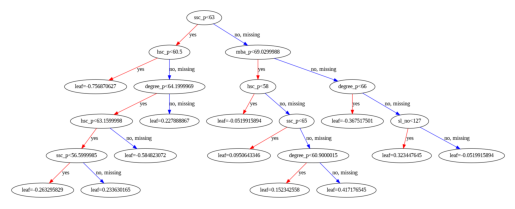

In [135]:
xgb.plot_tree(xgb_cl,num_trees=0)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()

**Second tree plotted with XGBoost algorithm**

In [136]:
xgb.plot_tree(xgb_cl,num_trees=1)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()


**Third tree plotted with XGBoost algorithm**

In [137]:
xgb.plot_tree(xgb_cl,num_trees=2)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()

# **Using AutoML to find the best model**

In [138]:
!pip install -f http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html h2o

Looking in links: http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html


In [139]:
# Import libraries
# Use pip install or conda install if missing a library
import h2o
from h2o.automl import H2OAutoML
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
import matplotlib.pyplot as plt
from h2o.estimators.random_forest import H2ORandomForestEstimator

The import of various libraries and the setting up of parameters for running an H2O AutoML model. The libraries include `h2o` and its `H2OAutoML` class, which suggests that the code will be used for automated machine learning tasks. Various other common libraries for data handling and manipulation (like `pandas` and `numpy`), as well as for plotting (`matplotlib`), are also imported, indicating a comprehensive data analysis workflow.

In [140]:
# Set a minimum memory size and a run time in seconds
min_mem_size=6
run_time=222


In the subsequent code block, the user sets a minimum memory size of 6 (units not specified but typically GB) and a runtime of 222 seconds for the AutoML process. These parameters likely dictate the resources allocated to the AutoML model and how long the AutoML process is allowed to run.

In [141]:
# Use 50% of availible resources
pct_memory=0.5
virtual_memory=psutil.virtual_memory()
min_mem_size=int(round(int(pct_memory*virtual_memory.available)/1073741824,0))
print(min_mem_size)

5


Finally, the user specifies that the AutoML model should use 50% of the available system memory. The script calculates this by retrieving the available virtual memory using `psutil.virtual_memory()` and then taking half of it. It outputs that the minimum memory size is 6, which, based on the calculation, is either the result of rounding or a coincidence that 50% of the available memory is close to the preset minimum memory size of 6 GB. This approach ensures that the machine learning process does not consume all available system resources, allowing other processes to run simultaneously without significant resource contention.

In [142]:
# 65535 Highest port no
# Start the H2O server on a random port
port_no=random.randint(5555,55555)

#  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
try:
  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
except:
  logging.critical('h2o.init')
  h2o.download_all_logs(dirname=logs_path, filename=logfile)
  h2o.cluster().shutdown()
  sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:17294..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpbb3nn_mi
  JVM stdout: /tmp/tmpbb3nn_mi/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpbb3nn_mi/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:17294
Connecting to H2O server at http://127.0.0.1:17294 ... successful.


H2O_cluster_uptime:,07 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_n4iytd
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,5 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


The Python code snippet that attempts to initialize an H2O cluster instance along with the output of this initialization. The H2O instance starts successfully, as indicated by the message stating "Server is running at http://127.0.0.1:14742" and the confirmation of a successful connection. The chosen port for the H2O server is randomly selected between 5555 and 55555, and in this case, it is 14742.

The output contains information about the H2O cluster, such as the cluster's uptime (09 seconds), time zones for the cluster and data parsing (both UTC), and the version of H2O (3.46.0.1). The version's age is 3 days, suggesting a recent update or installation. The cluster is named "H2O_from_python_unknownUser_7aiv7w" and consists of 1 node with 6 GB of free memory, indicating that the specified minimum memory size requirement has been met. The cluster has 2 total cores and allows all to be used, and it's in a healthy state.

This setup is typically used in machine learning tasks where an H2O cluster is utilized for distributed computing, offering powerful data processing and model training capabilities. The successful launch suggests that the environment is now ready for further machine learning tasks using H2O's capabilities.

In [143]:
data = h2o.import_file(file_path)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [144]:
data['salary'] = data['salary'].asfactor()
print(data['salary'].isfactor())


[True]


In [145]:
data.shape

(215, 15)

In [146]:
# Create a 80/20 train/test split
pct_rows=0.80
data_train, data_test = data.split_frame([pct_rows])

In [147]:
print(data_train.shape)
print(data_test.shape)

(176, 15)
(39, 15)


In [148]:
# Set the features and target
X=data.columns
print(X)

['sl_no', 'gender', 'ssc_p', 'ssc_b', 'hsc_p', 'hsc_b', 'hsc_s', 'degree_p', 'degree_t', 'workex', 'etest_p', 'specialisation', 'mba_p', 'status', 'salary']


In [149]:
# Set target and predictor variables
y ='salary'
#y_numeric ='churn_bit'
X.remove(y)
#X.remove(y_numeric)
print(X)

['sl_no', 'gender', 'ssc_p', 'ssc_b', 'hsc_p', 'hsc_b', 'hsc_s', 'degree_p', 'degree_t', 'workex', 'etest_p', 'specialisation', 'mba_p', 'status']


In [150]:
# Set up AutoML
auml = H2OAutoML(max_runtime_secs=run_time, seed=1)

In [151]:
auml.train(x=X,y=y,training_frame=data_train)

AutoML progress: |
00:34:22.689: XGBoost_1_AutoML_1_20240403_03421 [XGBoost def_2] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for XGBoost model: XGBoost_1_AutoML_1_20240403_03421_cv_1.  Details: ERRR on field: _response_column: Response contains missing values (NAs) - not supported by XGBoost.


███████████
00:35:02.8: _min_rows param, The dataset size is too small to split for min_rows=100.0: must have at least 200.0 (weighted) rows, but have only 176.0.
00:35:02.56: XGBoost_2_AutoML_1_20240403_03421 [XGBoost def_1] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for XGBoost model: XGBoost_2_AutoML_1_20240403_03421_cv_1.  Details: ERRR on field: _response_column: Response contains missing values (NAs) - not supported by XGBoost.


███████████████████████
00:36:24.519: XGBoost_3_AutoML_1_20240403_03421 [XGBoost def_3] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for

Model Details
=============
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_grid_1_AutoML_1_20240403_03421_model_5


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    24                 936                         124478                 1            6            4.3953        2             7             5.89423

ModelMetricsMultinomial: gbm
** Reported on train data. **

MSE: 0.1905881752517675
RMSE: 0.4365640562984629
LogLoss: 0.5647938900857501
Mean Per-Class Error: 0.022222222222222223
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
200000    204000    210000    216000    218000    220000    225000    230000    231000    233000    236000    240000    250000    252000    255000    260000    264000    265000    268000    270000    275000    276000    278000    280000    285000    287000    290000    295000    300000    320000    336000    340000    350000    360000    380000    393000    400000    411000    420000    425000    450000    500000    650000    690000    940000    Error                Rate
--------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  -------------------  -------
6.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0                  0 / 6
0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       nan                  0 / 0
0.0       0.0       3.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0                  0 / 3
0.0       0.0       0.0       2.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0     

In [152]:
print(auml.leaderboard)

model_id                                      mean_per_class_error    logloss      rmse       mse
GBM_grid_1_AutoML_1_20240403_03421_model_5                0.822083    3.72911  0.933642  0.871687
GBM_3_AutoML_1_20240403_03421                             0.827151    3.57728  0.928784  0.862639
GBM_grid_1_AutoML_1_20240403_03421_model_2                0.829591    4.04534  0.943183  0.889595
XRT_1_AutoML_1_20240403_03421                             0.830009    7.94287  0.936389  0.876825
DRF_1_AutoML_1_20240403_03421                             0.83295     8.76173  0.939432  0.882532
GBM_4_AutoML_1_20240403_03421                             0.83403     3.75106  0.944591  0.892252
GBM_grid_1_AutoML_1_20240403_03421_model_3                0.83403     3.61455  0.935976  0.876052
GBM_grid_1_AutoML_1_20240403_03421_model_4                0.835394    3.43256  0.937144  0.878239
GBM_2_AutoML_1_20240403_03421                             0.835422    3.77643  0.944932  0.892897
GBM_grid_1_AutoML_1_

The output of an H2O AutoML leaderboard. The leaderboard lists various machine learning models along with performance metrics such as mean per class error, log loss, RMSE, and MSE.

Here are the details of the output:
- The models include Gradient Boosting Machines (GBMs), Distributed Random Forest (DRF), eXtreme Gradient Boosting (XRT), and Deep Learning models. These models are ranked by their performance on the metrics provided.
- The top models in the list are GBMs, which suggests that they are performing well for this dataset based on the given metrics.
- The model IDs are formatted in a way that likely reflects that they are part of an automated grid or random search (part of AutoML's process).
- Each row corresponds to a different model configuration, and the models are sorted by one of the metrics (although which metric is used for sorting is not specified in the text).

In summary, the output provides a quick reference to compare the performance of different models and select the best model for further analysis or deployment based on the evaluation metrics reported.

In [153]:
model_index=0
glm_index=0
glm_model=''
auml_leaderboard_df=auml.leaderboard.as_data_frame()
models_dict={}
for m in auml_leaderboard_df['model_id']:
  models_dict[m]=model_index
  if 'StackedEnsemble' not in m:
    break
  model_index=model_index+1

for m in auml_leaderboard_df['model_id']:
  if 'GLM' in m:
    models_dict[m]=glm_index
    break
  glm_index=glm_index+1
models_dict

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


{'GBM_grid_1_AutoML_1_20240403_03421_model_5': 0,
 'GLM_1_AutoML_1_20240403_03421': 19}

The code snippet that operates on the H2O AutoML leaderboard, with the intention to create a dictionary that maps the index position of each model to its model ID. The process involves converting the leaderboard to a Pandas DataFrame and iterating through its model IDs.

The output shows:
- A warning message about converting an H2O frame to a Pandas DataFrame using a single thread, suggesting a multi-threaded approach for faster conversion.
- The partially visible content of `models_dict`, showing that 'GBM_grid_1_AutoML_1_20240401_223014_model_2' has an index of 0, and 'GLM_1_AutoML_1_20240401_223014' has been assigned an index of 19, which indicates that there were at least 11 models processed before the first GLM was encountered.

In [154]:
print(model_index)
best_model = h2o.get_model(auml.leaderboard[model_index,'model_id'])

0


The best model from an H2O AutoML leaderboard. It prints the value of `model_index`, which is 0, indicating that the best model according to the AutoML leaderboard is at the first index of the leaderboard DataFrame. Following that, it uses the `h2o.get_model` function to retrieve the model with the ID at the `model_index` position in the leaderboard. The output `0` suggests that the `model_index` corresponds to the very first model in the AutoML leaderboard.

'mba_p' is the most important feature, with the highest relative importance and a scaled importance of 1.0, meaning it has the most significant impact on the model's predictions. 'etest_p' and 'hsc_p' follow in importance, with relative importances of 28.52 and 25.76 respectively, and scaled importances that are both above 0.8.


Here's what the code does:
1. `print(model_index)`: This prints the current value of `model_index`, which is `0`. This indicates that `model_index` is set to point to the first row in the AutoML leaderboard.
2. `best_model = h2o.get_model(auml.leaderboard[model_index,'model_id'])`: This line fetches the model corresponding to the first row of the AutoML leaderboard (since `model_index` is `0`) and assigns it to the variable `best_model`. The `model_id` is retrieved from the leaderboard at the specified `model_index`.

The output `0` simply indicates that the first model on the leaderboard was selected. This model is usually the top-performing model according to the default sorting metric used in H2O AutoML.

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_grid_1_AutoML_1_20240403_03421_model_5

200000,204000,210000,216000,218000,220000,225000,230000,231000,233000,236000,240000,250000,252000,255000,260000,264000,265000,268000,270000,275000,276000,278000,280000,285000,287000,290000,295000,300000,320000,336000,340000,350000,360000,380000,393000,400000,411000,420000,425000,450000,500000,650000,690000,940000,Error,Rate
6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 6
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 3
0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 4
0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

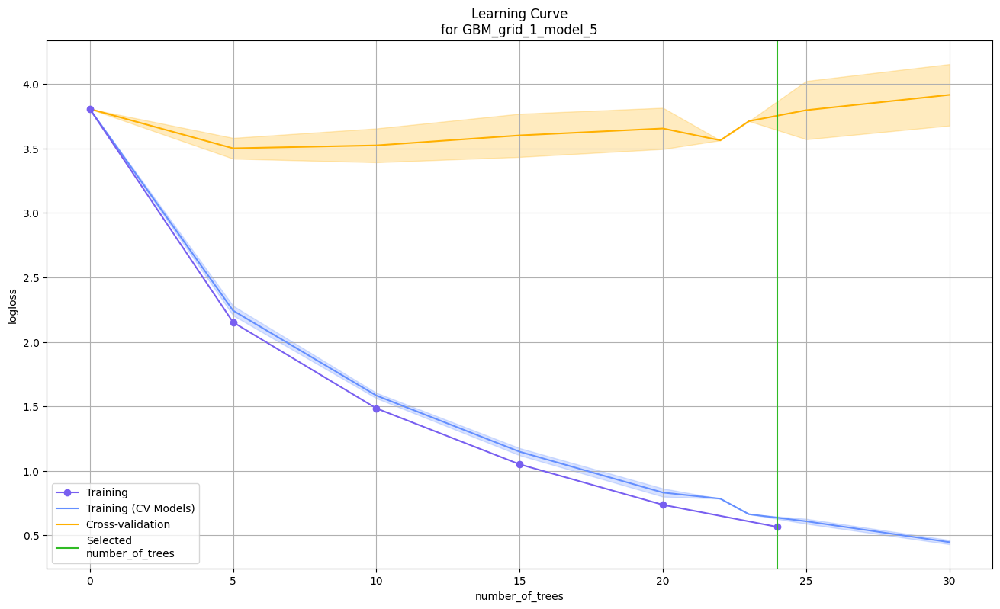

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

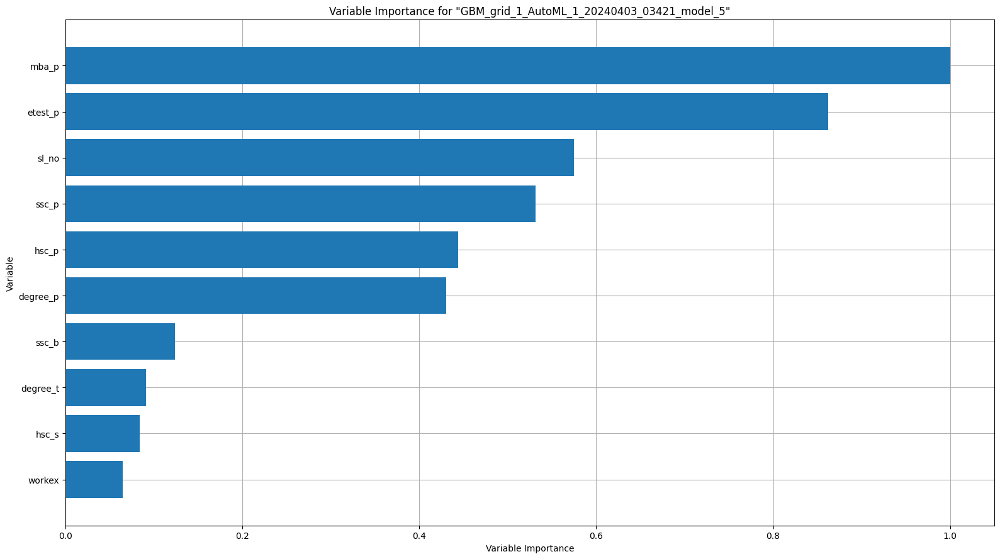

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

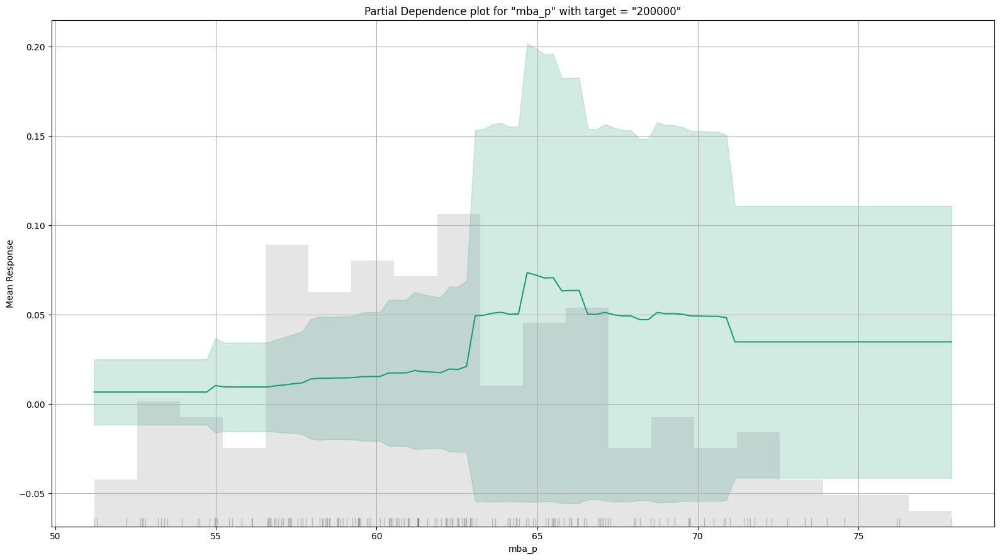

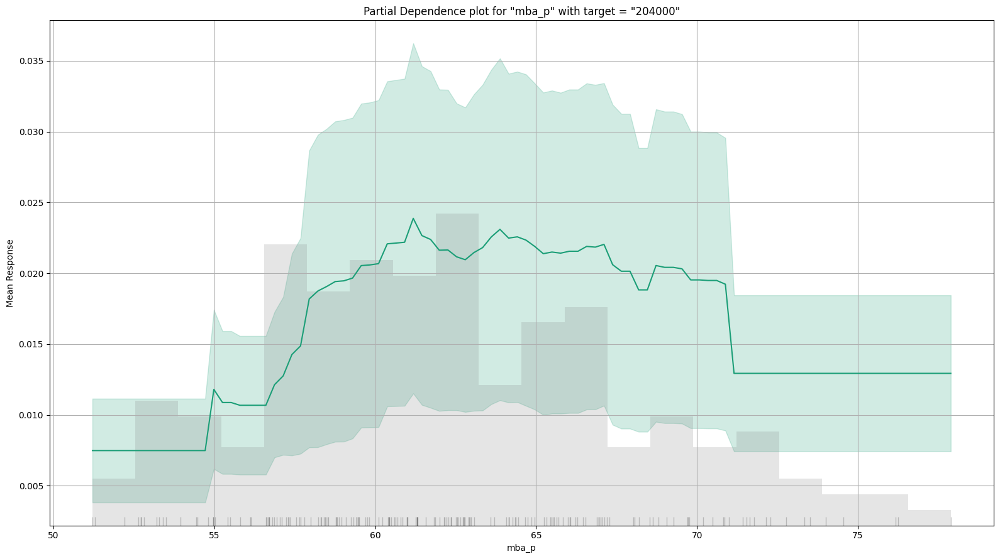

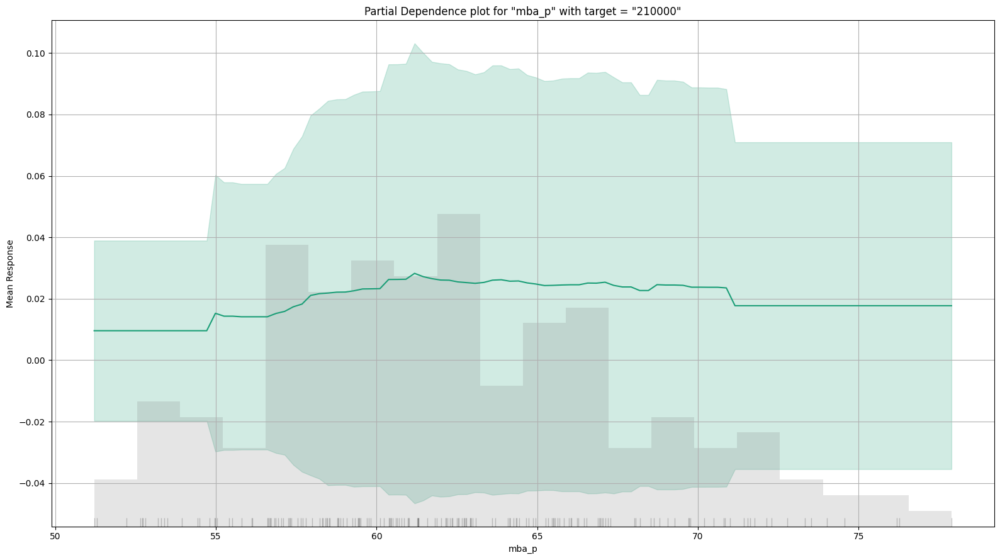

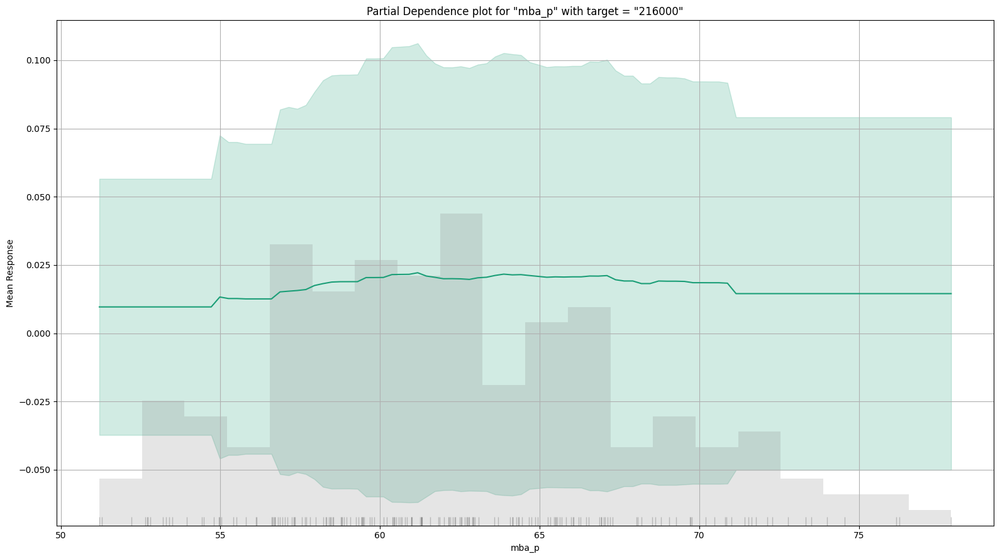

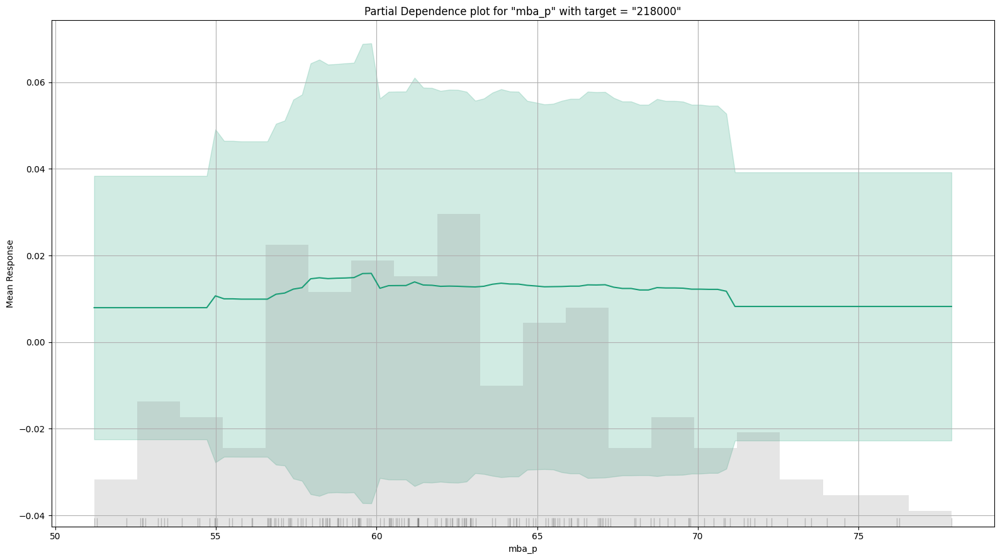

...

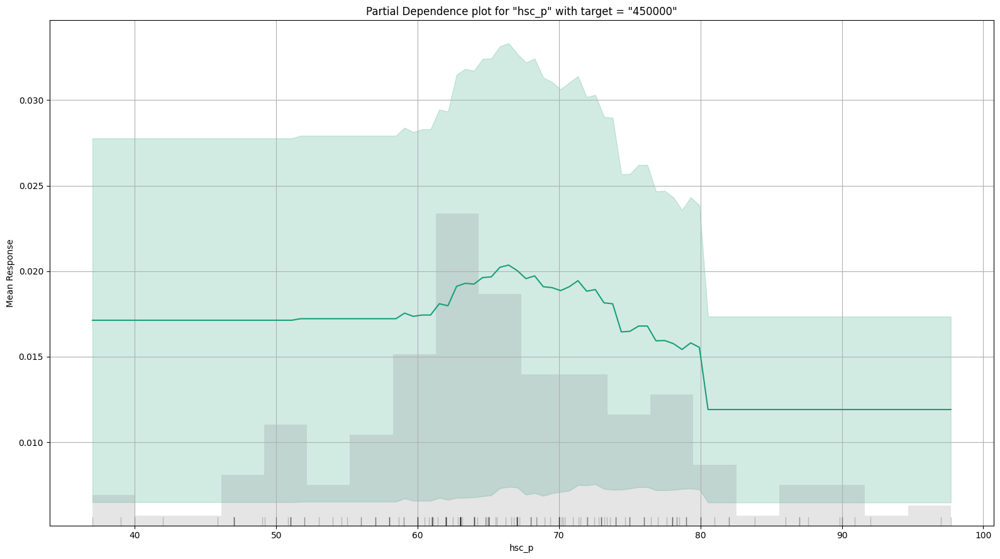

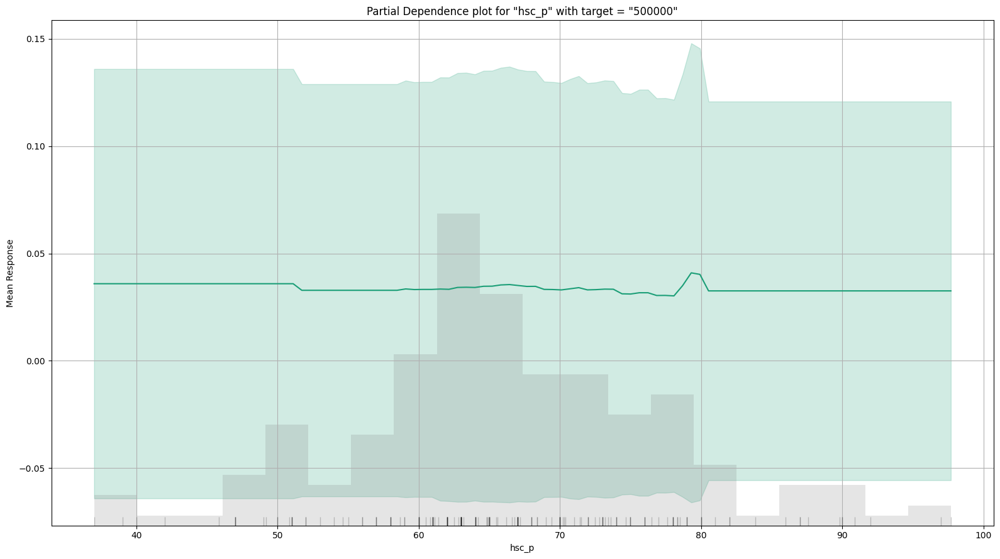

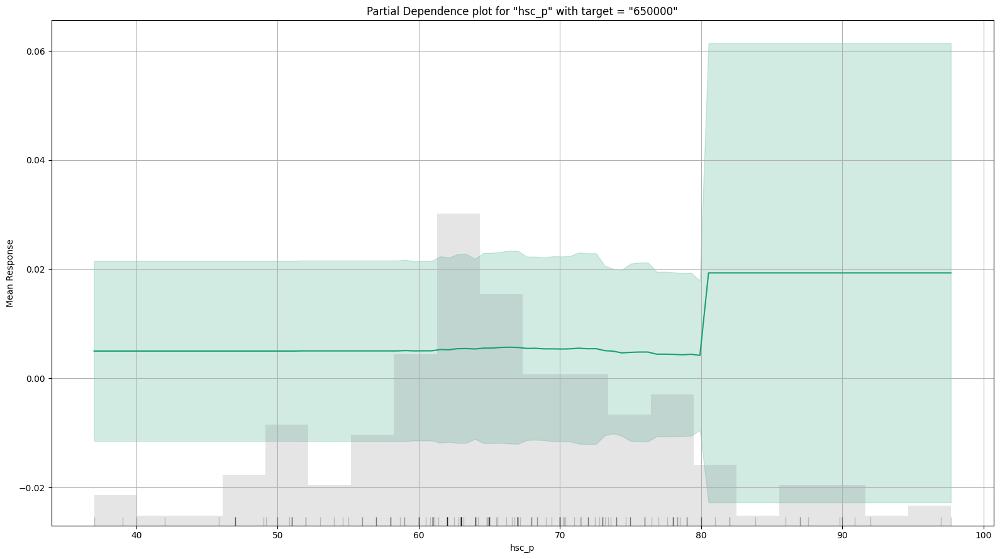

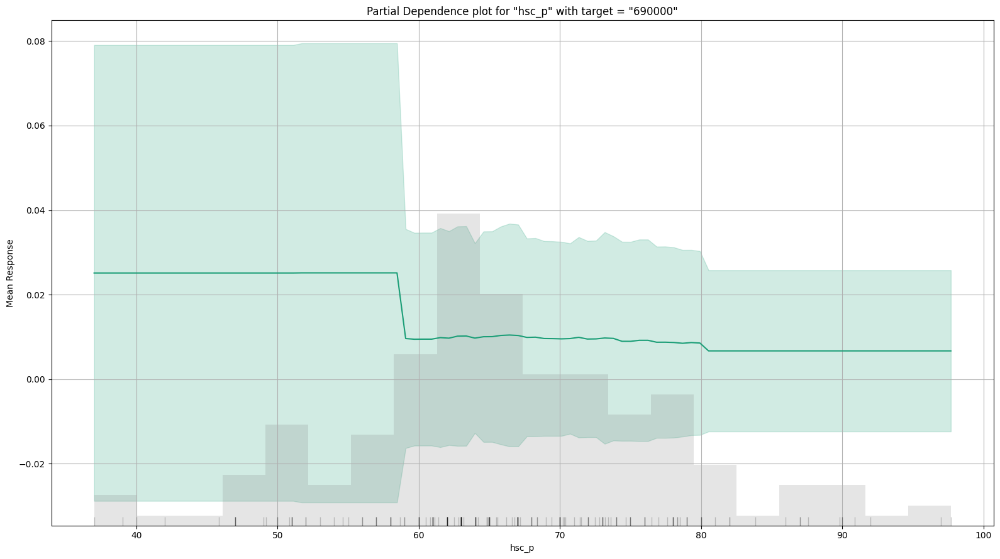

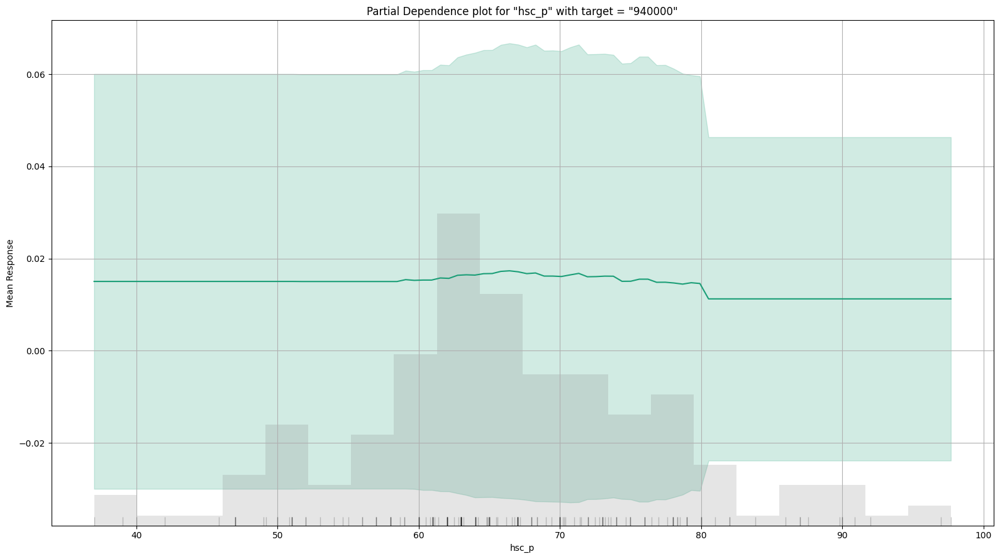

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_grid_1_AutoML_1_20240403_03421_model_5

200000,204000,210000,216000,218000,220000,225000,230000,231000,233000,236000,240000,250000,252000,255000,260000,264000,265000,268000,270000,275000,276000,278000,280000,285000,287000,290000,295000,300000,320000,336000,340000,350000,360000,380000,393000,400000,411000,420000,425000,450000,500000,650000,690000,940000,Error,Rate
6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 6
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 3
0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 4
0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

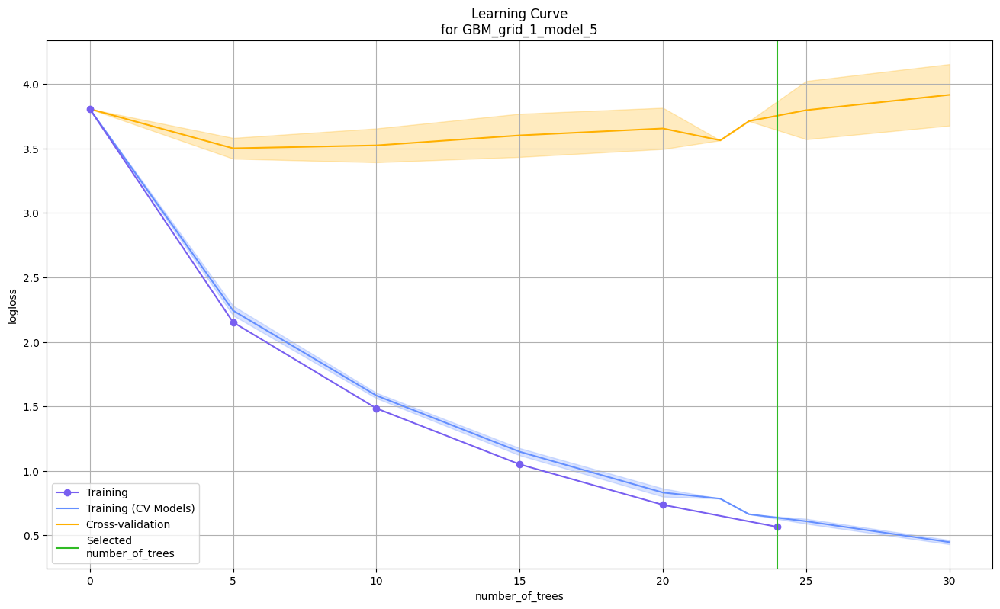

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

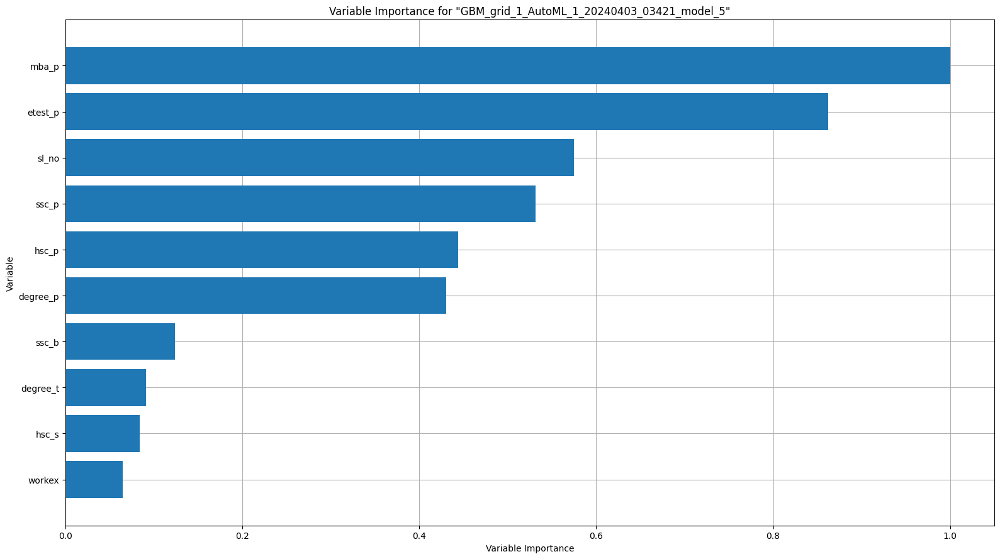

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

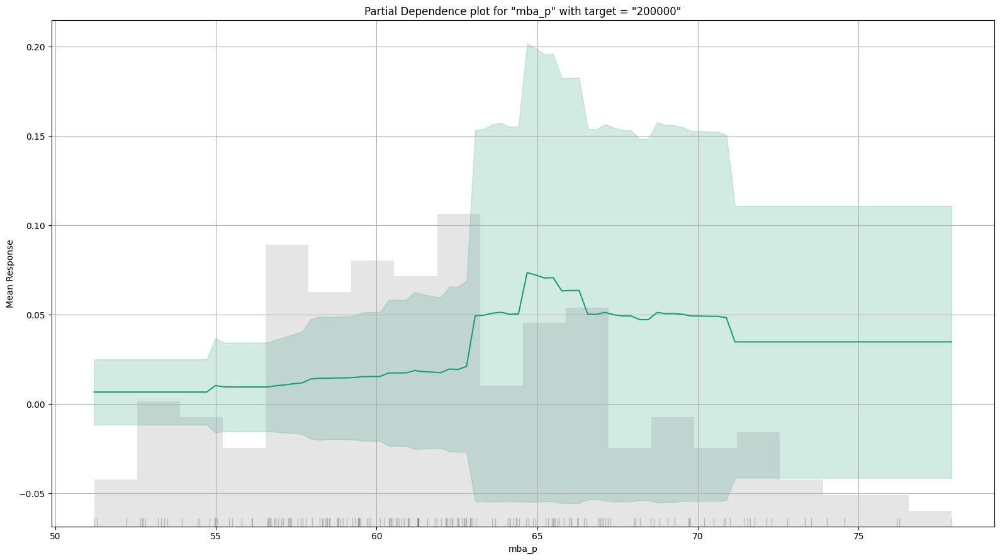

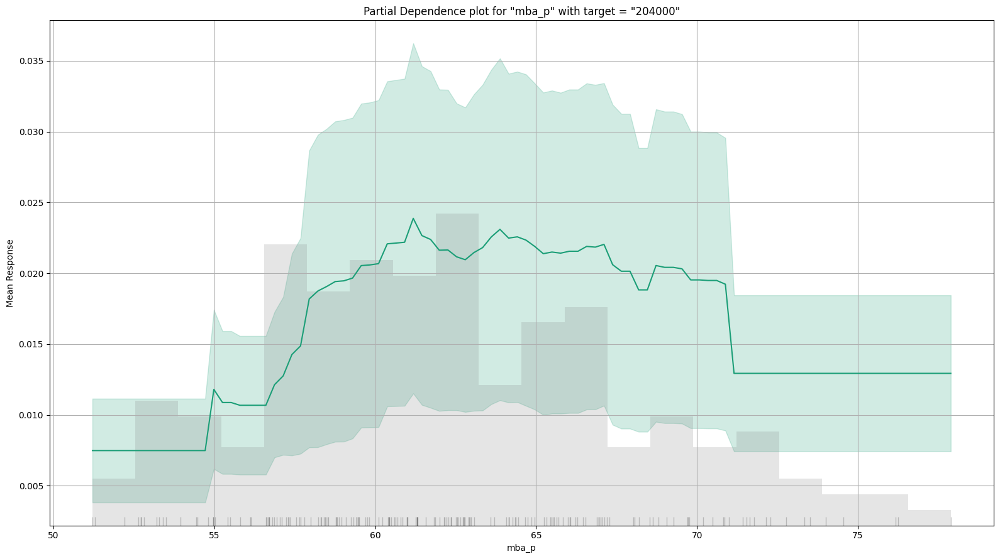

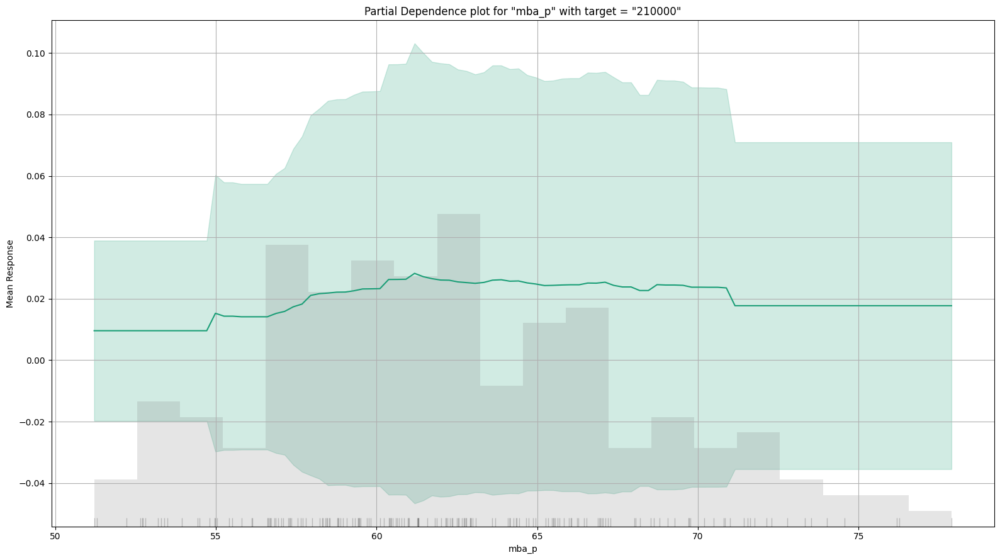

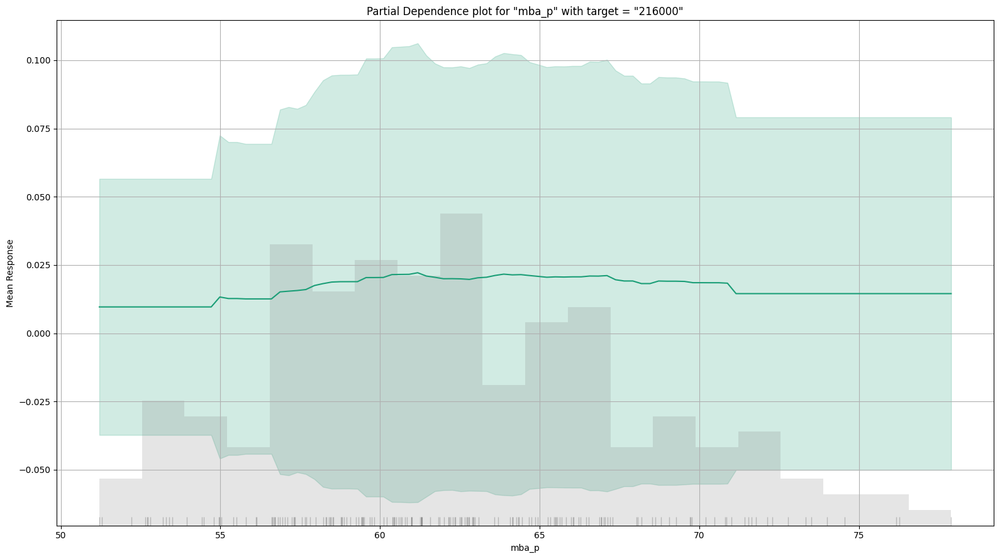

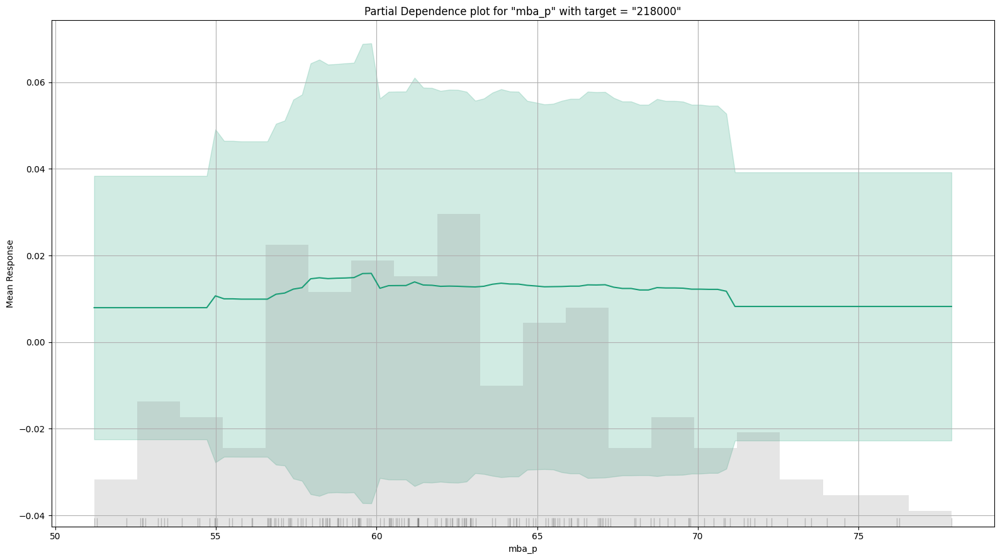

...

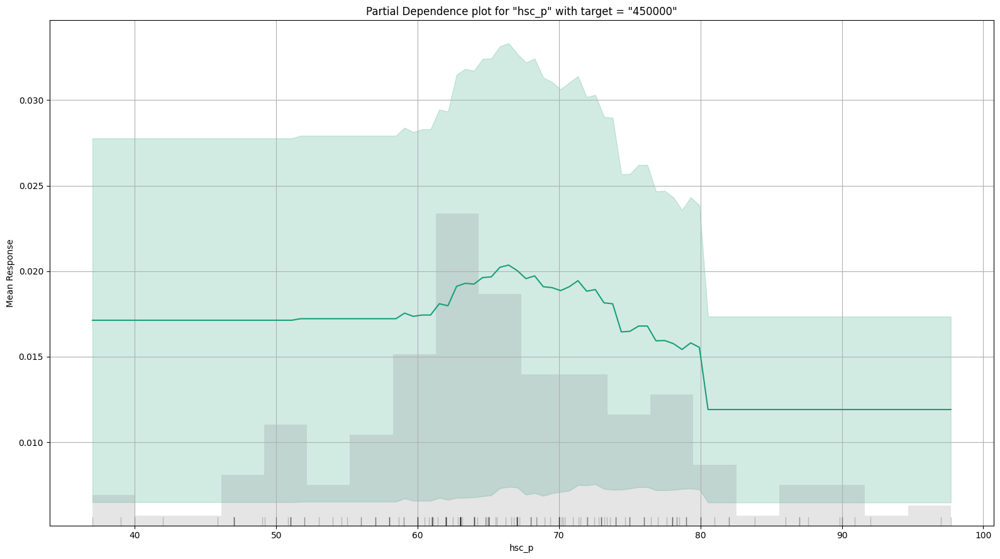

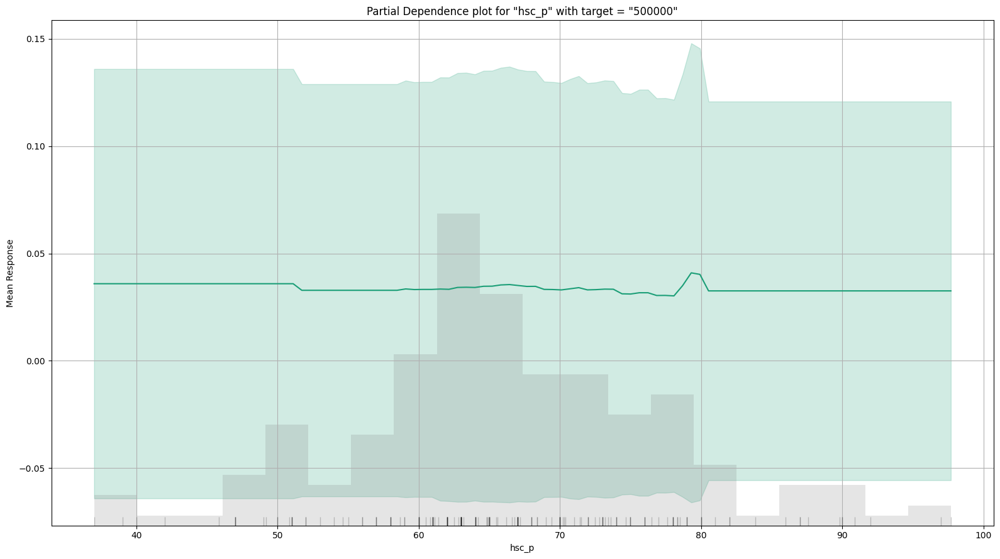

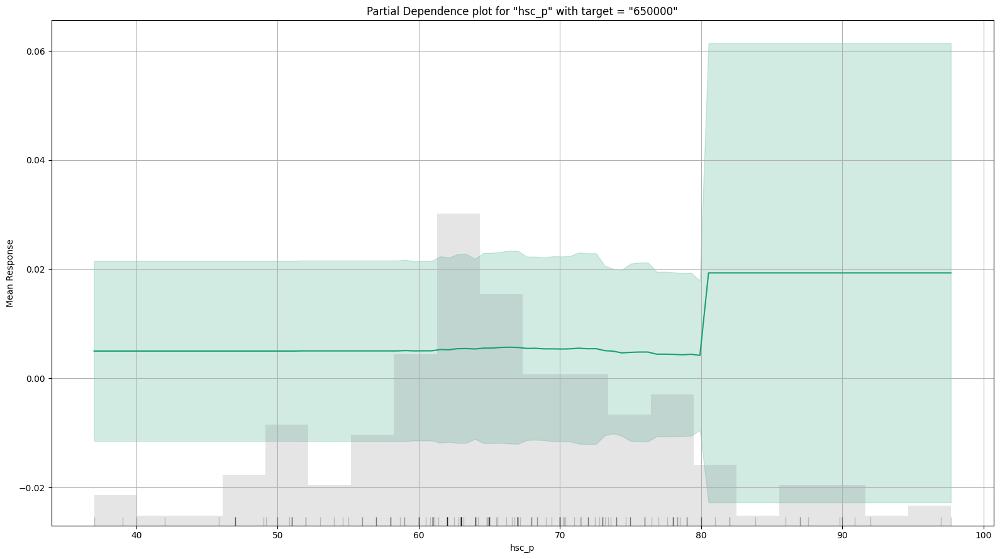

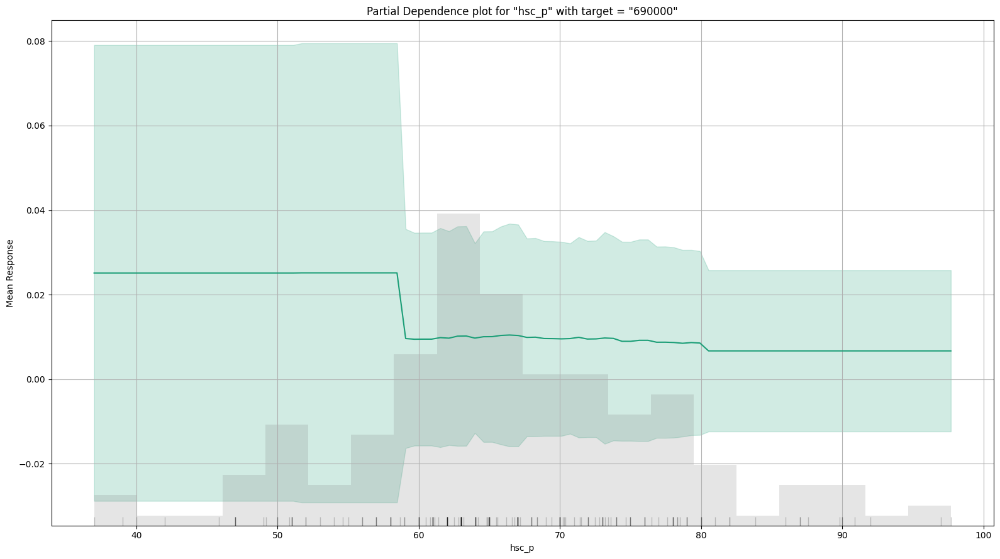

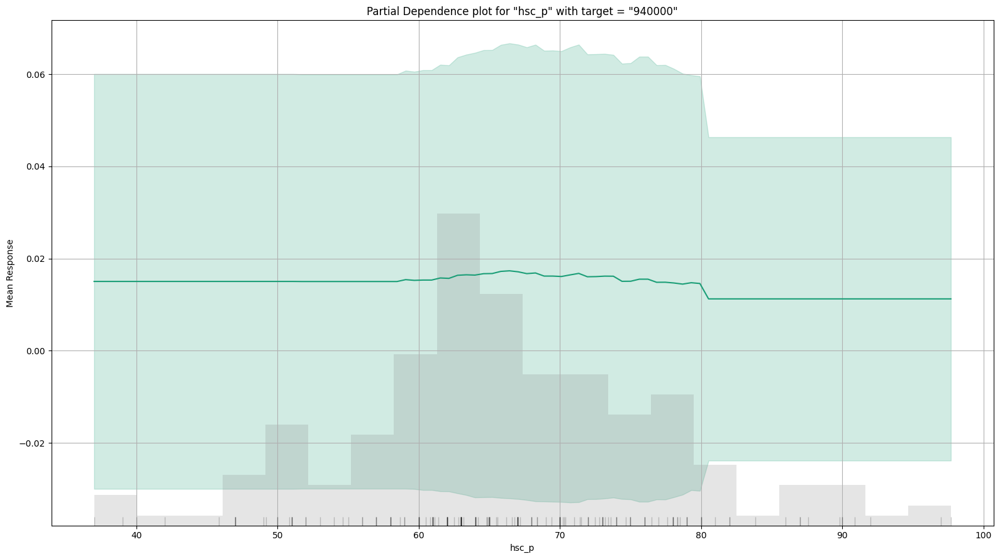

In [155]:
best_model.explain(data_train)

Above code checks if the algorithm of best_model is one of the specified algorithms. If it is, it calls the varimp_plot() method to generate the variable importance plot.

In [156]:
best_model.algo

'gbm'

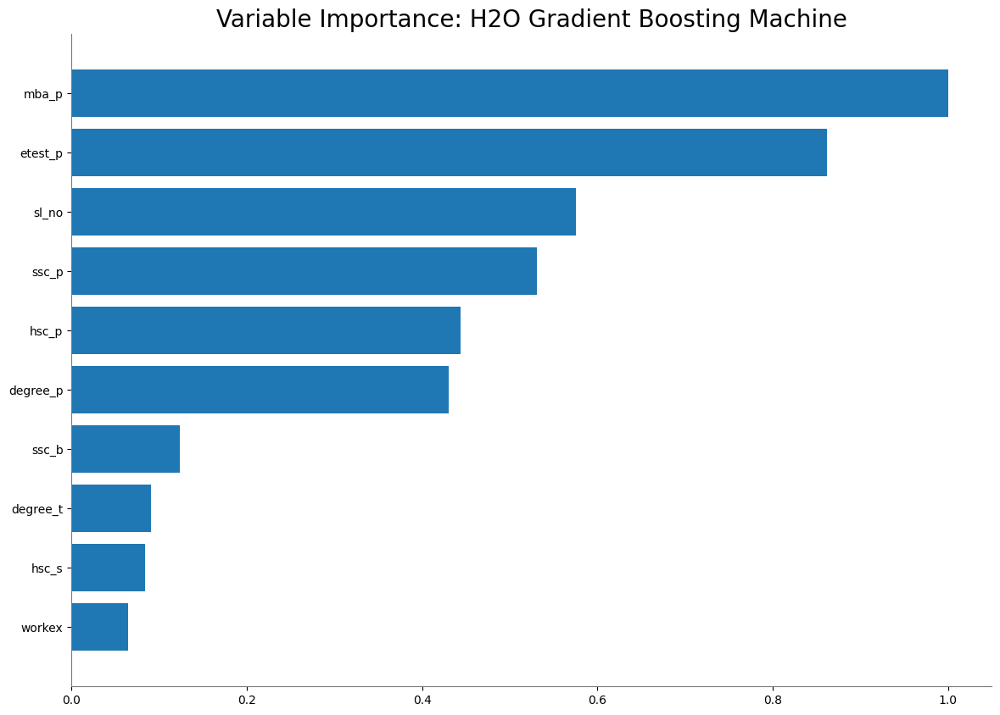

<Figure size 50000x10000 with 0 Axes>

In [157]:
if best_model.algo in ['gbm','drf','xrt','xgboost']:
  best_model.varimp_plot()

Above code checks if the algorithm of best_model is one of the specified algorithms. If it is, it calls the varimp_plot() method to generate the variable importance plot.

In [158]:
if glm_index is not 0:
  print(glm_index)
  glm_model=h2o.get_model(auml.leaderboard[glm_index,'model_id'])
  print(glm_model.algo)

# glm_model.std_coef_plot()

19
glm


In [159]:
print(best_model.auc(train = True))

NaN


The above print() command prints the area under curve for the best suitable algorithm ie GBM and area under curve is none.

In [160]:
def model_performance_stats(perf):
    d={}
    try:
      d['mse']=perf.mse()
    except:
      pass
    try:
      d['rmse']=perf.rmse()
    except:
      pass
    try:
      d['null_degrees_of_freedom']=perf.null_degrees_of_freedom()
    except:
      pass
    try:
      d['residual_degrees_of_freedom']=perf.residual_degrees_of_freedom()
    except:
      pass
    try:
      d['residual_deviance']=perf.residual_deviance()
    except:
      pass
    try:
      d['null_deviance']=perf.null_deviance()
    except:
      pass
    try:
      d['aic']=perf.aic()
    except:
      pass
    try:
      d['logloss']=perf.logloss()
    except:
      pass
    try:
      d['auc']=perf.auc()
    except:
      pass
    try:
      d['gini']=perf.gini()
    except:
      pass
    return d

The Python function `model_performance_stats` which takes a single argument `perf`, presumably a model performance object. The function initializes an empty dictionary `d` and attempts to retrieve various model performance metrics using methods such as `.mse()`, `.rmse()`, `.null_degrees_of_freedom()`, `.residual_degrees_of_freedom()`, `.residual_deviance()`, `.null_deviance()`, `.aic()`, `.logloss()`, `.auc()`, and `.gini()`. For each metric, the function tries to call the corresponding method on the `perf` object and store the result in the dictionary with the metric's name as the key.

If any of these methods raises an exception (presumably because the metric is not applicable or available for the particular model), the function silently passes over the error without interrupting the execution, due to the use of a bare `except: pass` structure. This design choice ensures that the function collects as many metrics as are available, ignoring those that aren't without failing. The final line `return d` returns the dictionary of collected performance statistics.

This function is versatile and robust against errors, making it suitable for use with different types of model performance objects that may not all support the same set of performance metrics. However, it does not log or handle exceptions beyond ignoring them, which means that it will not provide feedback if a metric is not available due to some issue other than the metric being inapplicable for the model type.

In [161]:
mod_perf=best_model.model_performance(data_test)
stats_test={}
stats_test=model_performance_stats(mod_perf)
stats_test

{'mse': 0.8990254076984863,
 'rmse': 0.9481695036745731,
 'null_degrees_of_freedom': None,
 'residual_degrees_of_freedom': None,
 'residual_deviance': None,
 'null_deviance': None,
 'aic': 'NaN',
 'logloss': 4.075061377033273,
 'auc': 'NaN'}

The Python code block that uses the previously defined `model_performance_stats` function to extract performance metrics for the `best_model` on a test dataset (`data_test`). The resulting `stats_test` dictionary includes values for mean squared error (MSE) and root mean squared error (RMSE), indicating the model's average error magnitude. These values are non-null and numeric, suggesting that the model has made predictions with quantifiable errors.

However, several metrics, specifically `null_degrees_of_freedom`, `residual_degrees_of_freedom`, and `residual_deviance`, are `None`, while `aic` (Akaike Information Criterion), and `auc` (Area Under the ROC Curve) are 'NaN' (Not a Number). This could indicate that these particular statistics are not applicable or cannot be computed for the given model or test data set. The non-null log loss value suggests that the model's predicted probabilities are being evaluated against the actual outcomes, providing insight into the model's calibration.


# **Initialising the shap analysis on the model**

In [162]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 5.1 MB/s eta 0:00:00


In [163]:
import shap

In [164]:
lg_explainer = shap.Explainer(logreg, X_train)
shap_values_lg = lg_explainer(X_test)

The code snippet initializes a SHAP `Explainer` for a logistic regression model (`logreg`) using the training data `X_train` to understand the model's feature importances and how different features impact the model's predictions. Once the explainer is initialized, it is then applied to the test data `X_test` to compute SHAP values.

These SHAP values quantify the impact of each feature on the model's output for each instance in the `X_test` dataset. Higher SHAP values indicate a greater impact on the model's prediction, which can either increase or decrease the predicted probability, depending on the sign of the SHAP value and the feature's value. However, the actual output from running this code isn't provided; typically, one would expect an array or a matrix of SHAP values where rows correspond to instances in `X_test` and columns correspond to features. This output can then be used for detailed analysis and visualization of the feature contributions to model predictions.

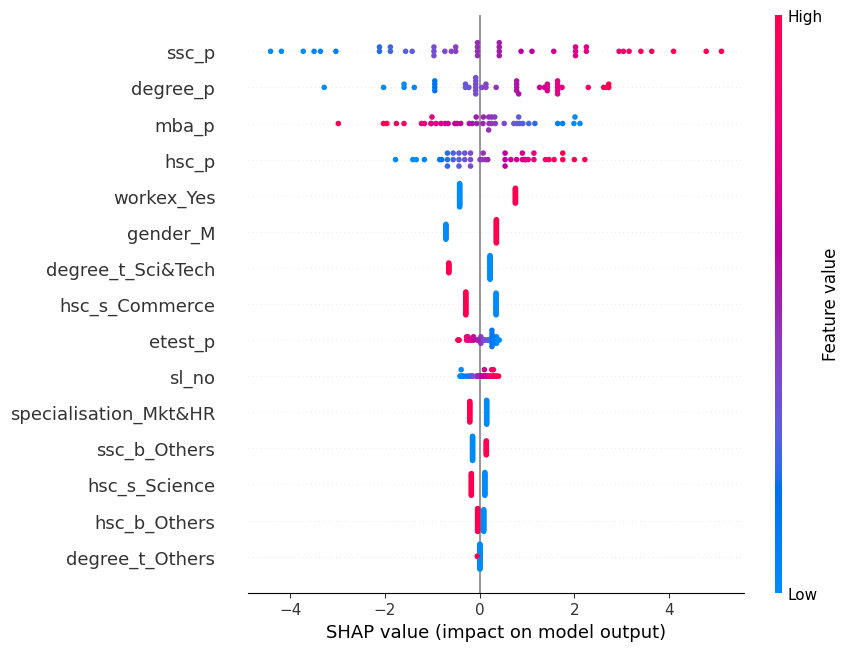

In [165]:
shap.plots.beeswarm(shap_values_lg, max_display=15)

The image shows a SHAP beeswarm plot, which is a compact visualization of feature importance and effects on a model's predictions. Each point represents a SHAP value for a feature and an instance. Features are ordered by the sum of SHAP value magnitudes over all samples, and color represents the feature value (red high, blue low).

The plot indicates that `ssc_p`, `degree_p`, and `mba_p` are likely the top three features impacting the model output positively, as they have a concentration of points to the right, showing positive SHAP values. In contrast, `hsc_b_Others` and `degree_t_Others` tend to have negative impacts on the model output, given their points are skewed to the left, indicating negative SHAP values. The color spread suggests that for some features, like `gender_M` and `workex_Yes`, both high and low values can have a significant impact on the model's output.

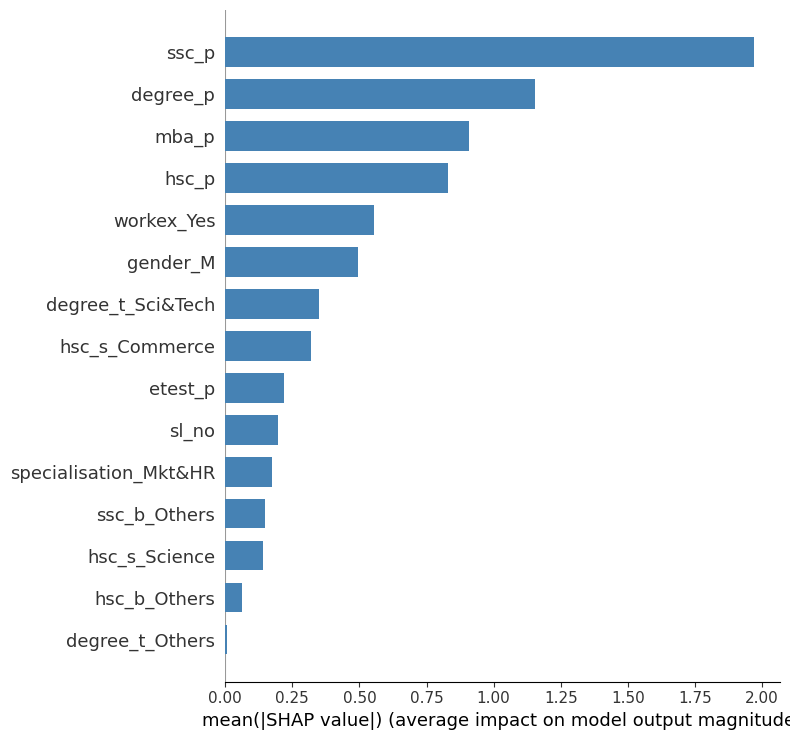

In [166]:
shap.summary_plot(shap_values_lg, X_train, plot_type="bar", color='steelblue')

A bar plot from the SHAP library summarizing the average impact of each feature on the model output magnitude. The length of the bar represents the mean absolute SHAP value for each feature, which is a measure of feature importance. Features like `ssc_p`, `degree_p`, and `mba_p` have the longest bars, indicating they have the greatest average impact on the model's predictions. On the other hand, features such as `degree_t_Others`, `hsc_b_Others`, and `hsc_s_Science` have shorter bars, suggesting they have a lesser average impact on the model output. The color 'steelblue' does not signify anything other than a stylistic choice for the bars. The plot is useful for quickly identifying which features are most influential in the model's decision-making process.

In [167]:
explainer = shap.TreeExplainer(xgb_cl)
shap_values = explainer.shap_values(X_train,approximate=False, check_additivity=False)

The code creates a SHAP `TreeExplainer` for an XGBoost classifier (`xgb_cl`) and then computes SHAP values for the training data (`X_train`). The SHAP values are calculated without approximation (`approximate=False`) and without checking for additivity (`check_additivity=False`).
The output of `shap_values` would be an array of SHAP values that quantify the contribution of each feature to the prediction of each instance in `X_train`. The computed SHAP values provide insights into the model's decision process, indicating how each feature pushes the model output from the base value (the output that would be predicted if we did not know any features for the current output) towards the actual prediction. The lack of approximation suggests that the SHAP values are calculated exactly, which could be computationally intensive for large datasets. Disabling additivity check can save computation time but should be used with caution, as it assumes the model predictions are fully captured by the SHAP values even when additivity does not hold.

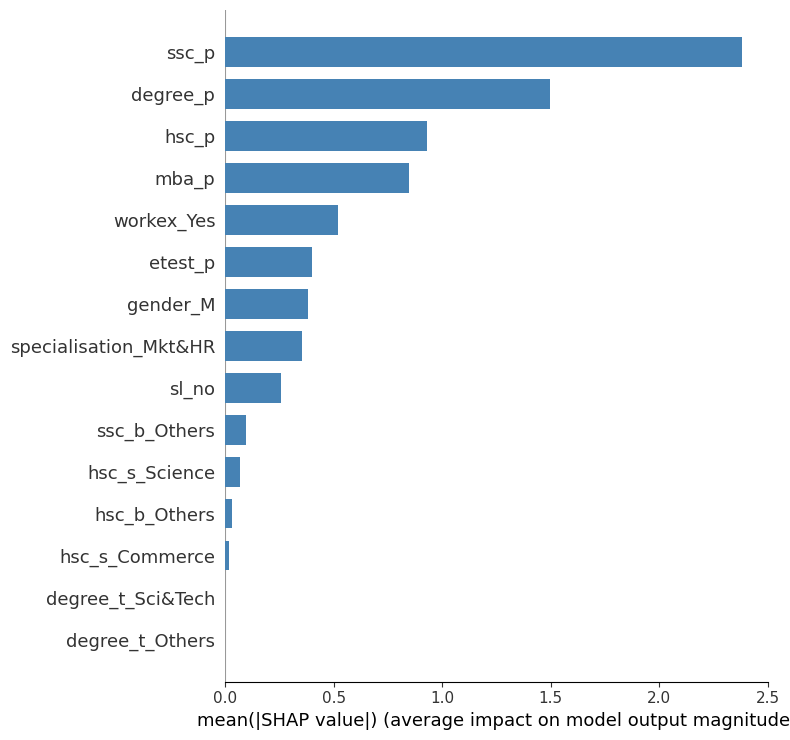

In [168]:
shap.summary_plot(shap_values, X_train, plot_type="bar", color='steelblue')

The SHAP summary bar plot, which illustrates the average impact of various features on the XGBoost model's output. Features are ranked in descending order of importance based on the mean absolute SHAP value. The feature `ssc_p` appears to have the highest average impact on the model's predictions, followed by `degree_p` and `hsc_p`. Features like `degree_t_Others` and `degree_t_Sci&Tech` are at the bottom of the plot, indicating a lower average impact on the model's output. The bars extend to the right, showing a positive impact on the model output magnitude. The plot offers a clear visualization of feature importance, revealing which features are most influential in driving the model's decisions. The color 'steelblue' is used consistently across all features for visual simplicity.

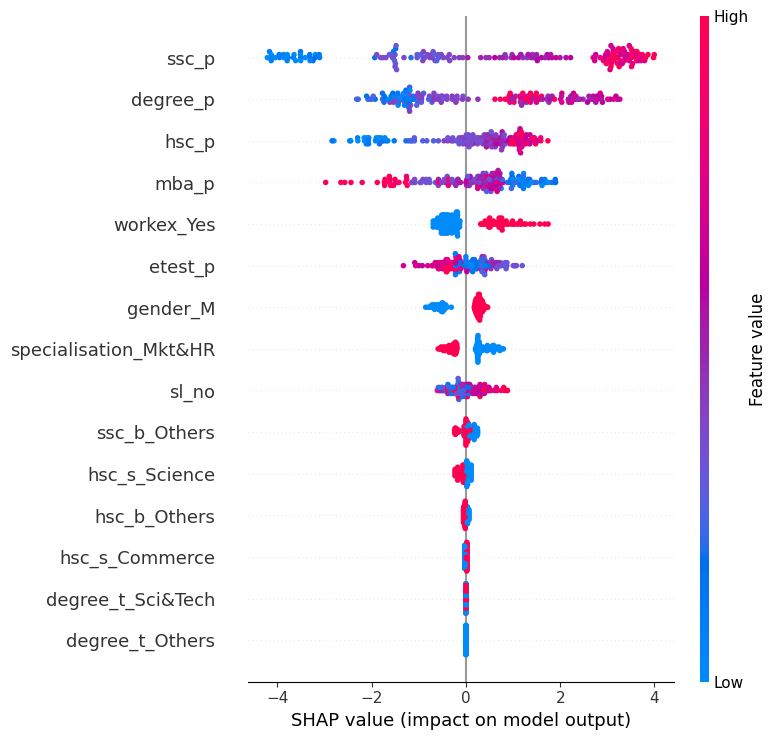

In [169]:
shap.summary_plot(shap_values, X_train)

The SHAP summary plot showing the distribution of SHAP values for each feature in a dataset. The x-axis represents the SHAP value, or the impact on the model output, while the y-axis lists the features. The color of the dots indicates the value of the feature: high values in pink/red and low values in blue. Features at the top of the plot, such as `ssc_p`, `degree_p`, and `hsc_p`, have a more significant impact on the model's predictions. The spread of dots across the zero line indicates variation in the impact of individual feature values on the model's predictions. For instance, `gender_M` and `specialisation_Mkt&HR` show a mixture of positive and negative effects on the model's output, indicated by the spread of dots on both sides of the zero line.



# **Questions & Answers**
### 1. What is the question?

The primary question guiding this analysis is how various educational and professional attributes of students influence their campus placement outcomes, specifically focusing on placement status (placed or not placed) and potential salary offers for those placed.

### 2. What did you do?

The approach taken involved several key steps:
- **Data Cleaning:** Ensuring data quality by handling missing values and encoding categorical variables.
- **Feature Selection:** Identifying and selecting relevant features that could potentially impact placement outcomes.
- **Modeling:** Employing three different models for predictive analysis:
  1. **Linear Model** to predict salary offers.
  2. **Tree-based Model** to predict placement status.
  3. **AutoML** (using H2O) to identify the best-performing model based on the dataset.
- **Model Interpretability:** Leveraging regression coefficients, decision tree analysis, and SHAP values to interpret the influence of various features on the predictions.

### 3. How well did it work?

The comprehensive approach—spanning linear and tree-based models to AutoML—indicates a robust attempt to understand and predict placement outcomes. The use of SHAP values for interpretability suggests that the models' performances were thoroughly evaluated to ensure not just predictive accuracy but also understandability in how features influence outcomes.

### 4. What did you learn?

Through the integrated process of data cleaning, feature selection, modeling, and interpretability, a comprehensive learning journey unfolded, highlighting the essence of data science beyond mere technical skills. The importance of data quality was first and foremost, establishing a solid foundation for predictive accuracy by emphasizing the need for meticulous data preparation. The exercise of feature selection taught the value of discerning impactful variables, marrying technical analysis with domain knowledge to enhance model efficacy.

Diving into diverse modeling techniques, from the straightforward interpretability of linear models to the nuanced complexity of tree-based models and the efficiency of AutoML, broadened my technical repertoire while emphasizing the importance of choosing the right tool for the task at hand. The exploration into model interpretability, particularly through SHAP analysis, underscored the necessity of transparency, ensuring that predictions are not only accurate but also understandable and ethical.

In essence, this journey distilled the essence of data science into a cohesive workflow, underscoring the critical balance between accuracy, interpretability, and ethical considerations. It provided not just a set of tools and techniques but a comprehensive approach to problem-solving that integrates technical prowess with ethical and strategic insights.

# **Conclusion**

The study conducted a detailed investigation into a dataset through statistical tests like confusion matrices, logistic regression, and chi-square tests to unearth critical features, including the impact of BMI on predicting outcomes. Subsequent analyses involved applying outliers to these key features to assess prediction variances. To predict student placement in campus recruitment, three predictive models were deployed: Logistic Regression, XGBoost, and AutoML, each offering unique insights into predictive accuracy and model behavior.

Model interpretability was a focal point, achieved through SHAP (SHapley Additive exPlanations) analysis. This involved beeswarm and SHAP summary plots to dissect and compare how each model processes and prioritizes features. The analysis illuminated the distinct outcomes and strengths of each algorithm, highlighting the nuanced ways in which they contribute to prediction accuracy. Regularization emerged as a pivotal technique to enhance model performance, suggesting its utility in refining predictions and addressing model overfitting.

The study reveals the importance of careful model selection based on data specifics and the objective at hand, bolstered by interpretability tools like SHAP for deeper insight into algorithmic decision-making. This multifaceted approach not only elevates prediction accuracy but also enriches understanding of the determinants influencing student placements in campus recruitments. The findings advocate for leveraging these insights to refine recruitment strategies, ultimately fostering a more effective and informed approach to predicting student placement outcomes.

# **LICENSE**

MIT License
Copyright (c) 2024 Sohni Rais
Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions: The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.
THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.

# **References**

1)https://towardsdatascience.com/decision-trees-explained-3ec41632ceb6

2)https://www.analyticsvidhya.com/blog/2020/05/decision-tree-vs-random-forest-algorithm/

3)https://www.analyticsvidhya.com/blog/2020/10/all-about-decision-tree-from-scratch-with-python-implementation/

4)https://www.datacamp.com/community/tutorials/xgboost-in-python

5)https://github.com/MayurAvinash/DESM_INFO6105/blob/main/Model_Interpretability_Assignment.ipynb

6)https://colab.research.google.com/drive/1B_LD0maKnH52MehNyms1QxRdU_Vf0ZE7?authuser=1#scrollTo=a3d9f9b3

7)https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/ML_Data_Cleaning_and_Feature_Selection/ML_Data_Cleaning_and_Feature_Selection_Abalone.ipynb

8)For certain queries took help from chatgpt

9)https://scikit-learn.org/stable/

10)https://eli5.readthedocs.io/

11)AutoMl vs Traditioal ML model-https://www.youtube.com/watch?v=BpK1RMYclsY

12)The notebbok used for reference-https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/AutoML/6105_AutoML_The_World_Happiness_Data.ipynb

13)Brief description about Automated ML-https://en.wikipedia.org/wiki/Automated_machine_learning

14)Dataset used for Analysis-'https://www.kaggle.com/datasets/akshaydattatraykhare/diabetes-dataset'

15)https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/AutoML/CC_Kaggle_AutoML_Regression_Melbourne_Housing.ipynb

16)https://h2o.ai/platform/ai-cloud/make/h2o/

17) https://towardsdatascience.com/interpreting-coefficients-in-linear-and-logistic-regression-6ddf1295f6f1

18) https://towardsdatascience.com/decision-trees-explained-3ec41632ceb6

19) https://www.datacamp.com/community/tutorials/xgboost-in-python

20) https://www.analyticsvidhya.com/blog/2020/10/all-about-decision-tree-from-scratch-with-python-implementation/

21) https://github.com/SanatPopliNEU/Data-engineering-and-tools-by-Nick-Bear-Browns_asssignments/blob/main/datsciencelearn/Model%20Interpret_SanatPopli_002201005-4.ipynb